# <center> Co2 Capture <br> <br>    <font size='4'>$\color{purple}{\text{Mahmoud Maheri}}$



  <font size='4'>
Outline:<br>
- Summary about file<br>
- Importing libraies and dataset<br> 
- General information from dataset<br>
- Cleanning dataset<br>
- features selection<br>
- Checking three set of dataset(oroginal, modified and after feature selection<br>
- Effect of models and scalers on datasets<br>
- Choosing GBR method with minmax scaler<br>
- Compersion original and feture selection dataset using some models and attributes<br>
- Showing results.<br>
- Applying ANN on two datasets



# Importing libreries


In [1]:
import warnings
import matplotlib
import tensorflow
import numpy as np
import pandas as pd 
import seaborn as sns
from math import sqrt
from scipy import interp
from sklearn import metrics
from tensorflow import keras
from tabulate import tabulate
import matplotlib.pyplot as plt
from scipy.stats import skewnorm
import plotly.graph_objects as go

from subprocess import check_output
import matplotlib.patches as patches
from sklearn.metrics import f1_score
from sklearn.model_selection import KFold
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import Normalizer
from tensorflow.keras.optimizers import Adam

from sklearn.datasets import make_hastie_10_2
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import RobustScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.inspection import partial_dependence
from matplotlib.font_manager import FontProperties
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance
from sklearn.model_selection import cross_val_predict
from sklearn.preprocessing import QuantileTransformer
from sklearn.inspection import plot_partial_dependence
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score
from IPython.core.interactiveshell import InteractiveShell  
from sklearn.model_selection import RepeatedKFold, cross_validate
import plotly.express as px
from statistics import median
import statistics
warnings.filterwarnings("ignore")
InteractiveShell.ast_node_interactivity = "all"
pd.options.display.float_format = "{:.4f}".format
#InteractiveShell.ast_node_interactivity = "last_expr"
np.set_printoptions(precision=6)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = (6, 4)
plt.rcParams['image.interpolation'] = 'spline16'

from random import random,randint,seed
from numpy import arange,mean,std,absolute
from sklearn.datasets import make_regression
from sklearn.linear_model import HuberRegressor
from sklearn.utils import shuffle
from relativeImp import relativeImp
from sklearn import datasets, linear_model
import statsmodels.api as sm
from scipy import stats
from tensorflow.keras.layers import Conv1D, Dense, Flatten
from tensorflow.keras.models import Sequential
import tensorflow as tf


from tensorflow.keras.optimizers import Adam

import random
import missingno as msno
from scipy.stats import pearsonr
from sklearn.inspection import PartialDependenceDisplay
import shap
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import learning_curve
from keras_sequential_ascii import keras2ascii
import graphviz
from sklearn.linear_model import SGDClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.feature_selection import RFECV
import os
#os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import texttable
import latextable
from texttable import Texttable
from pandas.plotting import scatter_matrix
from sklearn.metrics import make_scorer
import smogn

from sklearn.pipeline import Pipeline
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense
#from tensorflow.python.keras.wrappers.scikit_learn import KerasRegressor
import keras_tuner as kt
from tensorflow.keras import models
from scikeras.wrappers import KerasRegressor
from sklearn.metrics import r2_score

# print(scores)
# print(r2_score(y_train, train_preds))
# print(r2_score(y_test, test_preds))
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'


2023-08-29 09:39:23.615905: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


# Importing Dataset

In [2]:
#Reading data 
df = pd.read_excel("Processed 527 datapoints.xlsx")
df_0=df.copy()
df_0f=df.copy()
df_0m=df.copy()


In [3]:
# info from of datasets
print(' shape of data set is = ',df.shape)
print()
print(' shape of data set is = ',df_0.shape)
print()
print(' shape of data set is = ',df_0f.shape)
print()
print(' dataset head:\n')
df.head()
print()
print(' dataset info:\n')
dfinfo=df.info()
print()
print(' describtion of data set:\n')
df_des=df.describe().transpose()
df_des
df_firstf=df_0f[:193]
df_firstf.describe().transpose()
df_secondf=df_0f[193:]

df_secondf.describe().transpose()


 shape of data set is =  (527, 11)

 shape of data set is =  (527, 11)

 shape of data set is =  (527, 11)

 dataset head:



,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386
4,841.3000,0.3600,NaN,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300



 dataset info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 527 entries, 0 to 526
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Surface Area (m2/g)       527 non-null    float64
 1   Total Pore Volume(cm3/g)  499 non-null    float64
 2   Micropore Volume (cm3/g)  317 non-null    float64
 3   C (%)                     527 non-null    float64
 4   H (%)                     527 non-null    float64
 5   N (%)                     527 non-null    float64
 6   O (%)                     527 non-null    float64
 7   S (%)                     527 non-null    float64
 8   Temp (°C)                 527 non-null    int64  
 9   Pressure (bar)            527 non-null    float64
 10  CO2 uptake (mmol/g)       527 non-null    float64
dtypes: float64(10), int64(1)
memory usage: 45.4 KB

 describtion of data set:



,count,mean,std,min,25%,50%,75%,max
Surface Area (m2/g),527.0000,1488.1502,728.6116,2.4800,955.5000,1420.0000,1960.0000,3337.0000
Total Pore Volume(cm3/g),499.0000,0.8000,0.4482,0.0200,0.4800,0.6900,1.0300,3.0900
Micropore Volume (cm3/g),317.0000,0.5168,0.2727,0.0400,0.3100,0.4800,0.6900,1.2900
C (%),527.0000,76.3227,12.5913,40.4000,69.8300,79.1000,85.3300,96.9600
H (%),527.0000,1.6841,1.5856,0.0000,0.0000,1.5000,2.4100,6.0100
N (%),527.0000,3.2625,3.7123,0.0000,0.7150,2.1600,4.4500,38.1500
O (%),527.0000,18.1733,11.6321,0.0000,9.9200,15.4300,22.9100,54.0000
S (%),527.0000,0.1254,0.9308,0.0000,0.0000,0.0000,0.0000,13.2000
Temp (°C),527.0000,18.4630,11.0094,0.0000,0.0000,25.0000,25.0000,30.0000
Pressure (bar),527.0000,0.8666,0.3112,0.1000,1.0000,1.0000,1.0000,1.0132


,count,mean,std,min,25%,50%,75%,max
Surface Area (m2/g),193.0000,1426.6178,735.4950,2.4800,841.3000,1403.9000,1893.0000,3337.0000
Total Pore Volume(cm3/g),177.0000,0.7730,0.4416,0.1100,0.4400,0.6700,0.9800,2.0500
Micropore Volume (cm3/g),169.0000,0.5068,0.2407,0.0900,0.3500,0.4800,0.6600,1.2900
C (%),193.0000,76.8187,15.1766,47.1000,69.2200,82.6600,88.8000,96.9600
H (%),193.0000,2.0052,1.9479,0.0000,0.0100,1.5200,2.9400,5.9500
N (%),193.0000,1.2354,3.5768,0.0000,0.0800,0.6600,1.3200,38.1500
O (%),193.0000,19.1162,14.0487,0.0000,8.0700,15.0500,26.1400,46.3900
S (%),193.0000,0.0950,0.1918,0.0000,0.0000,0.0000,0.0600,0.5600
Temp (°C),193.0000,16.4508,11.8901,0.0000,0.0000,25.0000,25.0000,25.0000
Pressure (bar),193.0000,0.7634,0.3856,0.1000,0.1500,1.0000,1.0000,1.0132


,count,mean,std,min,25%,50%,75%,max
Surface Area (m2/g),334.0000,1523.7063,723.3228,18.0000,1003.5000,1427.0500,1993.2500,3247.0000
Total Pore Volume(cm3/g),322.0000,0.8149,0.4517,0.0200,0.4800,0.6900,1.0300,3.0900
Micropore Volume (cm3/g),148.0000,0.5283,0.3057,0.0400,0.3100,0.4400,0.7300,1.2200
C (%),334.0000,76.0361,10.8351,40.4000,70.0400,77.9750,84.2300,93.2400
H (%),334.0000,1.4985,1.2997,0.0000,0.0000,1.4800,2.3300,6.0100
N (%),334.0000,4.4339,3.2610,0.0000,1.9575,3.5850,6.4300,15.8800
O (%),334.0000,17.6285,9.9557,0.0000,10.8800,15.6500,22.4600,54.0000
S (%),334.0000,0.1429,1.1604,0.0000,0.0000,0.0000,0.0000,13.2000
Temp (°C),334.0000,19.6257,10.3073,0.0000,25.0000,25.0000,25.0000,30.0000
Pressure (bar),334.0000,0.9263,0.2397,0.1500,1.0000,1.0000,1.0000,1.0132


# Distribution and analysing dataset

<Figure size 1200x800 with 0 Axes>

array([[<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>]], dtype=object)

<Figure size 1200x800 with 0 Axes>

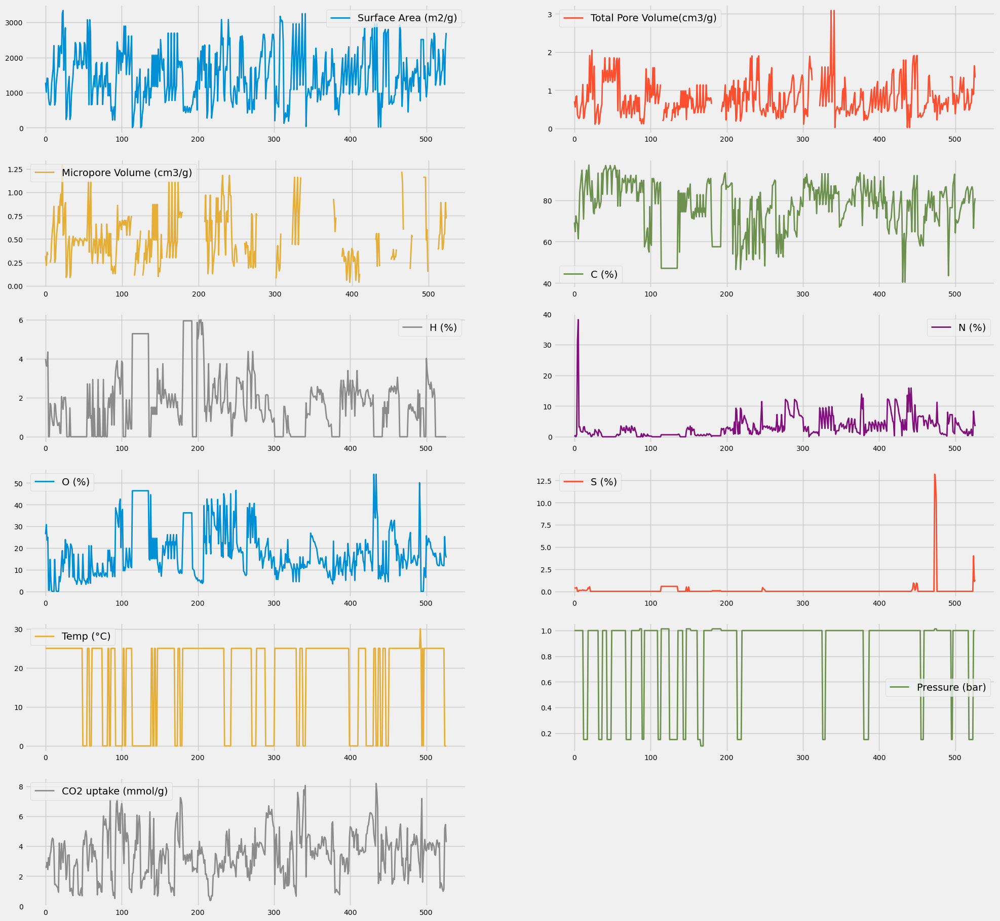

In [4]:
# Visualization of the primary dataset
plt.figure(dpi=200)
plt.style.use('fivethirtyeight')
df_0f.plot(subplots=True,
        layout=(6, 2),
        figsize=(22,22),
        fontsize=10, 
        linewidth=2,
        sharex=False)
plt.show()

<Figure size 1200x800 with 0 Axes>

array([[<AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
        <AxesSubplot:ylabel='Density'>],
       [<AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
        <AxesSubplot:ylabel='Density'>],
       [<AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
        <AxesSubplot:ylabel='Density'>],
       [<AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
        <AxesSubplot:ylabel='Density'>]], dtype=object)

<Figure size 1200x800 with 0 Axes>

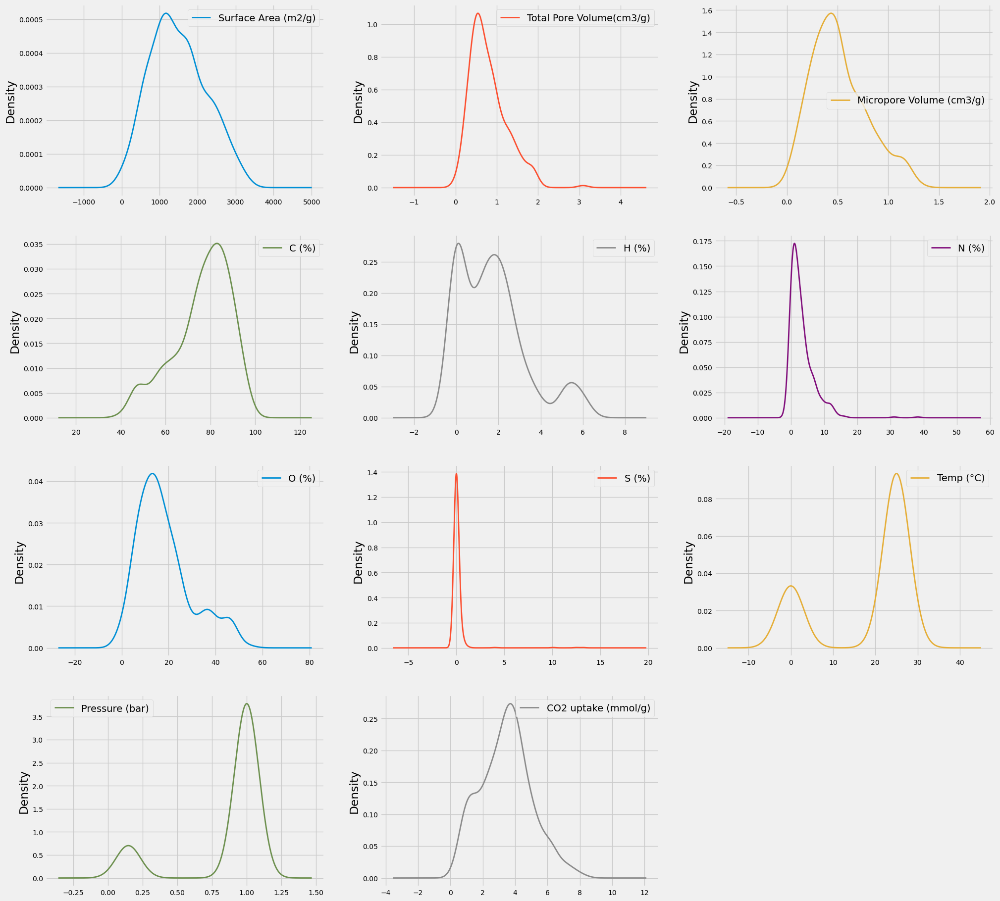

In [5]:
#disribution of the primary dataset
plt.figure(dpi=200)
df_0f.plot(kind='density',subplots=True,layout=(4, 3), figsize=(22,22),
           fontsize=10, linewidth=2, sharex=False);
plt.show()


In [6]:
#CO2 uptake by box plot for the primary dataset

fig = px.box(df_0f, y="CO2 uptake (mmol/g)")
fig.show()


<AxesSubplot:xlabel='CO2 uptake (mmol/g)'>

[Text(0.5, 0, '')]

<AxesSubplot:xlabel='CO2 uptake (mmol/g)', ylabel='Density'>

Text(5, 0.3, 'Mean= 2.96')

Text(5, 0.2, 'Median= 3.21')

[Text(0.5, 0, '')]

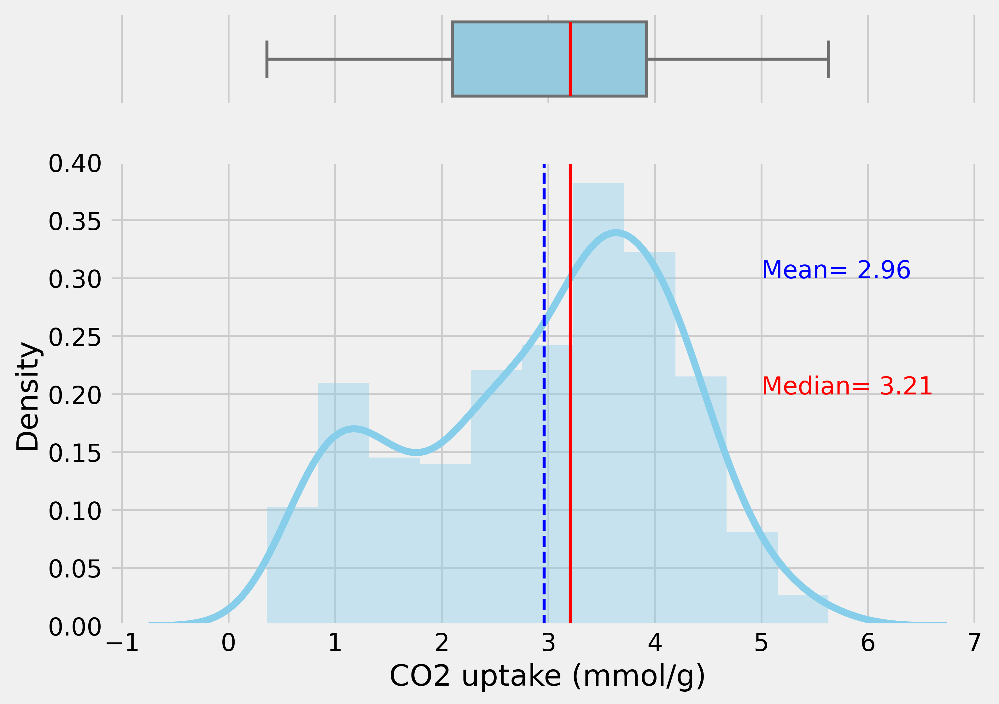

In [7]:
#Realation between co2 uptake and temerature
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw= {"height_ratios": (0.2, 1)},
                                    figsize=(8, 6), dpi = 400)

sns.boxplot(df_0f["CO2 uptake (mmol/g)"][df_0f["Temp (°C)"] == 25], ax=ax_box , color='skyblue',linewidth=1.7
            ,medianprops = dict(color="red",linewidth=1.7))

ax_box.set(xlabel='')
sns.distplot(df_0f["CO2 uptake (mmol/g)"][df_0f["Temp (°C)"] == 25], ax=ax_hist, color='skyblue')

plt.axvline(df_0f["CO2 uptake (mmol/g)"][df_0f["Temp (°C)"] == 25].median(), color = 'red',linewidth=1.7)
plt.axvline(df_0f["CO2 uptake (mmol/g)"][df_0f["Temp (°C)"] == 25].mean(), color = "blue",
            linestyle='--',linewidth=1.7)

plt.text(5, .3,'Mean= %.2f'%df_0f["CO2 uptake (mmol/g)"][df_0f["Temp (°C)"] == 25].mean(), color='blue')
plt.text(5, .2,'Median= %.2f'%df_0f["CO2 uptake (mmol/g)"][df_0f["Temp (°C)"] == 25].median(), color='r')

ax_box.set(xlabel='')
plt.show()

In [8]:
df_first1=df_0f[:193]
df_first2=df_0f[193:]

In [9]:
# df_0f["CO2 uptake (mmol/g)"]

def density_features_manual(dataset, feature_name):
    '''you can use for any dataset conidering its columns
    here aim is to apply for three df_0f, df_first1 and df_first2 dataset '''
    print(dataset.columns)
    sns.set(style="darkgrid")

    # Define the figure and axis
    f, ax_hist = plt.subplots(figsize=(8, 6), dpi=400)

    # Plot the histogram
    sns.distplot(dataset[feature_name], ax=ax_hist, color='skyblue')

    # Plot vertical lines for mean and median
    plt.axvline(dataset[feature_name].median(), color = 'red', linewidth=1.7)
    plt.axvline(dataset[feature_name].mean(), color = "blue", linestyle='--', linewidth=1.7)

    # Add text labels for mean and median
    plt.text(6, .30, 'Mean   = %.2f' % dataset[feature_name].mean(), color='blue')
    plt.text(6, .25, 'Median= %.2f' % dataset[feature_name].median(), color='red')

    plt.xlabel(feature_name, fontsize=18)
    plt.ylabel('Density', fontsize=18)
    plt.show()

In [10]:
def density_features(dataset, feature_name='Surface Area (m2/g)'):
    '''you can use for any dataset considering its columns
    here aim is to apply for three df_0f, df_first1 and df_first2 dataset '''
    print(dataset.columns)
    sns.set(style="darkgrid")

    # Define the figure and axis
    f, ax_hist = plt.subplots(figsize=(8, 6), dpi=400)

    # Plot the histogram
    sns.distplot(dataset[feature_name], ax=ax_hist, color='skyblue')

    # Plot vertical lines for mean and median
    mean_value = dataset[feature_name].mean()
    median_value = dataset[feature_name].median()
    plt.axvline(median_value, color='red', linewidth=1.7)
    plt.axvline(mean_value, color="blue", linestyle='--', linewidth=1.7)

    # Add text labels for mean and median
    plt.text(mean_value, ax_hist.get_ylim()[1] * 0.9, 'Mean   = %.2f' % mean_value, color='blue', ha='center')
    plt.text(median_value, ax_hist.get_ylim()[1] * 0.85, 'Median = %.2f' % median_value, color='red', ha='center')

    plt.xlabel(feature_name, fontsize=18)
    plt.ylabel('Density', fontsize=18)
    plt.show()


# Example usage


Index(['Surface Area (m2/g)', 'Total Pore Volume(cm3/g)',
       'Micropore Volume (cm3/g)', 'C (%)', 'H (%)', 'N (%)', 'O (%)', 'S (%)',
       'Temp (°C)', 'Pressure (bar)', 'CO2 uptake (mmol/g)'],
      dtype='object')


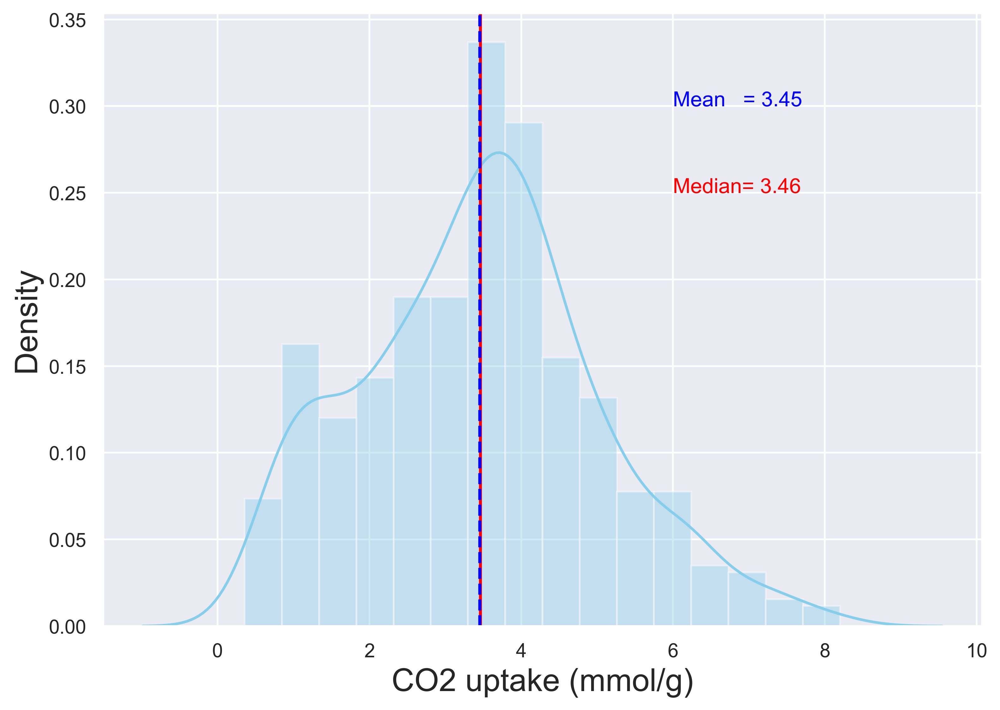

In [11]:
density_features_manual(df_0f, 'CO2 uptake (mmol/g)') 


Index(['Surface Area (m2/g)', 'Total Pore Volume(cm3/g)',
       'Micropore Volume (cm3/g)', 'C (%)', 'H (%)', 'N (%)', 'O (%)', 'S (%)',
       'Temp (°C)', 'Pressure (bar)', 'CO2 uptake (mmol/g)'],
      dtype='object')


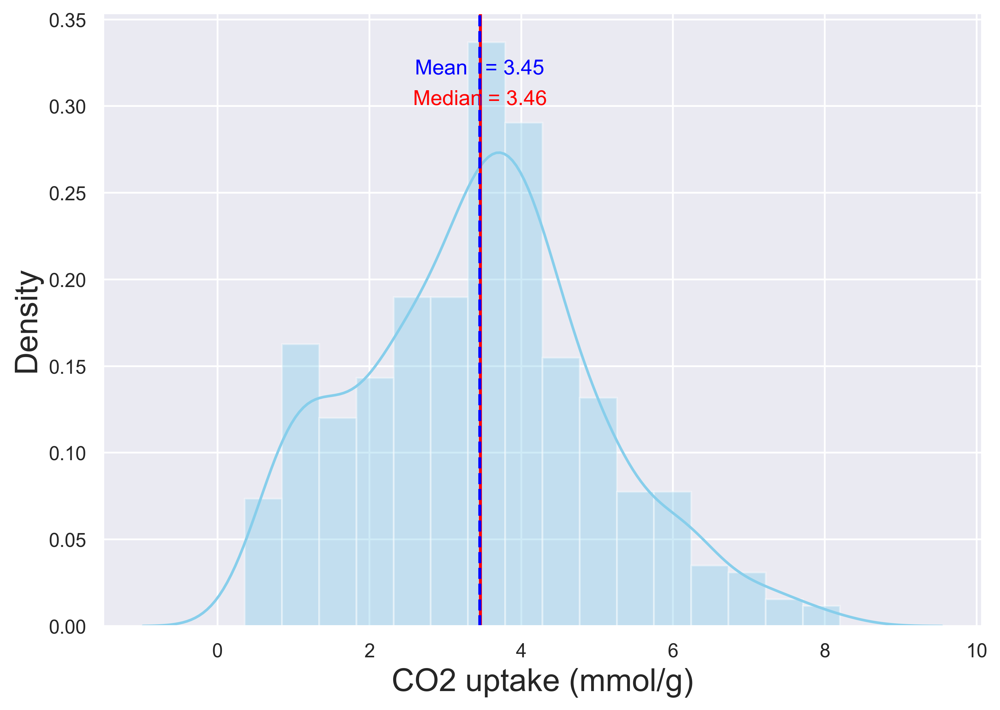

In [12]:
density_features(df_0f, 'CO2 uptake (mmol/g)') 


In [13]:
fig = px.violin(df_0, y="CO2 uptake (mmol/g)", x="Temp (°C)",
                color=df_0f["Temp (°C)"] , box=True, points="all", hover_data=['CO2 uptake (mmol/g)'])
fig.show()

In [14]:
fig = px.violin(df_0, y="CO2 uptake (mmol/g)", x="Pressure (bar)", 
                color=df_0f["Pressure (bar)"] , box=True, points="all", hover_data=['CO2 uptake (mmol/g)'])
fig.show()

In [15]:
#effect of adsorption in different presures
df_first1=df_0f[:193]
df_first2=df_0f[193:]

fig = go.Figure()

presures = [0.1, 0.15, 1.0, 1.013]

for pres in presures:
    fig.add_trace(go.Violin(x=df_0f['Pressure (bar)'][df_0f['Pressure (bar)'] == pres],
                            y=df_0f['CO2 uptake (mmol/g)'][df_0f['Pressure (bar)'] == pres],
                            name=pres, box_visible=True, meanline_visible=True))

fig.show()

## relative importance of features

In [16]:
#relative importance of features

yName = 'CO2 uptake (mmol/g)'
xNames = ['Surface Area (m2/g)', 'Total Pore Volume(cm3/g)',
       'Micropore Volume (cm3/g)', 'C (%)', 'H (%)', 'N (%)', 'O (%)', 'S (%)',
       'Temp (°C)', 'Pressure (bar)']

df_results = relativeImp(df_0f, outcomeName = yName, driverNames = xNames)
df_results=df_results.sort_values('normRelaImpt',ascending=False)
df_results

,driver,rawRelaImpt,normRelaImpt
9,Pressure (bar),0.3328,47.4860
8,Temp (°C),0.2492,35.5618
0,Surface Area (m2/g),0.0461,6.5840
2,Micropore Volume (cm3/g),0.0253,3.6093
1,Total Pore Volume(cm3/g),0.0229,3.2666
5,N (%),0.0129,1.8361
3,C (%),0.0047,0.6752
6,O (%),0.0045,0.6383
4,H (%),0.0020,0.2908
7,S (%),0.0004,0.0518


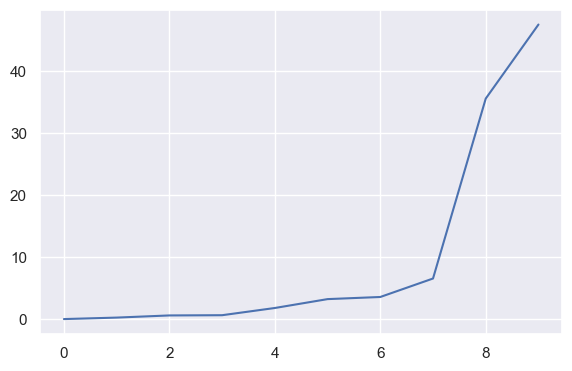

In [17]:
#plt.plot(df_results['normRelaImpt'])
plt.plot(sorted(df_results['normRelaImpt']))

# initial data processing of primary dataset

This part includes enhancements to the Yuan and colleagues's paper, as well as novel algorithms intended to further refine and advance the outcomes.

In [18]:
def missing_values(dataset):
    missing = dataset.columns[dataset.isnull().any()].tolist()
    return missing
def print_missing_values(dataset):
    missing_values(dataset)
    print('missing values based on attibutes are in columns:\n')
    dataset[missing_values(dataset)].isnull().sum()
    print()


In [19]:
# df_0 is the primary dataset
missing_values(df_0)

['Total Pore Volume(cm3/g)', 'Micropore Volume (cm3/g)']

In [20]:
def imputation(dataset, target):
    
    dataset_mv = dataset[["Surface Area (m2/g)", target]].copy()
    print(dataset_mv)

    dataset_mv = dataset_mv.dropna()
    print(dataset_mv)


    x = np.array(dataset_mv["Surface Area (m2/g)"]).reshape(-1,1)
    y = np.array(dataset_mv[target]).reshape(-1,1)

    x_train, x_test , y_train , y_test = train_test_split(x, y, test_size=0.2, random_state = 42)

    print("LR:")
    lr = LinearRegression()
    lr.fit(x_train, y_train)
    pred = lr.predict(x_test)
    scores = cross_val_score(lr, x_train, y_train , cv=5, scoring='r2')
    score = np.mean(scores)
    print("Train R2: %.3f (+/- %.3f) \n" %(score, scores.std()))
    print("Test R2: %.3f\n" %(r2_score(y_test, pred)))

    print("RF: ")
    rf = RandomForestRegressor(random_state =42)
    rf.fit(x_train, y_train)
    pred = rf.predict(x_test)
    scores = cross_val_score(rf, x_train, y_train , cv=5, scoring='r2')
    score = np.mean(scores)
    print("Train R2: %.3f (+/- %.3f) \n" %(score, scores.std()))
    print("Test R2: %.3f\n" %(r2_score(y_test, pred)))


    print(len(x))

    print(x[:10])
    print(y[:10])
    name = target + "_imputed"
    p = rf.predict(np.array(dataset["Surface Area (m2/g)"]).reshape(-1,1))
    dataset[name] = p
    return dataset

In [21]:
df_0_poly=df_0.copy()

In [22]:
imputation(df_0, "Total Pore Volume(cm3/g)")
imputation(df_0, "Micropore Volume (cm3/g)")


     Surface Area (m2/g)  Total Pore Volume(cm3/g)
0              1281.6000                    0.7100
1              1012.6000                    0.5600
2              1408.8000                    0.8300
3              1403.9000                    0.8500
4               841.3000                    0.3600
..                   ...                       ...
522            2230.0000                    1.0300
523            1950.0000                    0.8800
524            1230.0000                    0.9000
525            2380.0000                    1.6400
526            2700.0000                    1.3300

[527 rows x 2 columns]
     Surface Area (m2/g)  Total Pore Volume(cm3/g)
0              1281.6000                    0.7100
1              1012.6000                    0.5600
2              1408.8000                    0.8300
3              1403.9000                    0.8500
4               841.3000                    0.3600
..                   ...                       ...
522    

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g),Total Pore Volume(cm3/g)_imputed
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250,0.5625
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864,0.5385
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205,0.6658
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386,0.8071
4,841.3000,0.3600,NaN,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300,0.4658
...,...,...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800,1.0531
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400,0.9402
524,1230.0000,0.9000,NaN,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400,0.8453
525,2380.0000,1.6400,NaN,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500,1.4435


     Surface Area (m2/g)  Micropore Volume (cm3/g)
0              1281.6000                    0.3200
1              1012.6000                    0.2200
2              1408.8000                    0.3600
3              1403.9000                    0.3300
4               841.3000                       NaN
..                   ...                       ...
522            2230.0000                    0.8900
523            1950.0000                    0.7200
524            1230.0000                       NaN
525            2380.0000                       NaN
526            2700.0000                       NaN

[527 rows x 2 columns]
     Surface Area (m2/g)  Micropore Volume (cm3/g)
0              1281.6000                    0.3200
1              1012.6000                    0.2200
2              1408.8000                    0.3600
3              1403.9000                    0.3300
6               645.0000                    0.2500
..                   ...                       ...
519    

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g),Total Pore Volume(cm3/g)_imputed,Micropore Volume (cm3/g)_imputed
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250,0.5625,0.3804
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864,0.5385,0.2800
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205,0.6658,0.4069
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386,0.8071,0.4030
4,841.3000,0.3600,NaN,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300,0.4658,0.3049
...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800,1.0531,0.8467
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400,0.9402,0.6474
524,1230.0000,0.9000,NaN,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400,0.8453,0.2292
525,2380.0000,1.6400,NaN,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500,1.4435,0.6988


In [23]:
df_0["Total Pore Volume(cm3/g)"] = df_0["Total Pore Volume(cm3/g)"].fillna(df_0["Total Pore Volume(cm3/g)_imputed"])
df_0["Micropore Volume (cm3/g)"] = df_0["Micropore Volume (cm3/g)"].fillna(df_0["Micropore Volume (cm3/g)_imputed"])


In [24]:
df_0s = df_0.drop(['Total Pore Volume(cm3/g)_imputed','Micropore Volume (cm3/g)_imputed'], axis = 1)

In [25]:
df_0 = df_0s.drop(['S (%)'], axis = 1)

In [26]:
# df_0_poly is the dataset which missing values will be filled using Newton's three order interpolation method
df_0_poly

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386
4,841.3000,0.3600,NaN,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400
524,1230.0000,0.9000,NaN,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400
525,2380.0000,1.6400,NaN,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500


##
because of the high correlation between columns $\color{blue}{\text{ "Total Pore Volume(cm3/g)"}}$ and $\color{blue}{\text{ "Micropore Volume (cm3/g)"}}$ to column $\color{blue}{\text{ "Surface Area (m2/g)"}}$, Yuan and colleagues used to fill none values of mentioned columns.

We applied some other methods to imrove the results such as Newton third oreder interpolation

In [27]:
def _poly_newton_coefficient(x, y):
    
    m = len(x)

    x = np.copy(x)
    a = np.copy(y)
    for k in range(1, m):
        a[k:m] = (a[k:m] - a[k - 1])/(x[k:m] - x[k - 1])

    return a

def newton_polynomial(x_data, y_data, x):
    
    a = _poly_newton_coefficient(x_data, y_data)
    n = len(x_data) - 1  # Degree of polynomial
    p = a[n]

    for k in range(1, n + 1):
        p = a[n - k] + (x - x_data[n - k])*p

    return p

In [28]:

def poly_imputation(dataset, target):
    
    dataset_mv = dataset[["Surface Area (m2/g)", target]].copy()

    
    x1 = np.array(dataset_mv["Surface Area (m2/g)"])#.reshape(-1,1)
    y1 = np.array(dataset_mv[target])#.reshape(-1,1)

    xx=x1
    yy=y1

    for i in range(len(y1)):

        if np.isnan(y1[i]):

            print(i)
            y1[i]
            x2=np.array([  xx[i-4],  xx[i-3],xx[i-2],xx[i-1]])
            print(x2)

            for j in range(len(x2)):
                if x2[j]==x2[j-1]:
                    x2[j]=x2[j]+0.001
            print(x2)

            y2=np.array([ yy[i-4],  yy[i-3],yy[i-2],yy[i-1]])
            print(y2)

            for j in range(len(y2)):
                if y2[j]==y2[j-1]:
                    y2[j]=y2[j]+0.001
            print(y2)

            x2,y2=zip( *sorted( zip(x2, y2) ) )

            x2=np.array(x2)
            y2=np.array(y2)
            a=_poly_newton_coefficient(x2, y2)

            if xx[i]<=x2[0]:
                x3=xx[i]+(x2[0]-xx[i])-10#(x2[0]-xx[i])/100
                
            elif x2[0]<xx[i]<x2[1] :
                x3=xx[i]+(-xx[i]+x2[1])-10
                
            elif x2[1]<xx[i]<x2[2] :
                x3=xx[i]+(-xx[i]+x2[2])-10
                
            elif x2[2]<xx[i]<x2[3] :
                x3=xx[i]+(-xx[i]+x2[3])-10
                
            else:
                x3=xx[i]-(xx[i]-x2[3])-10#(-x2[0]+xx[i])/100

            p=newton_polynomial(x2, y2,x3 )

            if p<0:
                p=p*(-1)

            print(x2,xx[i],x3)
            print(y2,p)
            y1[i]=p

    print(y1[:8])

    name = target + "_poly_imputed"
    p = y1   #rf.predict(np.array(dataset["Surface Area (m2/g)"]).reshape(-1,1))
    dataset[name] = p
    dataset[target] = p
    return dataset

In [29]:
poly_imputation(df_0_poly, 'Micropore Volume (cm3/g)')

4
[1281.6 1012.6 1408.8 1403.9]
[1281.6 1012.6 1408.8 1403.9]
[0.32 0.22 0.36 0.33]
[0.32 0.22 0.36 0.33]
[1012.6 1281.6 1403.9 1408.8] 841.3 1002.6
[0.22 0.32 0.33 0.36] 0.0779191002219688
5
[1012.6 1408.8 1403.9  841.3]
[1012.6 1408.8 1403.9  841.3]
[0.22     0.36     0.33     0.077919]
[0.22     0.36     0.33     0.077919]
[ 841.3 1012.6 1403.9 1408.8] 667.4 831.3
[0.077919 0.22     0.33     0.36    ] 0.03910503055089515
114
[1511. 1830. 2163. 2610.]
[1511. 1830. 2163. 2610.]
[0.54 0.67 0.74 0.74]
[0.54  0.67  0.74  0.741]
[1511. 1830. 2163. 2610.] 2.48 1501.0
[0.54  0.67  0.74  0.741] 0.5348577840377805
115
[1.830e+03 2.163e+03 2.610e+03 2.480e+00]
[1.830e+03 2.163e+03 2.610e+03 2.480e+00]
[0.67     0.74     0.74     0.534858]
[0.67     0.74     0.741    0.534858]
[2.480e+00 1.830e+03 2.163e+03 2.610e+03] 46.3 1820.0
[0.534858 0.67     0.74     0.741   ] 0.6673259706484618
125
[ 704. 1101. 1305. 1671.]
[ 704. 1101. 1305. 1671.]
[0.24 0.38 0.45 0.59]
[0.24 0.38 0.45 0.59]
[ 704. 110

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g),Micropore Volume (cm3/g)_poly_imputed
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250,0.3200
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864,0.2200
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205,0.3600
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386,0.3300
4,841.3000,0.3600,0.0779,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300,0.0779
...,...,...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800,0.8900
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400,0.7200
524,1230.0000,0.9000,0.5330,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400,0.5330
525,2380.0000,1.6400,0.8841,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500,0.8841


In [30]:
poly_imputation(df_0_poly,"Total Pore Volume(cm3/g)")

114
[1511. 1830. 2163. 2610.]
[1511. 1830. 2163. 2610.]
[0.65 0.78 0.93 1.15]
[0.65 0.78 0.93 1.15]
[1511. 1830. 2163. 2610.] 2.48 1501.0
[0.65 0.78 0.93 1.15] 0.6461658542055188
115
[1.830e+03 2.163e+03 2.610e+03 2.480e+00]
[1.830e+03 2.163e+03 2.610e+03 2.480e+00]
[0.78     0.93     1.15     0.646166]
[0.78     0.93     1.15     0.646166]
[2.480e+00 1.830e+03 2.163e+03 2.610e+03] 46.3 1820.0
[0.646166 0.78     0.93     1.15    ] 0.7758048097081293
125
[ 704. 1101. 1305. 1671.]
[ 704. 1101. 1305. 1671.]
[0.29 0.54 0.53 0.67]
[0.29 0.54 0.53 0.67]
[ 704. 1101. 1305. 1671.] 2.48 694.0
[0.29 0.54 0.53 0.67] 0.2742550842834144
126
[1101.   1305.   1671.      2.48]
[1101.   1305.   1671.      2.48]
[0.54     0.53     0.67     0.274255]
[0.54     0.53     0.67     0.274255]
[   2.48 1101.   1305.   1671.  ] 46.3 1091.0
[0.274255 0.54     0.53     0.67    ] 0.5413809990303102
181
[1713. 1893. 1871. 1486.]
[1713. 1893. 1871. 1486.]
[0.73 0.79 0.8  0.64]
[0.73 0.79 0.8  0.64]
[1486. 1713. 1871

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g),Micropore Volume (cm3/g)_poly_imputed,Total Pore Volume(cm3/g)_poly_imputed
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250,0.3200,0.7100
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864,0.2200,0.5600
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205,0.3600,0.8300
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386,0.3300,0.8500
4,841.3000,0.3600,0.0779,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300,0.0779,0.3600
...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800,0.8900,1.0300
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400,0.7200,0.8800
524,1230.0000,0.9000,0.5330,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400,0.5330,0.9000
525,2380.0000,1.6400,0.8841,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500,0.8841,1.6400


In [31]:
df_0_poly=df_0_poly.drop(['Total Pore Volume(cm3/g)_poly_imputed','Micropore Volume (cm3/g)_poly_imputed'],axis=1)
df_0_poly

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386
4,841.3000,0.3600,0.0779,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400
524,1230.0000,0.9000,0.5330,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400
525,2380.0000,1.6400,0.8841,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500


In [32]:
df_first=df_0[:193]
df_second=df_0[193:]

df_0_shuffled=df_0.sample(frac=1)
df_first_shuffled = df_first.sample(frac=1)
df_second_shuffled = df_second.sample(frac=1)

df_0s_shuffled=df_0s.sample(frac=1)

df_original= df_0
df_original_shuffled=df_original.sample(frac=1)

df_first_poly=df_0_poly[:193]
df_second_poly=df_0_poly[193:]

df_0_poly_shuffled=df_0_poly.sample(frac=1)
df_first_poly_shuffled = df_first_poly.sample(frac=1)
df_second_poly_shuffled = df_second_poly.sample(frac=1)



df_original= df_0
df_original_shuffled=df_original.sample(frac=1)


# Functions for traing datasets

## Machine learning function

In [33]:
def primary_code(dataset,n,size,case):
    
    case_name=['cross validation just x_train', 'cross validation with whole x']
    
    print(case_name[case],'\n')
    print('Dataset shape: ',dataset.shape)
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]


    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)

    
    matplotlib.rcParams['font.sans-serif'] = 'Times New Roman'
    label_size = 20
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size 


    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    
    scaler_Min =scalers[n]
    if n==0:
        x_train=x_train
        x_test=x_test
        x=x
    else:
        x_train = scaler_Min.fit_transform(x_train)
        x_test = scaler_Min.fit_transform(x_test)
        x = scaler_Min.fit_transform(x)
    
    

    model =  GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1, min_samples_split = 2, 
                                       n_estimators = 300, subsample = 0.5, random_state=42)

    model.fit(x_train, y_train)

    model_score = model.score(x_train,y_train)
    print("The training R2 is: %.3f" % (model.score(x_train, y_train)*100))
    print("The test R2 is: %.3f "% (model.score(x_test, y_test)*100))

    

    y_predicted = model.predict(x_test)

    print("MSE: %.3f"% mean_squared_error(y_test, y_predicted))
    print("RMSE: %.3f"% sqrt(mean_squared_error(y_test, y_predicted)))
    
    if case==0:
        train_x=x_train
        train_y=y_train
        x=x
    else:
        train_x = x
        train_y = y

    accuracies = cross_val_score(estimator = model, X = train_x, y=train_y, cv=5)
    scoring = ['precision_macro', 'recall_macro','r2']
    scores = cross_validate( model, X=x, y=y, scoring='r2')

    sorted(scores.keys())

    
    
    print("The mean training accuracy is: %.3f"% (accuracies.mean()*100))
    print("The standard daviation training accuracy is: %.3f"% (accuracies.std()*100))
    print("fit times: ", scores['fit_time'])


    pp_tr = model.predict(x_train)

    
    g1 = sns.JointGrid(data=x_test, x=y_test, y=y_predicted)
    
    sns.scatterplot(data=x_train,x=y_train, y=pp_tr, s=100, color='orange', ax=g1.ax_joint)
    sns.scatterplot(data=x_test,x=y_test, y=y_predicted, s=100, color='blue', ax=g1.ax_joint)
   
    sns.regplot(data=x_test,x=y_test, y=y_predicted, ax=g1.ax_joint)
    sns.regplot(data=x_train,x=y_train, y=pp_tr, ax=g1.ax_joint)

    plt.ylim(0, 8.5)
    plt.xlim(0, 8.5)

    g1.set_axis_labels("Actual CO\u2082 adsorbed (mmol/g)", "Predicted CO\u2082 adsorbed (mmol/g)", fontsize =14, fontname = 'Times New Roman')
    sns.histplot(data=x_train,x=y_train,ax=g1.ax_marg_x, color ='orange')
    sns.histplot(data=x_test,x=y_test, ax=g1.ax_marg_x, color ='blue')
    g1.ax_marg_x.legend(["Train", "Test"])

    plt.show()
    names = dataset.columns[0:len(dataset)]

    perm_importance = permutation_importance(model, x_train, y_train)

    sorted_idx = perm_importance.importances_mean.argsort()
    plt.barh(names[sorted_idx], perm_importance.importances_mean[sorted_idx])
    plt.xlabel("Permutation Importance")

   
    font = FontProperties()
    font.set_family('serif')
    font.set_name('Times New Roman')
    
    
    feature_name='O (%)'
    fig, ax = plt.subplots(figsize=(8, 6), dpi=300, facecolor='#FFFFFF')
    plot_partial_dependence(model, x_train,[feature_name],feature_names = names,
                            target = 0, n_jobs = 3, grid_resolution = 50,ax=ax)
        
    ax = plt.gca()
    ax.set_facecolor('#FFFFFF')
    plt.xlabel(f'{feature_name}', color='black', fontsize =18)
    plt.ylabel('Partial dependence', color='black', fontsize =18)
    plt.tick_params(axis='x', labelsize=22, colors='black')
    plt.tick_params(axis='y', labelsize=22, colors='black')
    plt.grid(True, color='lightgray')
    for line in ax.get_lines():
        line.set_color('blue')
    plt.show()



In [34]:

def primary_code_s(dataset,n,size,case):
    '''primary_code_s function calculate the  CO2 uptake after shuffleing the primary dataset'''
    
    case_name=['cross validation just x_train', 'cross validation with whole x']
    
    print(case_name[case],'\n')
    print('Dataset shape: ',dataset.shape)
    dataset=shuffle(dataset)
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]


    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)

    
    matplotlib.rcParams['font.sans-serif'] = 'Times New Roman'
    label_size = 20
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size 


    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    
    scaler_Min =scalers[n]
    if n==0:
        x_train=x_train
        x_test=x_test
        x=x
    else:
        x_train = scaler_Min.fit_transform(x_train)
        x_test = scaler_Min.fit_transform(x_test)
        x = scaler_Min.fit_transform(x)
    
    

    model =  GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1, min_samples_split = 2, 
                                       n_estimators = 300, subsample = 0.5, random_state=42)

    model.fit(x_train, y_train)

    model_score = model.score(x_train,y_train)
    print("The training R2 is: %.3f" % (model.score(x_train, y_train)*100))
    print("The test R2 is: %.3f "% (model.score(x_test, y_test)*100))

    

    y_predicted = model.predict(x_test)

    print("MSE: %.3f"% mean_squared_error(y_test, y_predicted))
    print("RMSE: %.3f"% sqrt(mean_squared_error(y_test, y_predicted)))
    
    if case==0:
        train_x=x_train
        train_y=y_train
        x=x
    else:
        train_x = x
        train_y = y

    accuracies = cross_val_score(estimator = model, X = train_x, y=train_y, cv=5)
    scoring = ['precision_macro', 'recall_macro','r2']
    scores = cross_validate( model, X=x, y=y, scoring='r2')

    sorted(scores.keys())

    
    
    print("The mean training accuracy is: %.3f"% (accuracies.mean()*100))
    print("The standard daviation training accuracy is: %.3f"% (accuracies.std()*100))
    print("fit times: ", scores['fit_time'])


    pp_tr = model.predict(x_train)

    
    g1 = sns.JointGrid(data=x_test, x=y_test, y=y_predicted)
    
    sns.scatterplot(data=x_train,x=y_train, y=pp_tr, s=100, color='orange', ax=g1.ax_joint)
    sns.scatterplot(data=x_test,x=y_test, y=y_predicted, s=100, color='blue', ax=g1.ax_joint)
   
    sns.regplot(data=x_test,x=y_test, y=y_predicted, ax=g1.ax_joint)
    sns.regplot(data=x_train,x=y_train, y=pp_tr, ax=g1.ax_joint)

    plt.ylim(0, 8.5)
    plt.xlim(0, 8.5)

    g1.set_axis_labels("Actual CO\u2082 adsorbed (mmol/g)", "Predicted CO\u2082 adsorbed (mmol/g)", fontsize =14, fontname = 'Times New Roman')
    sns.histplot(data=x_train,x=y_train,ax=g1.ax_marg_x, color ='orange')
    sns.histplot(data=x_test,x=y_test, ax=g1.ax_marg_x, color ='blue')
    g1.ax_marg_x.legend(["Train", "Test"])

    plt.show()
    names = dataset.columns[0:len(dataset)]

    perm_importance = permutation_importance(model, x_train, y_train)

    sorted_idx = perm_importance.importances_mean.argsort()
    plt.barh(names[sorted_idx], perm_importance.importances_mean[sorted_idx])
    plt.xlabel("Permutation Importance")

   
    font = FontProperties()
    font.set_family('serif')
    font.set_name('Times New Roman')
    
    
    feature_name='O (%)'
    fig, ax = plt.subplots(figsize=(8, 6), dpi=300, facecolor='#FFFFFF')
    plot_partial_dependence(model, x_train,[feature_name],feature_names = names,
                            target = 0, n_jobs = 3, grid_resolution = 50,ax=ax)
    
    
    ax = plt.gca()
    ax.set_facecolor('#FFFFFF')
    #plt.plot(feature_values, pdp_values, color='red')
    plt.xlabel(f'{feature_name}', color='black', fontsize =18)
    plt.ylabel('Partial dependence', color='black', fontsize =18)
    plt.tick_params(axis='x', labelsize=22, colors='black')
    plt.tick_params(axis='y', labelsize=22, colors='black')
    plt.grid(True, color='lightgray')
    for line in ax.get_lines():
        line.set_color('red')
    plt.show()



In [35]:
def primary_code2(dataset,n,size,case):
    '''primary_code_2 function calculate the effect of different values of tempreture and pressure features on
     CO2 uptake after shuffleing '''
    case_name=['cross validation just x_train', 'cross validation with whole x']
    
    dataset=shuffle(dataset)
    print(case_name[case],'\n')
    print('Dataset shape: ',dataset.shape)
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)

    matplotlib.rcParams['font.sans-serif'] = 'Times New Roman'
    label_size = 20
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size 

    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    
    scaler_Min =scalers[n]
    if n==0:
        x_train=x_train
        x_test=x_test
        x=x
    else:
        x_train = scaler_Min.fit_transform(x_train)
        x_test = scaler_Min.fit_transform(x_test)
        x = scaler_Min.fit_transform(x)
    
    model =  GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1, min_samples_split = 2, 
                                       n_estimators = 300, subsample = 0.5, random_state=42)

    model.fit(x_train, y_train)

    model_score = model.score(x_train,y_train)
    print("The training R2 is: %.3f" % (model.score(x_train, y_train)*100))
    print("The test R2 is: %.3f "% (model.score(x_test, y_test)*100))

    y_predicted = model.predict(x_test)

    print("MSE: %.3f"% mean_squared_error(y_test, y_predicted))
    print("RMSE: %.3f"% sqrt(mean_squared_error(y_test, y_predicted)))
    
    if case==0:
        train_x=x_train
        train_y=y_train
        x=x
    else:
        train_x = x
        train_y = y

    accuracies = cross_val_score(estimator = model, X = train_x, y=train_y, cv=5)
    scoring = ['precision_macro', 'recall_macro','r2']
    scores = cross_validate( model, X=x, y=y, scoring='r2')

    sorted(scores.keys())

    print("The mean training accuracy is: %.3f"% (accuracies.mean()*100))
    print("The standard daviation training accuracy is: %.3f"% (accuracies.std()*100))
    print("fit times: ", scores['fit_time'])

    pp_tr = model.predict(x_train)

    g1 = sns.JointGrid(data=x_test, x=y_test, y=y_predicted)
    
    sns.scatterplot(data=x_train,x=y_train, y=pp_tr, s=100, color='orange', ax=g1.ax_joint)
    sns.scatterplot(data=x_test,x=y_test, y=y_predicted, s=100, color='blue', ax=g1.ax_joint)
   
    sns.regplot(data=x_test,x=y_test, y=y_predicted, ax=g1.ax_joint)
    sns.regplot(data=x_train,x=y_train, y=pp_tr, ax=g1.ax_joint)

    plt.ylim(0, 8.5)
    plt.xlim(0, 8.5)

    g1.set_axis_labels("Actual CO\u2082 adsorbed (mmol/g)", "Predicted CO\u2082 adsorbed (mmol/g)", fontsize =14, fontname = 'Times New Roman')
    sns.histplot(data=x_train,x=y_train,ax=g1.ax_marg_x, color ='orange')
    sns.histplot(data=x_test,x=y_test, ax=g1.ax_marg_x, color ='blue')
    g1.ax_marg_x.legend(["Train", "Test"])

    plt.show()
    names = dataset.columns[0:len(dataset)]

    perm_importance = permutation_importance(model, x_train, y_train)

    sorted_idx = perm_importance.importances_mean.argsort()
    plt.barh(names[sorted_idx], perm_importance.importances_mean[sorted_idx])
    plt.xlabel("Permutation Importance")

    font = FontProperties()
    font.set_family('serif')
    font.set_name('Times New Roman')
    
    featurename='Temp (°C)'#'Pressure (bar)'
        # Specific range for Temp (°C)
    feature_index = list(x_train.columns).index(featurename)
    temp_values = np.arange(0, 37, 2)

    # Manually compute partial dependence
    pd_values = []
    for value in temp_values:
        X_temp = x_train.copy()
        X_temp[featurename] = value
        preds = model.predict(X_temp)
        pd_values.append(np.mean(preds))

    # Plotting
    feature_name='Temp (°C)'#'Pressure (bar)'
    fig, ax = plt.subplots(figsize=(8, 6), dpi=300, facecolor='#FFFFFF')
    ax.plot(temp_values, pd_values, '-b', linewidth=2.5)#,color='red')

    ax = plt.gca()
    ax.set_facecolor('#FFFFFF')
    #plt.plot(feature_values, pdp_values, color='red')
    plt.xlabel(f'{feature_name}', color='black', fontsize =18)
    plt.ylabel('Partial dependence', color='black', fontsize =18)
    plt.tick_params(axis='x', labelsize=22, colors='black')
    plt.tick_params(axis='y', labelsize=22, colors='black')
    plt.grid(True, color='lightgray')
    for line in ax.get_lines():
        line.set_color('red')
    plt.show()


In [36]:
def primary_code_latex(data,n,k,size):
    '''primar_code_latext function calculate the performance for any given data set and return back results in
    latex table    '''
    x = data.drop("CO2 uptake (mmol/g)",axis=1)
    xx = data.drop("CO2 uptake (mmol/g)",axis=1)
    y = data["CO2 uptake (mmol/g)"]
    print('cross validation using whole dataset\n')
    print('Dataset shape: ',data.shape)
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)
    
    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    
    scaler_Min =scalers[n]
    if n==0:
        x_train=x_train
        x_test=x_test
        x=x
    else:
        x_train = scaler_Min.fit_transform(x_train)
        x_test = scaler_Min.fit_transform(x_test)
        x = scaler_Min.fit_transform(x)

    matplotlib.rcParams['font.sans-serif'] = 'Times New Roman'
    label_size = 20
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size 
    
  
    model =  GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1,
                                       min_samples_split = 2, n_estimators = 300, 
                                       subsample = 0.5, random_state=42)
    model.fit(x_train, y_train)

    model_score = model.score(x_train,y_train)
    
    print("The training R2 is: %.2f" % (model.score(x_train, y_train)*100))
    print("The test R2 is: %.2f "% (model.score(x_test, y_test)*100))

    
    acc_trai=model.score(x_train, y_train)*100
    acc_tes=model.score(x_test, y_test)*100
    
    
    y_predicted = model.predict(x_test)

    print("MSE: %.4f"% mean_squared_error(y_test, y_predicted))
    print("RMSE: %.4f"% sqrt(mean_squared_error(y_test, y_predicted)))
    mer=mean_squared_error(y_test, y_predicted)

    
    
    accuracies = cross_val_score(estimator = model, X = x, y=y, cv=k)
    accuracy=accuracies.mean()*100
    y_pred = cross_val_predict(estimator = model, X = x, y= y, cv=k)
    
    scoring = ['precision_macro', 'recall_macro','r2']
    scores = cross_validate( model, X=x, y=y, scoring='r2')
    
    print(sorted(scores.keys()))
    results4 = {'r2':[], 'coef':[]}
    print(results4['coef'])
    print(results4)
    print("The mean training accuracy is: %.3f"% (accuracies.mean()*100))
    print("The standard daviation training accuracy is: %.3f"% (accuracies.std()*100))
    print("fit times: ", scores['fit_time'])


    
    pp_tr = model.predict(x_train)
    plt.figure(figsize=(8,6),dpi=200)
    ###########################
    feature_importance = model.feature_importances_
    sorted_idx = np.argsort(feature_importance)
    pos = np.arange(sorted_idx.shape[0]) + .5
    fig = plt.figure(figsize=(8, 8))
    plt.barh(pos, feature_importance[sorted_idx], align='center')
    plt.yticks(pos, np.array(xx.columns)[sorted_idx], fontsize =18)
    plt.title('Feature Importance (MDI)')
    result = permutation_importance(model, x_test, y_test, n_repeats=10,
                                    random_state=42, n_jobs=2)
    sorted_idx = result.importances_mean.argsort()
    fig.tight_layout()
    plt.show()
    ###############################

    gg = sns.JointGrid(data=x_test,x=y_test, y=y_predicted)
    sns.scatterplot(data=x_train,x=y_train, y=pp_tr, s=100, color='red', ax=gg.ax_joint)
    sns.regplot(data=x_train,x=y_train, y=pp_tr, color='green', ax=gg.ax_joint)

    
    sns.scatterplot(data=x_test,x=y_test, y=y_predicted, s=100, color='blue', ax=gg.ax_joint)
    sns.regplot(data=x_test,x=y_test, y=y_predicted, color='purple',ax=gg.ax_joint)
    #sns.lineplot(x=y_test, y=y_predicted, ax=g.ax_joint)
    plt.ylim(0, 7.5)
    plt.xlim(0, 7.5)

    gg.set_axis_labels("Actual CO2 uptake (mmol/g)",
                      "Predicted CO2 uptake (mmol/g)", fontsize =22, fontname = 'Times New Roman')
    sns.histplot(data=x_train,x=y_train,ax=gg.ax_marg_x, color ='red')
    sns.histplot(data=x_test,x=y_test, ax=gg.ax_marg_x, color ='blue')
    gg.ax_marg_x.legend(["Train", "Test"])
    plt.locator_params(tight=None, nbins=4)

    plt.show()
    
    
    table_1 = Texttable()
    table_1.set_cols_align(["l", "c", "c", "c", "c", "c", "c", "c"])
    table_1.set_cols_valign(["m", "m", "m", "m", "m", "m", "m", "m"])
    table_1.add_rows([["performance \ dataset","cv_1",'cv_2','cv_3','cv_4','cv_4','cv_mean','STD'],
        ['Accuracy','%.2f'%(accuracies[0]*100),'%.2f'%(accuracies[1]*100),
                       '%.2f'%(accuracies[2]*100),'%.2f'%(accuracies[3]*100),'%.2f'%(accuracies[4]*100),
                       '%.2f'%(accuracies.mean()*100),'%.2f'%(accuracies.std()*100)]])
    print('-- Example 1: Basic --')
    print('Texttable Output:')
    print(table_1.draw())
    print('\nLatextable Output:')
    print(latextable.draw_latex(table_1, caption="An example table.", label="table:example_table"))
    print('\n')
    
    
    return accuracies,accuracy,mer,acc_trai,acc_tes

## Deep learning functions

In [37]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, Flatten, Dense
from tensorflow.keras.optimizers import Adam


os.environ['CUDA_VISIBLE_DEVICES'] = '-1'


np.random.seed(42)
tf.random.set_seed(42)
random.seed(42)

def deep_conv2(dataset, test_size, lr, batch_size):
    # Split dataset into features and target variable
    X = dataset.drop("CO2 uptake (mmol/g)", axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    # Scale the features using StandardScaler
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Reshape the features into a 3D tensor for Conv1D layer
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)
    y_scaler = StandardScaler()
    y_scaled = y_scaler.fit_transform(y.values.reshape(-1, 1)).flatten()
    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_scaled, test_size=test_size, random_state=42)
    
    model = Sequential()
    model.add(Conv1D(X_reshaped.shape[1], 1, activation="relu", input_shape=(X_reshaped.shape[1], 1)))
    model.add(Flatten())
    model.add(Dense(X_reshaped.shape[1], activation="relu"))
    model.add(Dense(1))
    optimizer = Adam(learning_rate=lr)
    model.compile(loss="mse", optimizer=optimizer)
    # Fit the model to the training data
    history = model.fit(X_train, y_train, batch_size=batch_size, epochs=120, verbose=0, validation_split=test_size)

    #history = model.fit(xtrain, ytrain, batch_size=batch, epochs=120, verbose=0, validation_split=size)
    xtest=X_test
    ytest=y_test
    xtrain=X_train
    ytrain=y_train
    ypred = model.predict(xtest)
    print("MSE_test: %.4f" % mean_squared_error(ytest, ypred))
    score = r2_score(ytest, ypred)
    print("r2_test: %.4f" % score)

    ypredtr = model.predict(xtrain)
    print("MSE_train: %.4f" % mean_squared_error(ytrain, ypredtr))
    scoretr = r2_score(ytrain, ypredtr)
    print("r2_train: %.4f" % scoretr)

    
    ytest =np.array(ytest)
    ypred = np.array(ypred)
    std = np.std(ytest - ypred)
    print("Standard deviation of predictions on test set: %.4f" % std)

    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'val_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()
    
    plt.figure(figsize=(8,6),dpi=100);

    x_ax = range(len(ypred))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="original")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    return score, scoretr, std

## results of applying functions on the datasets

cross validation with whole x 

Dataset shape:  (527, 10)
The training R2 is: 98.334
The test R2 is: 85.485 
MSE: 0.397
RMSE: 0.630
The mean training accuracy is: 59.994
The standard daviation training accuracy is: 13.378
fit times:  [0.234688 0.205957 0.227632 0.228579 0.241643]


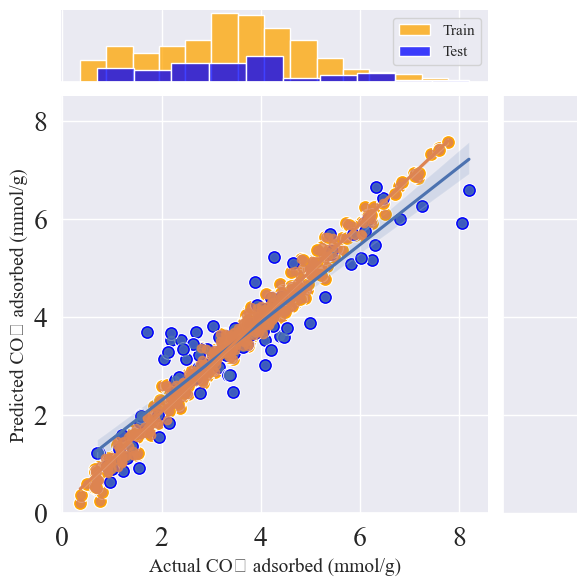

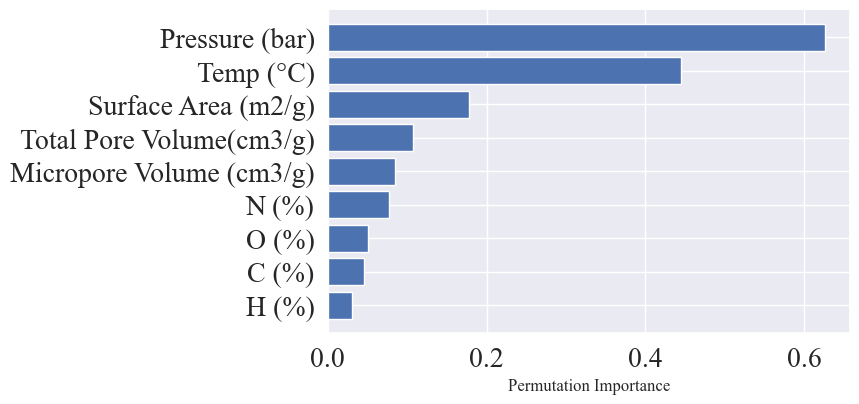

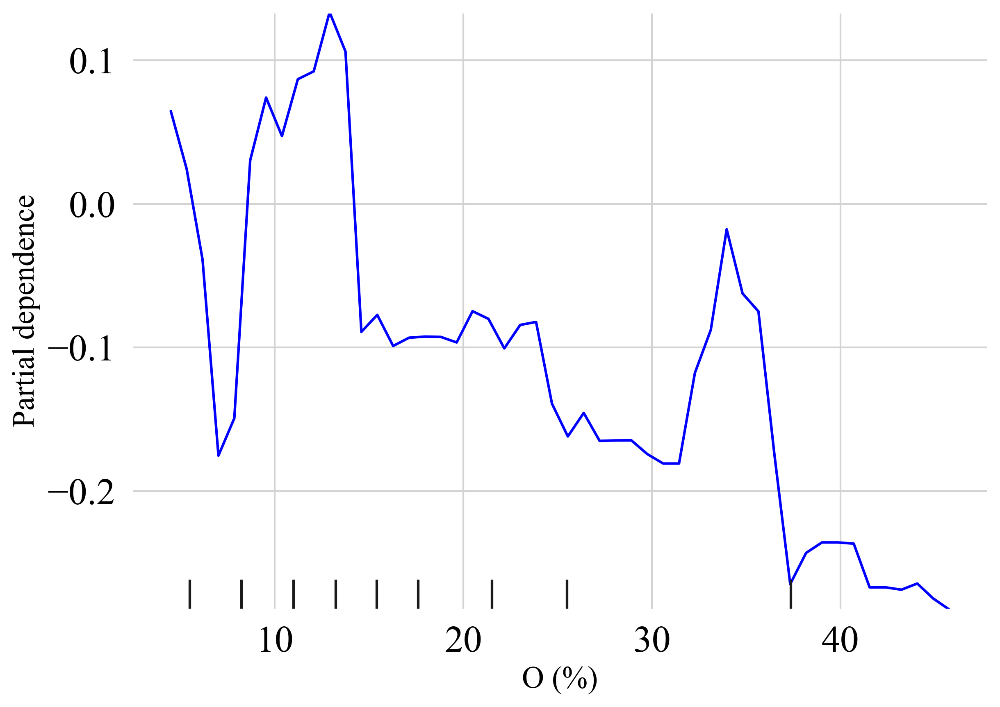

In [38]:
# results achived by the Yaun and his collegues 
primary_code(df_0,0,.2,1)

cross validation with whole x 

Dataset shape:  (527, 10)
The training R2 is: 98.293
The test R2 is: 83.466 
MSE: 0.408
RMSE: 0.638
The mean training accuracy is: 83.213
The standard daviation training accuracy is: 3.694
fit times:  [0.206114 0.219058 0.206375 0.206432 0.211738]


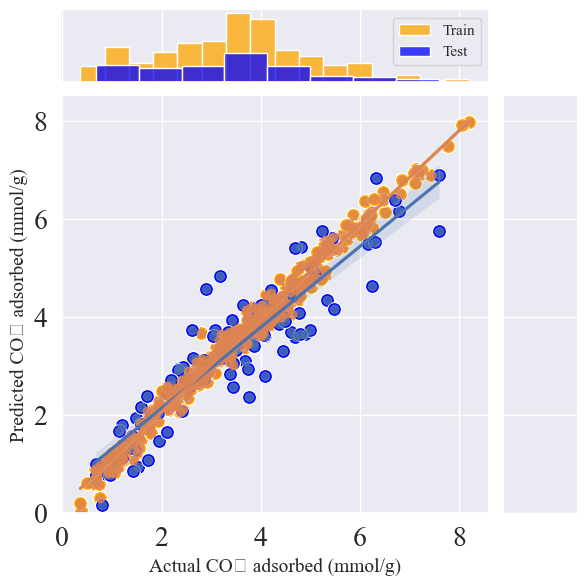

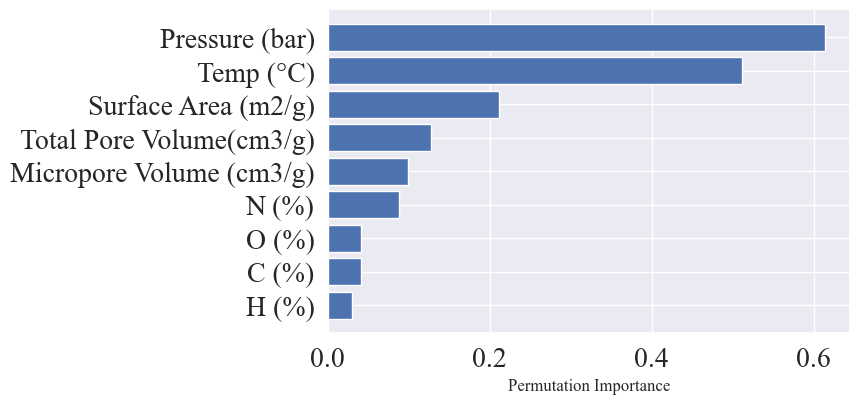

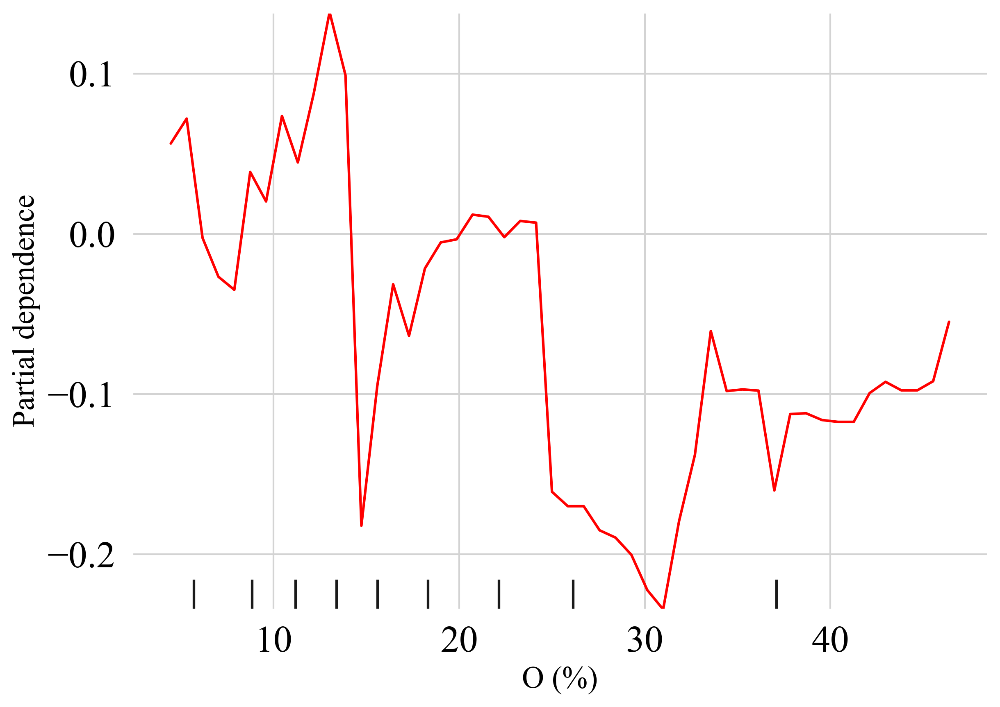

In [39]:
primary_code_s(df_0,0,.2,1)

cross validation with whole x 

Dataset shape:  (527, 10)
The training R2 is: 98.255
The test R2 is: 83.439 
MSE: 0.361
RMSE: 0.601
The mean training accuracy is: 83.347
The standard daviation training accuracy is: 1.885
fit times:  [0.217273 0.205135 0.246233 0.205556 0.223523]


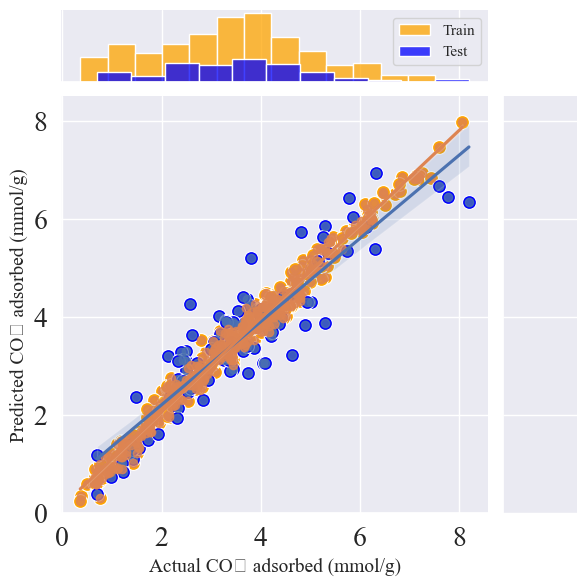

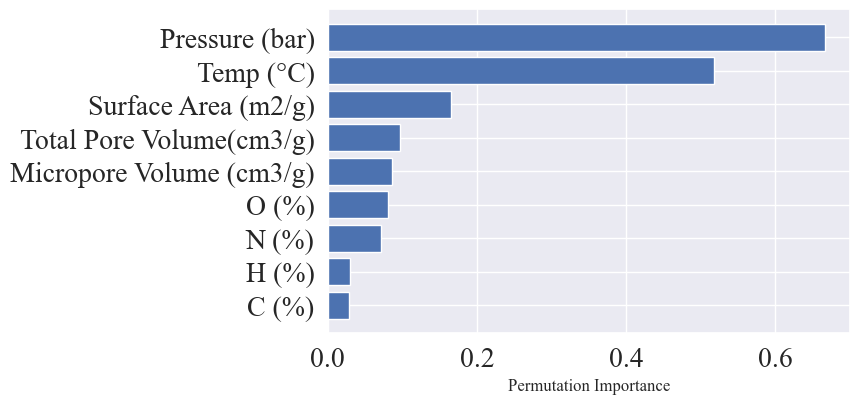

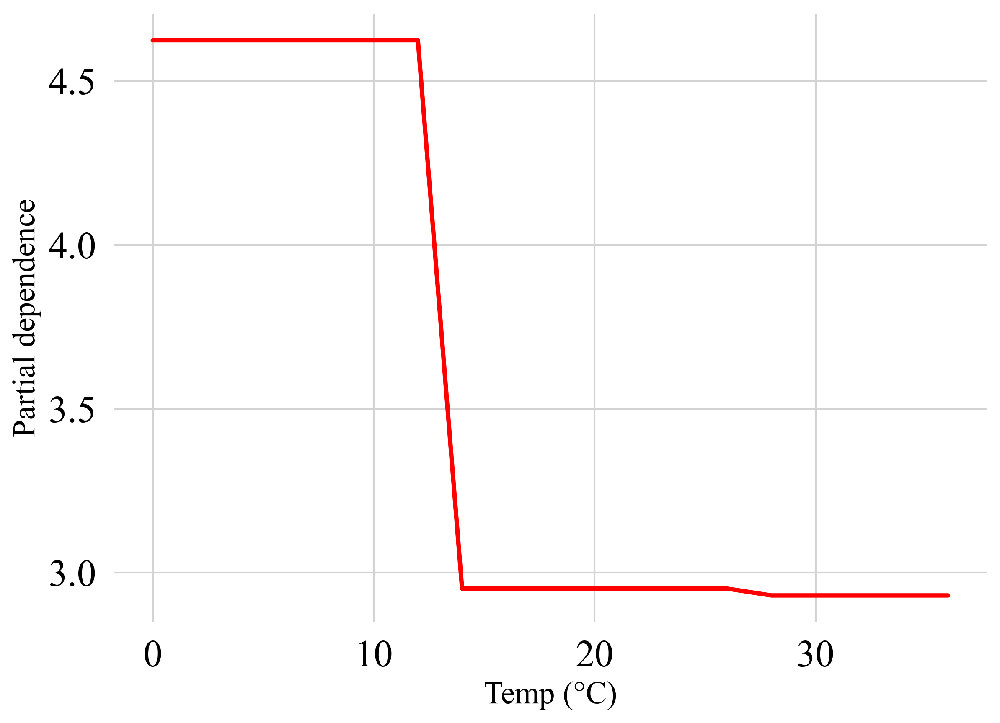

In [40]:
primary_code2(df_0,0,.2,1)

cross validation using whole dataset

Dataset shape:  (527, 10)
The training R2 is: 98.33
The test R2 is: 85.48 
MSE: 0.3974
RMSE: 0.6304
['fit_time', 'score_time', 'test_score']
[]
{'r2': [], 'coef': []}
The mean training accuracy is: 59.994
The standard daviation training accuracy is: 13.378
fit times:  [0.210512 0.205217 0.208773 0.206887 0.244558]


<Figure size 1600x1200 with 0 Axes>

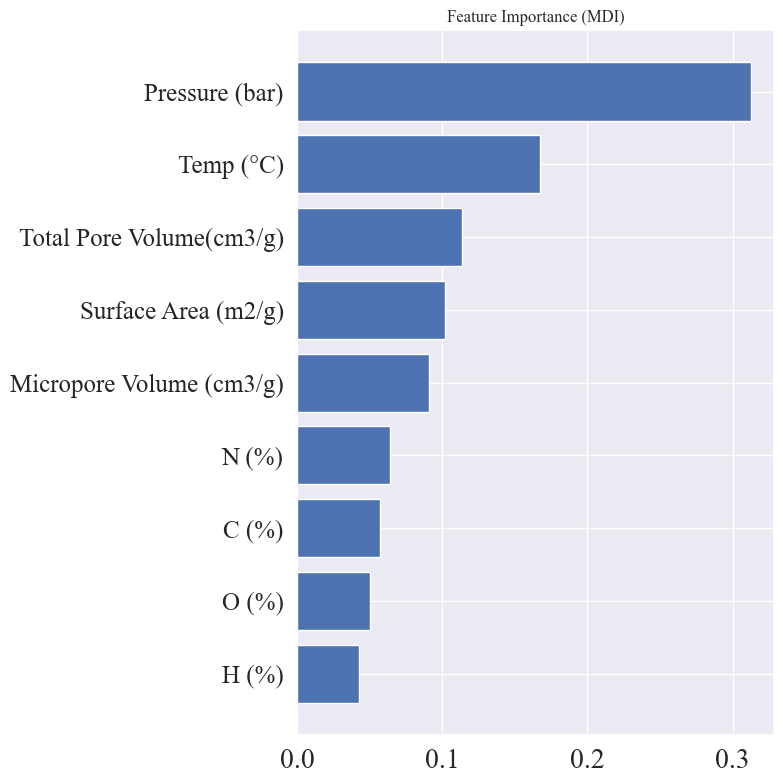

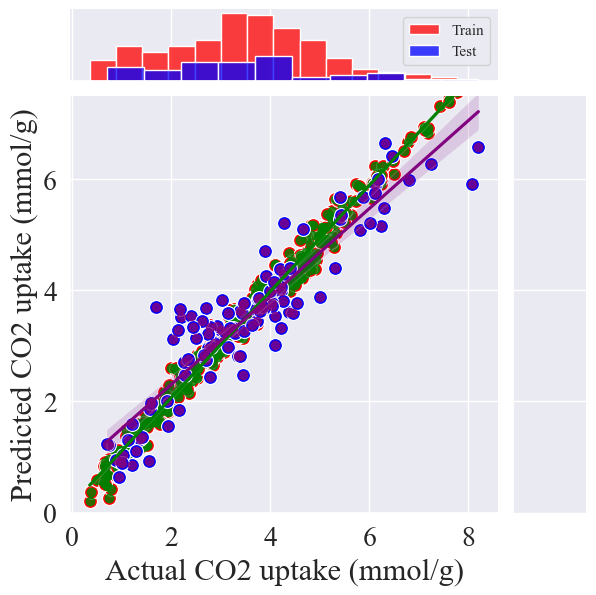

-- Example 1: Basic --
Texttable Output:
+----------------+------+--------+--------+--------+--------+---------+--------+
| performance \  | cv_1 |  cv_2  |  cv_3  |  cv_4  |  cv_4  | cv_mean |  STD   |
|    dataset     |      |        |        |        |        |         |        |
+================+======+========+========+========+========+=========+========+
| Accuracy       |  81  | 56.880 | 44.680 | 68.860 | 48.550 | 59.990  | 13.380 |
+----------------+------+--------+--------+--------+--------+---------+--------+

Latextable Output:
\begin{table}
	\begin{center}
		\begin{tabular}{|l|c|c|c|c|c|c|c|}
			\hline
			performance \ dataset & cv_1 & cv_2 & cv_3 & cv_4 & cv_4 & cv_mean & STD \\
			\hline
			Accuracy & 81 & 56.880 & 44.680 & 68.860 & 48.550 & 59.990 & 13.380 \\
			\hline
		\end{tabular}
	\end{center}
	\caption{An example table.}
	\label{table:example_table}
\end{table}




(array([0.809954, 0.568814, 0.446791, 0.68861 , 0.485533]),
 59.994038261568086,
 0.397422636198885,
 98.33358065576108,
 85.48473066622)

In [41]:
primary_code_latex(df_0, 0, 5, 0.2)

## results of applying deep learning on intial cleaned data sets

3/3 [==============================] - 0s 2ms/step
MSE_test: 0.2811
r2_test: 0.7401
14/14 [==============================] - 0s 1ms/step
MSE_train: 0.1553
r2_train: 0.8424
Standard deviation of predictions on test set: 1.3400


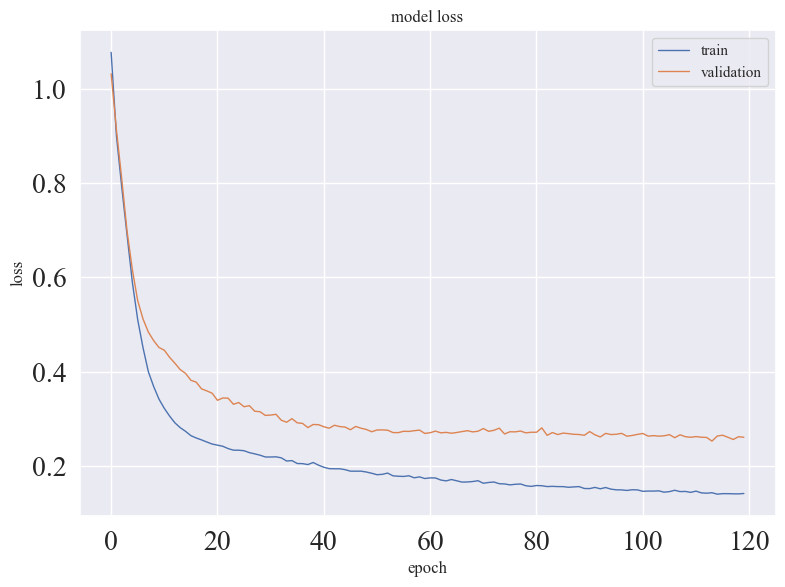

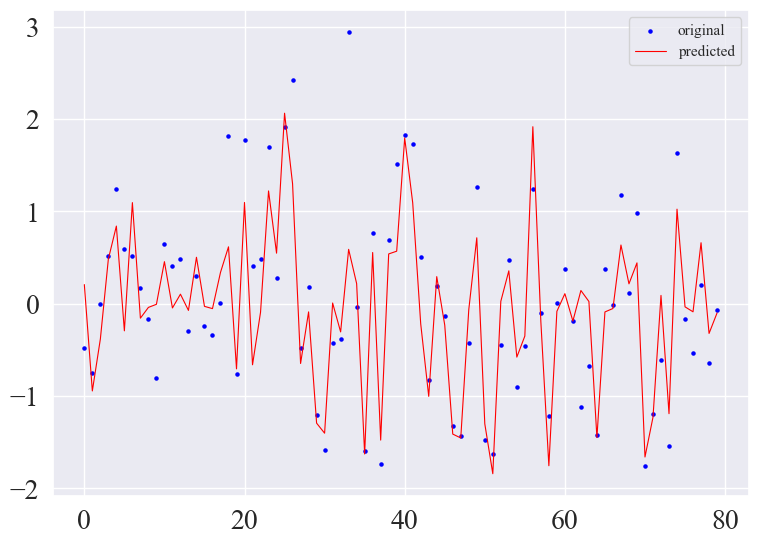

(0.7400514502105249, 0.8424099237078662, 1.339992704157785)

In [42]:
deep_conv2(df_0, 0.15, 0.001, 16)

3/3 [==============================] - 0s 8ms/step
MSE_test: 0.1955
r2_test: 0.7801
14/14 [==============================] - 0s 3ms/step
MSE_train: 0.2380
r2_train: 0.7664
Standard deviation of predictions on test set: 1.2441


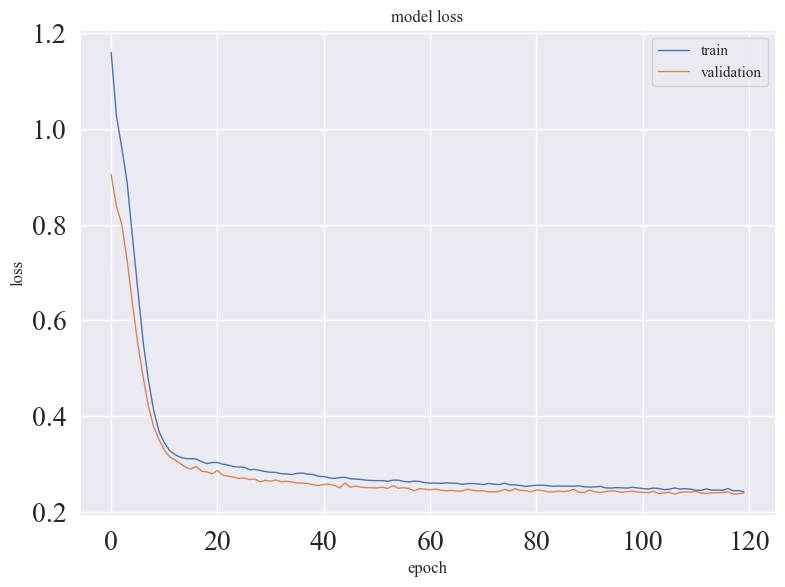

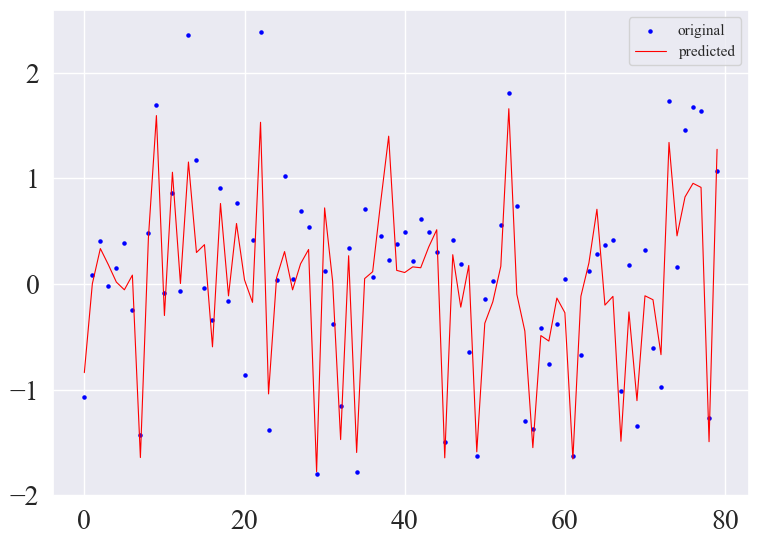

(0.7801292476221835, 0.7664150610806847, 1.2440601181928177)

In [43]:
deep_conv2(shuffle(df_0), 0.15, 0.001, 16)

# Cleaning and preparation of the datasets

In [44]:
#uncomment next line if you want to use imputed data set with Newton's second corder polynoimial
#df_0=df_0_poly.copy()

## Checking and removing duplicated data

In [45]:
dfk=df_0.copy()
dfk['Temp (°C)']=dfk['Temp (°C)']+273.15


In [46]:
def duplicat_row(dataset):
    print(dataset.shape)
    duplicate= dataset[dataset.duplicated()]
    return duplicate

duplicate=duplicat_row(df_0)
duplicate
#df[(df['Surface Area (m2/g)']==1636.0000) & (df['CO2 uptake (mmol/g)']==2.8600) ]
#df = df.drop_duplicates()

(527, 10)


,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
229,1636.0000,0.7400,0.6800,54.0000,3.7500,2.6900,39.5600,25,1.0000,2.8600


In [47]:
df0=df_0.copy()

In [48]:
df0.drop(208,axis=0,inplace=True)
df0.reset_index(drop=True, inplace=True)
df0

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,25,1.0000,2.4386
4,841.3000,0.3600,0.3049,68.4300,0.0000,31.0900,0.4800,25,1.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...
521,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,25,0.1500,0.9800
522,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,25,0.1500,1.1400
523,1230.0000,0.9000,0.2292,66.4100,0.0000,8.3300,25.2600,0,1.0000,5.1400
524,2380.0000,1.6400,0.6988,77.9300,0.0000,4.9400,17.1300,0,1.0000,5.4500


In [49]:
dfs=df_0s
dfs.drop(208,axis=0,inplace=True)
dfs.reset_index(drop=True, inplace=True)
dfs
dfs_first=df_0s[:193]
dfs_second=df_0s[193:]

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),S (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,0.4000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,0.3800,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,0.3700,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,0.4400,25,1.0000,2.4386
4,841.3000,0.3600,0.3049,68.4300,0.0000,31.0900,0.4800,0.0000,25,1.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...,...
521,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,0.0000,25,0.1500,0.9800
522,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,0.0000,25,0.1500,1.1400
523,1230.0000,0.9000,0.2292,66.4100,0.0000,8.3300,25.2600,4.0000,0,1.0000,5.1400
524,2380.0000,1.6400,0.6988,77.9300,0.0000,4.9400,17.1300,1.1200,0,1.0000,5.4500


## Checking for missing values

<AxesSubplot:>

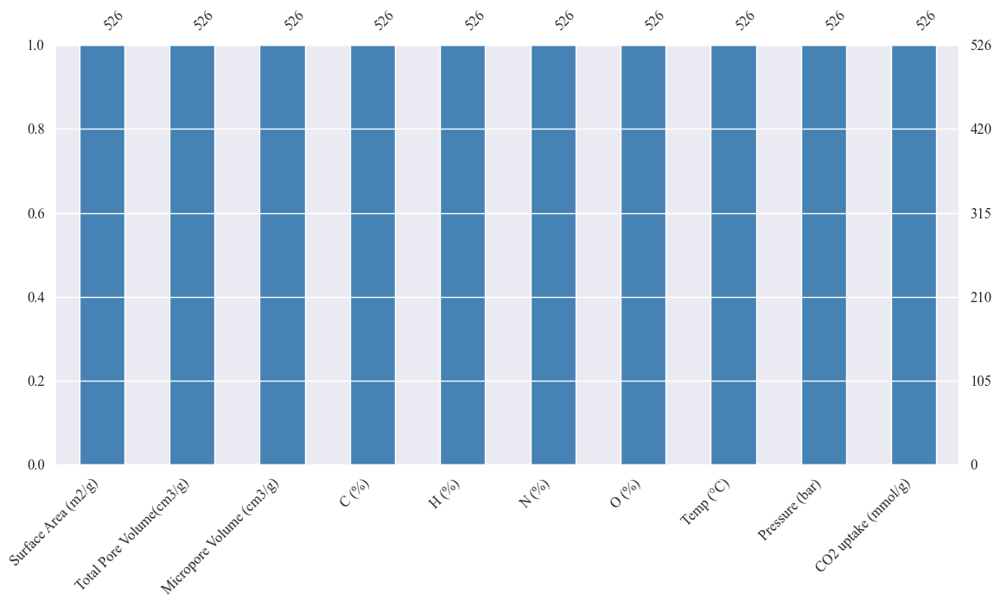

In [50]:
msno.bar(df0, figsize=(12, 6), fontsize=12, color='steelblue')

In [51]:
def missing_values(dataset):
    missing = dataset.columns[dataset.isnull().any()].tolist()
    return missing

In [52]:
print()
print('missing values based on attibutes are in columns:\n')
dfs_second[missing_values(dfs_second)].isnull().sum()
print()



missing values based on attibutes are in columns:



Series([], dtype: float64)

## Checking for zero values

In [53]:
def zeros_check(data):
    for column_name in data.columns:
        column = data[column_name]
        count = (column == 0).sum()
        print('Count of zeros in column ', column_name, ' is : ', count)
        
zeros_check(df_0)
    

Count of zeros in column  Surface Area (m2/g)  is :  0
Count of zeros in column  Total Pore Volume(cm3/g)  is :  0
Count of zeros in column  Micropore Volume (cm3/g)  is :  0
Count of zeros in column  C (%)  is :  0
Count of zeros in column  H (%)  is :  135
Count of zeros in column  N (%)  is :  47
Count of zeros in column  O (%)  is :  10
Count of zeros in column  Temp (°C)  is :  138
Count of zeros in column  Pressure (bar)  is :  0
Count of zeros in column  CO2 uptake (mmol/g)  is :  0


In [54]:
table_1 = Texttable()
table_1.set_cols_align(["l", "c"])
table_1.set_cols_valign(["m", "c"])
table_1.add_rows([["Columns","Number zeros"],
                  ['S (%)',316],
                  ['Temp (°C)',72],
                  ['H (%)',91],
                  ['N (%)',1],
                  ['O (%)',4]])
print('-- Example 1: Basic --')
print('Texttable Output:')
print(table_1.draw())
print('\nLatextable Output:')
print(latextable.draw_latex(table_1, caption="An example table.", label="table:example_table"))

-- Example 1: Basic --
Texttable Output:
+-----------+--------------+
|  Columns  | Number zeros |
+===========+==============+
| S (%)     |     316      |
+-----------+--------------+
| Temp (°C) |      72      |
+-----------+--------------+
| H (%)     |      91      |
+-----------+--------------+
| N (%)     |      1       |
+-----------+--------------+
| O (%)     |      4       |
+-----------+--------------+

Latextable Output:
\begin{table}
	\begin{center}
		\begin{tabular}{|l|c|}
			\hline
			Columns & Number zeros \\
			\hline
			S (%) & 316 \\
			\hline
			Temp (°C) & 72 \\
			\hline
			H (%) & 91 \\
			\hline
			N (%) & 1 \\
			\hline
			O (%) & 4 \\
			\hline
		\end{tabular}
	\end{center}
	\caption{An example table.}
	\label{table:example_table}
\end{table}


## Replacing zero values

In [55]:
# we are going to have two primary df0 and df datasets
#df0 will be the dataset which temperature zeros are left unchanged and df will be dataset which it's zero going 
#to fill out by different methods
#other features zeros will be replaced in both datasets
df=df0.copy()
dfs0=dfs.copy()
df

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,25,1.0000,2.4386
4,841.3000,0.3600,0.3049,68.4300,0.0000,31.0900,0.4800,25,1.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...
521,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,25,0.1500,0.9800
522,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,25,0.1500,1.1400
523,1230.0000,0.9000,0.2292,66.4100,0.0000,8.3300,25.2600,0,1.0000,5.1400
524,2380.0000,1.6400,0.6988,77.9300,0.0000,4.9400,17.1300,0,1.0000,5.4500


In [56]:
dfs['Total Pore Volume(cm3/g)']=df_0['Total Pore Volume(cm3/g)']
dfs['Micropore Volume (cm3/g)']=df_0['Micropore Volume (cm3/g)']

df0['H (%)']=df0['H (%)'].replace(0,np.NaN)#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
df0['H (%)']=df0['H (%)'].interpolate(method ='pad', limit_direction ='forward')

df0['N (%)']=df0['N (%)'].replace(0,np.NaN)#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
df0['N (%)']=df0['N (%)'].interpolate(method ='pad', limit_direction ='forward')

df0['O (%)']=df0['O (%)'].replace(0,np.NaN)#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
df0['O (%)']=df0['O (%)'].interpolate(method ='pad', limit_direction ='forward')



In [57]:
df['H (%)']=df['H (%)'].replace(0,np.NaN)#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
df['H (%)']=df['H (%)'].interpolate(method ='pad', limit_direction ='forward')

df['N (%)']=df['N (%)'].replace(0,np.NaN)#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
df['N (%)']=df['N (%)'].interpolate(method ='pad', limit_direction ='forward')

df['O (%)']=df['O (%)'].replace(0,np.NaN)#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
df['O (%)']=df['O (%)'].interpolate(method ='pad', limit_direction ='forward')

df['Temp (°C)']=df['Temp (°C)'].replace(0,df['Temp (°C)'].mean())#df['H (%)'].mean())
#df['H (%)']=df['H (%)'].fillna(method ='pad')#df.fillna(method ='bfill')
dfs['Temp (°C)']=dfs['Temp (°C)'].replace(0,dfs['Temp (°C)'].mean())
dfs['S (%)']=dfs['S (%)'].replace(0,df_0s['S (%)'].mean())

<Figure size 1200x800 with 0 Axes>

array([[<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>]], dtype=object)

<Figure size 1200x800 with 0 Axes>

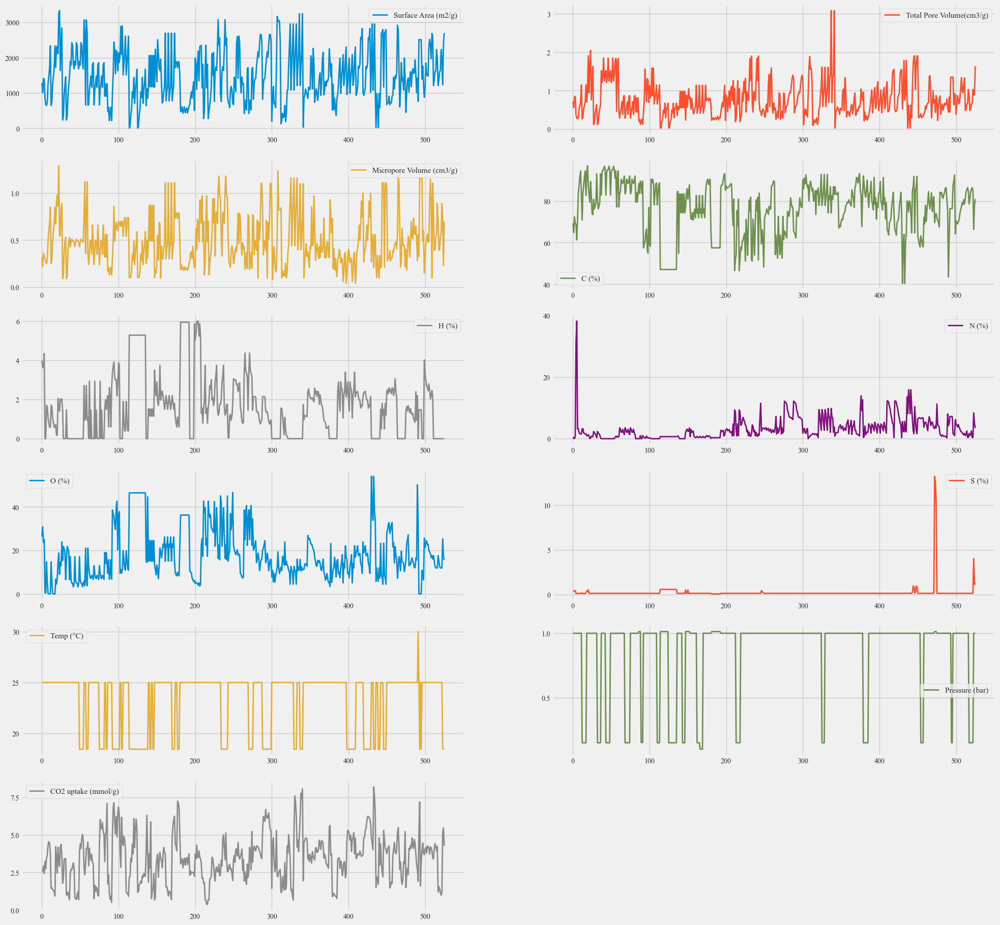

In [58]:
#effect of replacing temperature zeros
plt.figure(dpi=200)
plt.style.use('fivethirtyeight')
dfs.plot(subplots=True,
        layout=(6, 2),
        figsize=(22,22),
        fontsize=10, 
        linewidth=2,
        sharex=False)#,
        #title='Visualization of the original Time Series')
plt.show()

## copies of primary datasets

In [59]:
mdf=df.copy()
mdf0=df0.copy()

mdfs=dfs.copy()
mdfs0=dfs0.copy()
    
mdf0_first=mdf0[:193]
mdf0_second=mdf0[193:]

mdf_first=mdf[:193]
mdf_second=mdf[193:]

mdfs0_first=dfs0[:193]
mdfs0_second=dfs0[193:]

mdfs_first=dfs[:193]
mdfs_second=dfs[193:]

mdf0_first_shuffled = shuffle(mdf0_first)
mdf_first_shuffled = shuffle(mdf_first)
mdfs0_first_shuffled = shuffle(mdfs0_first)
mdfs_first_shuffled = shuffle(mdfs_first)


mdf0_second_shuffled = shuffle(mdf0_second)
mdf_second_shuffled = shuffle(mdf_second)
mdfs0_second_shuffled = shuffle(mdfs0_second)
mdfs_second_shuffled = shuffle(mdfs_second)


mdf0_shuffled = shuffle(mdf0)
mdfs0_shuffled = shuffle(mdfs0)
mdf_shuffled = shuffle(mdf)
mdfs_shuffled = shuffle(mdfs)

ds=df.copy()
ds0=df0.copy()

## Checking correlation between features

In [60]:
corr_matrix=df.corr()
corr_matrix.sort_values(ascending=False,by='CO2 uptake (mmol/g)')

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
CO2 uptake (mmol/g),0.2872,0.2449,0.2410,-0.0369,-0.0135,0.1462,0.0051,-0.5338,0.6152,1.0000
Pressure (bar),0.1030,0.1188,0.0373,-0.0088,0.0663,0.1473,-0.0448,-0.0910,1.0000,0.6152
Surface Area (m2/g),1.0000,0.9169,0.8265,0.3431,-0.2796,-0.1045,-0.2900,-0.0820,0.1030,0.2872
Total Pore Volume(cm3/g),0.9169,1.0000,0.7446,0.3100,-0.2632,-0.1011,-0.2465,-0.1204,0.1188,0.2449
Micropore Volume (cm3/g),0.8265,0.7446,1.0000,0.2398,-0.2725,-0.0533,-0.1878,-0.0615,0.0373,0.2410
N (%),-0.1045,-0.1011,-0.0533,-0.1993,-0.0899,1.0000,-0.0657,-0.0157,0.1473,0.1462
O (%),-0.2900,-0.2465,-0.1878,-0.9396,0.4829,-0.0657,1.0000,-0.2534,-0.0448,0.0051
H (%),-0.2796,-0.2632,-0.2725,-0.5153,1.0000,-0.0899,0.4829,-0.1542,0.0663,-0.0135
C (%),0.3431,0.3100,0.2398,1.0000,-0.5153,-0.1993,-0.9396,0.2372,-0.0088,-0.0369
Temp (°C),-0.0820,-0.1204,-0.0615,0.2372,-0.1542,-0.0157,-0.2534,1.0000,-0.0910,-0.5338


In [61]:
#InteractiveShell.ast_node_interactivity = "all"
InteractiveShell.ast_node_interactivity = "last_expr"

<Figure size 800x600 with 0 Axes>

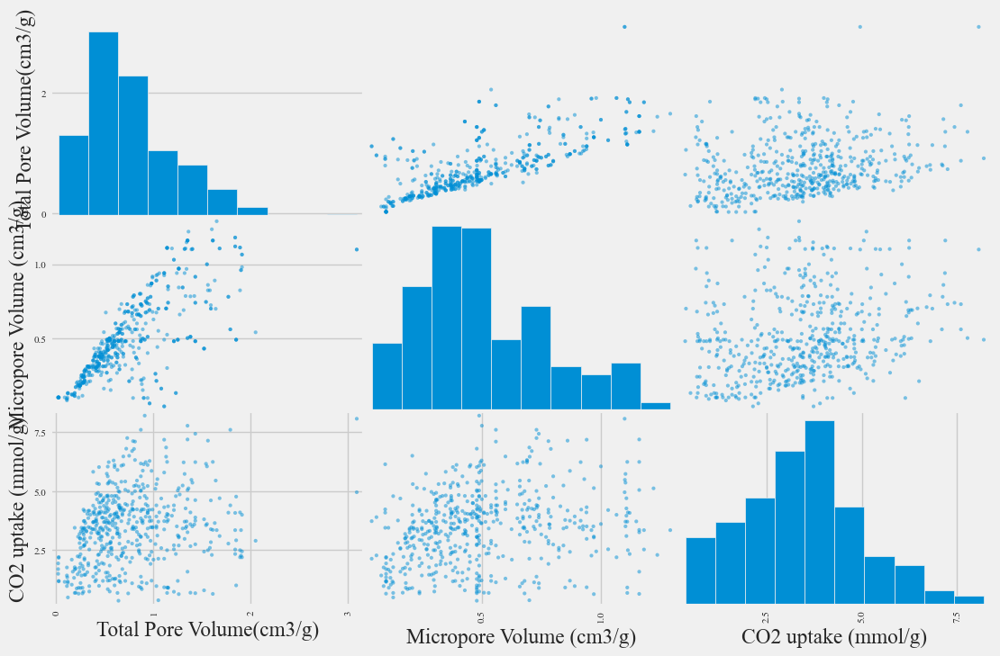

In [62]:

plt.figure(figsize=(8,6),dpi=100);
featuers=['Total Pore Volume(cm3/g)','Micropore Volume (cm3/g)','CO2 uptake (mmol/g)']#for nonlinear relations
scatter_matrix(df[featuers],figsize=(12,8),cmap='blue');
#plt.show();

<Figure size 800x600 with 0 Axes>

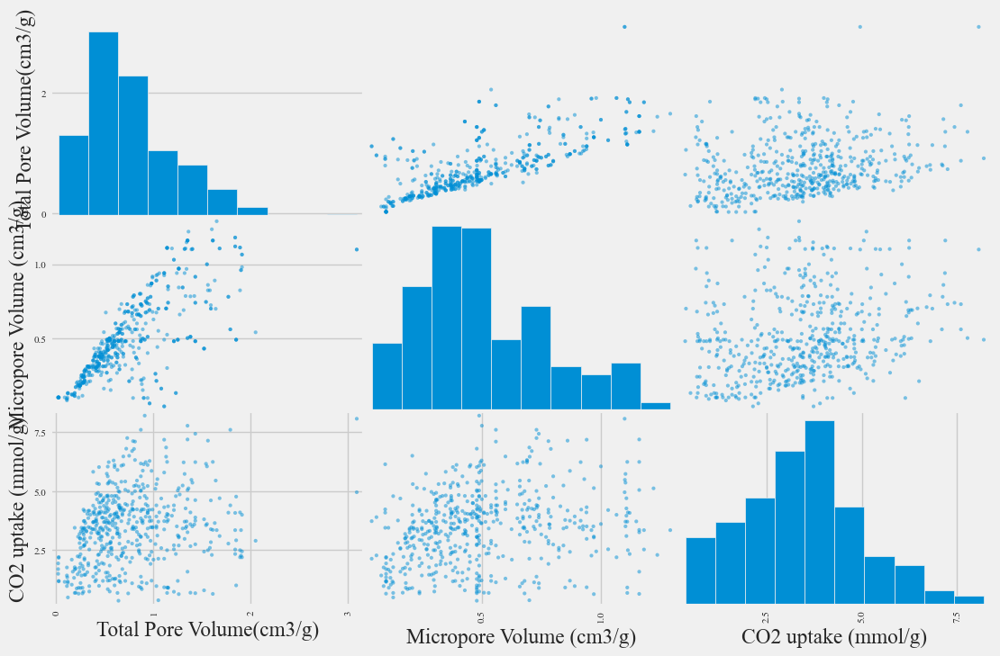

In [63]:
plt.figure(figsize=(8,6),dpi=100);
featuers=['Total Pore Volume(cm3/g)','Micropore Volume (cm3/g)','CO2 uptake (mmol/g)']#for nonlinear relations
scatter_matrix(df0[featuers],figsize=(12,8),cmap='blue');


In [64]:
df['Temp (°C)'].unique()
df['Temp (°C)'].value_counts()

25.0000    387
18.4506    138
30.0000      1
Name: Temp (°C), dtype: int64

In [65]:
df['Pressure (bar)'].value_counts()

1.0000    408
0.1500     76
1.0132     12
1.0132     12
1.0130     11
0.1000      4
0.1520      3
Name: Pressure (bar), dtype: int64

## correlation matrix and p-values

In [66]:

def calculate_pvalues(dataset):
    dfcols = pd.DataFrame(columns=dataset.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in dataset.columns:
        for c in dataset.columns:
            tmp = dataset[dataset[r].notnull() & dataset[c].notnull()]
            pvalues[r][c] = round(pearsonr(tmp[r], tmp[c])[1], 4)
    return pvalues


In [67]:
calculate_pvalues(df_0) 


,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
Surface Area (m2/g),0.0000,0.0000,0.0000,0.0000,0.0000,0.0144,0.0000,0.0678,0.0179,0.0000
Total Pore Volume(cm3/g),0.0000,0.0000,0.0000,0.0000,0.0000,0.0166,0.0000,0.0062,0.0063,0.0000
Micropore Volume (cm3/g),0.0000,0.0000,0.0000,0.0000,0.0000,0.1993,0.0000,0.1732,0.3867,0.0000
C (%),0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.8148,0.4163
H (%),0.0000,0.0000,0.0000,0.0000,0.0000,0.0053,0.0000,0.0003,0.1789,0.6291
N (%),0.0144,0.0166,0.1993,0.0000,0.0053,0.0000,0.0604,0.7048,0.0006,0.0006
O (%),0.0000,0.0000,0.0000,0.0000,0.0000,0.0604,0.0000,0.0000,0.6001,0.8684
Temp (°C),0.0678,0.0062,0.1732,0.0000,0.0003,0.7048,0.0000,0.0000,0.0350,0.0000
Pressure (bar),0.0179,0.0063,0.3867,0.8148,0.1789,0.0006,0.6001,0.0350,0.0000,0.0000
CO2 uptake (mmol/g),0.0000,0.0000,0.0000,0.4163,0.6291,0.0006,0.8684,0.0000,0.0000,0.0000


In [68]:
def corr_heat(dataset):
    
    plt.figure(figsize=(12,10),dpi=200);
    sns.heatmap(np.round(dataset.corr(),3),cmap='PRGn', annot=True);
    plt.xticks(rotation = 30, horizontalalignment='right', fontsize= 18, fontname = "Times New Roman");
    plt.yticks(rotation = 0, fontsize= 18, fontname = "Times New Roman");
    plt.show();
    
    

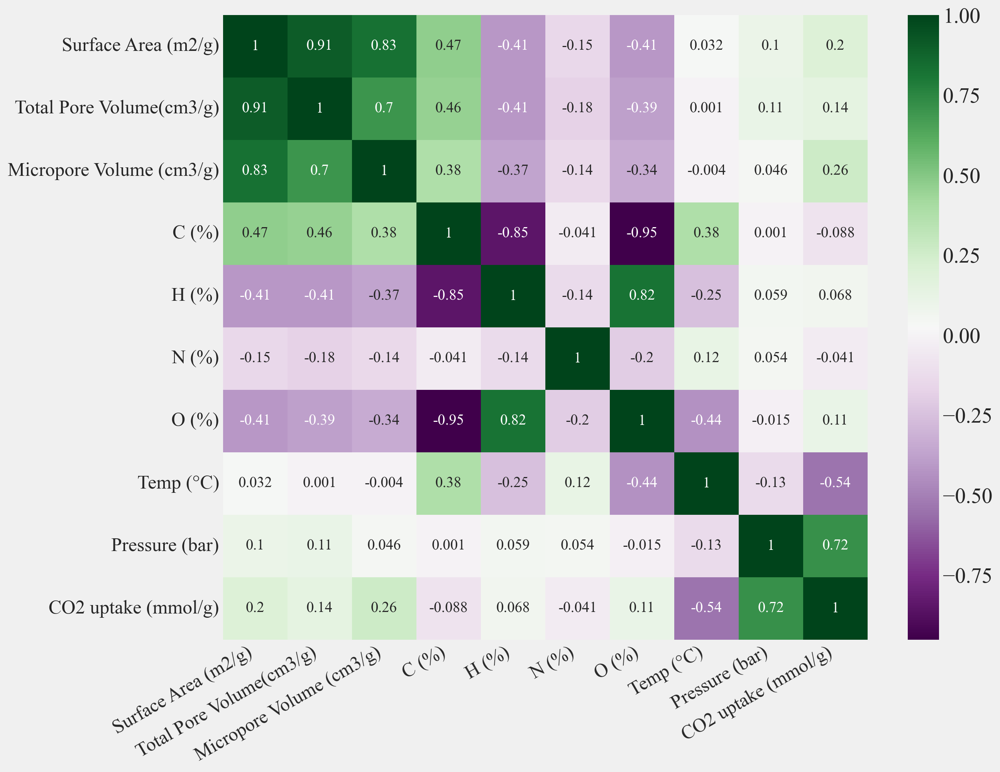

In [69]:
corr_heat(df_first)


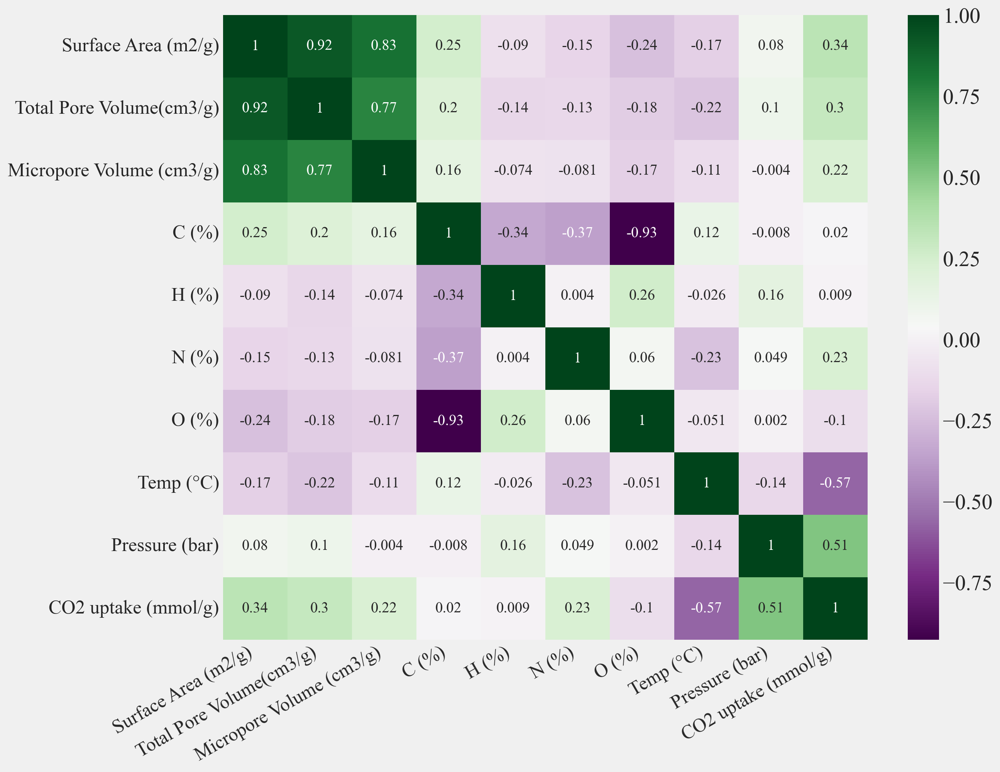

In [70]:
corr_heat(df_second)


In [71]:
def P_OLS_all(dataset):
    X = dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y = dataset['CO2 uptake (mmol/g)']
    X2 = sm.add_constant(X)
    est = sm.OLS(y, X2)
    est2 = est.fit()
    print(est2.summary())

In [72]:
P_OLS_all(df_0)

                             OLS Regression Results                            
Dep. Variable:     CO2 uptake (mmol/g)   R-squared:                       0.674
Model:                             OLS   Adj. R-squared:                  0.668
Method:                  Least Squares   F-statistic:                     118.6
Date:                 Tue, 29 Aug 2023   Prob (F-statistic):          1.13e-119
Time:                         09:40:34   Log-Likelihood:                -689.13
No. Observations:                  527   AIC:                             1398.
Df Residuals:                      517   BIC:                             1441.
Df Model:                            9                                         
Covariance Type:             nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const         

In [73]:
def p_value_data0(dataset): 
    X = dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y = dataset['CO2 uptake (mmol/g)']
    lm = LinearRegression()
    lm.fit(X,y)
    params = np.append(lm.intercept_,lm.coef_)
    
    predictions = lm.predict(X)

    # newX = pd.DataFrame({"Constant":np.ones(len(X))}).join(pd.DataFrame(X))
    # MSE = (sum((y-predictions)**2))/(len(newX)-len(newX.columns))

    # Note if you don't want to use a DataFrame replace the two lines above with
    newX = np.append(np.ones((len(X),1)), X, axis=1)
    MSE = (sum((y-predictions)**2))/(len(newX)-len(newX[0]))

    var_b = MSE*(np.linalg.inv(np.dot(newX.T,newX)).diagonal())
    sd_b = np.sqrt(var_b)
    ts_b = params/ sd_b

    p_values =[2*(1-stats.t.cdf(np.abs(i),(len(newX)-len(newX[0])))) for i in ts_b]

    sd_b = np.round(sd_b,4)
    ts_b = np.round(ts_b,4)
    p_values = np.round(p_values,6)
    params = np.round(params,4)

    DF = pd.DataFrame(index=X.columns)
    DF["Coeff."],DF["std"],DF[" t_values"],DF[" P_values"] = [params[1:],sd_b[1:],ts_b[1:],p_values[1:]]

    #myDF3["features"],myDF3["Coefficients"],myDF3["Standard Errors"],myDF3["t values"],myDF3["Probabilities"] = [df_0.columns,params,sd_b,ts_b,p_values]
    return DF

In [74]:
DF=p_value_data0(df_0)
DF

,Coeff.,std,t_values,P_values
Surface Area (m2/g),0.0009,0.0002,5.5054,0.0000
Total Pore Volume(cm3/g),-1.1618,0.2233,-5.2034,0.0000
Micropore Volume (cm3/g),0.4460,0.2573,1.7336,0.0836
C (%),-0.0212,0.0185,-1.1492,0.2510
H (%),-0.0610,0.0375,-1.6236,0.1051
N (%),0.0061,0.0217,0.2832,0.7772
O (%),-0.0239,0.0182,-1.3140,0.1894
Temp (°C),-0.0706,0.0038,-18.6538,0.0000
Pressure (bar),2.8124,0.1321,21.2954,0.0000


In [75]:


def p_value_data(dataset):
    
    X = dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y = dataset['CO2 uptake (mmol/g)']
    lm = LinearRegression()
    lm.fit(X,y)
    params = np.append(lm.intercept_,lm.coef_)
    predictions = lm.predict(X)

    # newX = pd.DataFrame({"Constant":np.ones(len(X))}).join(pd.DataFrame(X))
    # MSE = (sum((y-predictions)**2))/(len(newX)-len(newX.columns))

    # Note if you don't want to use a DataFrame replace the two lines above with
    newX = np.append(np.ones((len(X),1)), X, axis=1)
    MSE = (sum((y-predictions)**2))/(len(newX)-len(newX[0]))

    var_b = MSE*(np.linalg.inv(np.dot(newX.T,newX)).diagonal())
    sd_b = np.sqrt(var_b)
    ts_b = params/ sd_b

    p_values =[2*(1-stats.t.cdf(np.abs(i),(len(newX)-len(newX[0])))) for i in ts_b]

    sd_b = np.round(sd_b,3)
    ts_b = np.round(ts_b,3)
    p_values = np.round(p_values,4)
    params = np.round(params,4)

    DF = pd.DataFrame()
    #DF[" Coeff."],DF[" Stan.Err."],DF[" t-values"],DF[" P_values"] = [params,sd_b,ts_b,p_values]
    t1=dataset.columns
    t0=pd.Index(['constant'])
    t0=t0.append([t1])[:dataset.shape[1]]

    DF["Coeff"],DF["StanEr"],DF["t-values"],DF["Prob"] = [params,sd_b,ts_b,p_values]
    print(DF)
    return DF


In [76]:
p_value_data(df_first)

    Coeff  StanEr  t-values   Prob
0  3.0766  2.4200    1.2710 0.2053
1  0.0002  0.0000    0.7190 0.4729
2 -0.9020  0.3200   -2.8170 0.0054
3  2.1533  0.4450    4.8340 0.0000
4 -0.0149  0.0240   -0.6120 0.5413
5 -0.0357  0.0660   -0.5430 0.5876
6 -0.0243  0.0300   -0.8150 0.4159
7 -0.0178  0.0240   -0.7460 0.4567
8 -0.0678  0.0060  -11.7770 0.0000
9  2.9244  0.1570   18.5930 0.0000


,Coeff,StanEr,t-values,Prob
0,3.0766,2.4200,1.2710,0.2053
1,0.0002,0.0000,0.7190,0.4729
2,-0.9020,0.3200,-2.8170,0.0054
3,2.1533,0.4450,4.8340,0.0000
4,-0.0149,0.0240,-0.6120,0.5413
5,-0.0357,0.0660,-0.5430,0.5876
6,-0.0243,0.0300,-0.8150,0.4159
7,-0.0178,0.0240,-0.7460,0.4567
8,-0.0678,0.0060,-11.7770,0.0000
9,2.9244,0.1570,18.5930,0.0000


## Partial dependence of features respect to co2 adsorption

In [77]:


def PDP_co2(dataset,i):
    

    x = dataset.drop('CO2 uptake (mmol/g)',axis=1)
    y = dataset['CO2 uptake (mmol/g)']
    
    
    feature=x.columns
    x_train, x_test , y_train , y_test = train_test_split(x, y, test_size=0.2, random_state = 42)
    model =  GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1,
                                           min_samples_split = 2, n_estimators = 300, 
                                           subsample = 0.5, random_state=42)
    model.fit(x,y)
    
    
       
    font = FontProperties()
    font.set_family('serif')
    font.set_name('Times New Roman')

    fig, ax = plt.subplots(figsize =(8, 6),dpi=300)


    plot_partial_dependence(model, x,[feature[i]],feature_names = feature,kind='average' ,target = 0,
                            n_jobs = 3, grid_resolution = 50, ax=ax,
                            line_kw=None,ice_lines_kw=None,contour_kw=None,pd_line_kw={'color':'skyblue'})
    
    ax.grid(False)

    
    
    
#     plt.tick_params(axis = 'x', labelsize = 22)
#     plt.tick_params(axis = 'y', labelsize = 22)
#     ax.set_xlabel('Temperature', fontsize='large')
#     ax.set_ylabel('PI', fontsize='large')
    plt.show()

In [78]:
def PDP_shap_co2(dataset,i,j):
    if j==0:
        curve_color='red'
    else:
        curve_color='skyblue'
    x = df_0.drop('CO2 uptake (mmol/g)',axis=1)
    y = df_0['CO2 uptake (mmol/g)']
    feature=x.columns
    X100 = x.sample(n=200)
    feature=x.columns
    x_train, x_test , y_train , y_test = train_test_split(x, y, test_size=0.2, random_state = 42)
    model =  GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1,
                                           min_samples_split = 2, n_estimators = 300, 
                                           subsample = 0.5, random_state=42)
    model.fit(x,y)
    shap.plots.partial_dependence(
        feature[i], model.predict, X100, ice=False,
        model_expected_value=True, feature_expected_value=True)

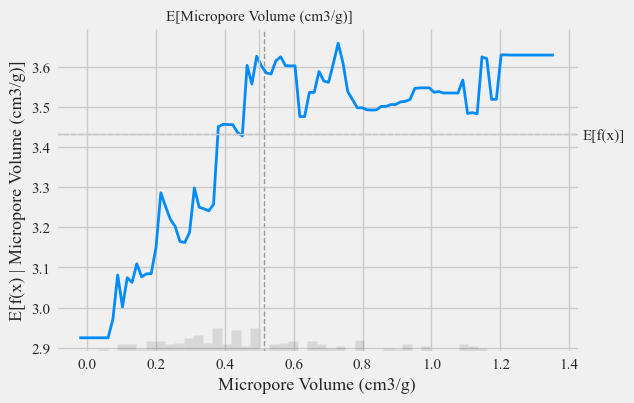

In [79]:
PDP_shap_co2(df_0,2,1)

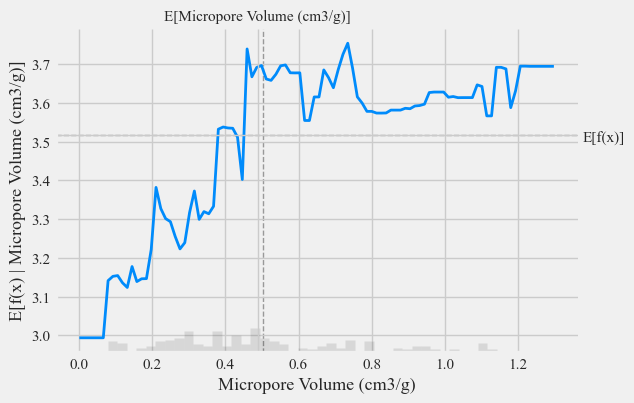

In [80]:
df_0_shuffled=shuffle(df_0)
PDP_shap_co2(df_0_shuffled,2,1)

## Adding new possible featuers

In [81]:
df['Surfacem2/TotalPor(cm3)']=df['Surface Area (m2/g)']/df['Total Pore Volume(cm3/g)']
df['Surfacem2/Micropore(cm3']=df['Surface Area (m2/g)']/df['Micropore Volume (cm3/g)']
df['Surface2/C']=df['Surface Area (m2/g)']/df['C (%)']
df['Surface2/H (%)']=df['Surface Area (m2/g)']/df['H (%)']
df['Surface2/N (%)']=df['Surface Area (m2/g)']/df['N (%)']
df['Surface2/O']=df['Surface Area (m2/g)']/df['O (%)']
df['Surface2/Temp']=df['Surface Area (m2/g)']/df['Temp (°C)']
df['Surface2/Pressure']=df['Surface Area (m2/g)']/df['Pressure (bar)']
#############
df['Total(cm3)/Micropore(cm3)']=df['Total Pore Volume(cm3/g)']/df['Micropore Volume (cm3/g)']
df['Total(cm3)/C']=df['Total Pore Volume(cm3/g)']/df['C (%)']
df['(Total(cm3)/g)/H (%)']=df['Total Pore Volume(cm3/g)']/df['H (%)']
df['Total(cm3)/N (%)']=df['Total Pore Volume(cm3/g)']/df['N (%)']
df['Total(cm3)/O']=df['Total Pore Volume(cm3/g)']/df['O (%)']
df['Total(cm3)/Temp']=df['Total Pore Volume(cm3/g)']/df['Temp (°C)']
df['Total(cm3)/Pressure']=df['Total Pore Volume(cm3/g)']/df['Pressure (bar)']
###########

df['Micropore(cm3/g)/C']=df['Micropore Volume (cm3/g)']/df['C (%)']
df['Micropore(cm3/g)/H (%)']=df['Micropore Volume (cm3/g)']/df['H (%)']
df['Micropore(cm3/g)/N (%)']=df['Micropore Volume (cm3/g)']/df['N (%)']
df['Micropore(cm3/g)/O']=df['Micropore Volume (cm3/g)']/df['O (%)']
df['Micropore(cm3/g)/Temp']=df['Micropore Volume (cm3/g)']/df['Temp (°C)']
df['Micropore(cm3/g)/Pressure']=df['Micropore Volume (cm3/g)']/df['Pressure (bar)']
###########

df['C/H (%)']=df['C (%)']/df['H (%)']
df['C/N (%)']=df['C (%)']/df['N (%)']
df['C/O']=df['C (%)']/df['O (%)']
df['C/Temp']=df['C (%)']/df['Temp (°C)']
df['C/Pressure']=df['C (%)']/df['Pressure (bar)']
############
df['H/N (%)']=df['H (%)']/df['N (%)']
df['H/O']=df['H (%)']/df['O (%)']
df['H/Temp']=df['H (%)']/df['Temp (°C)']
df['H/Pressure']=df['H (%)']/df['Pressure (bar)']
############
df['N/O']=df['N (%)']/df['O (%)']
df['N/Temp']=df['N (%)']/df['Temp (°C)']
df['N/Pressure']=df['N (%)']/df['Pressure (bar)']
################
df['O/Temp']=df['O (%)']/df['Temp (°C)']
df['O/Pressure']=df['O (%)']/df['Pressure (bar)']
###################
df['Temp/Pressure']=df['Temp (°C)']/df['Pressure (bar)']
print()
print('new shape of data set is: ', df.shape)
df.head(5)


new shape of data set is:  (526, 46)


,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g),...,H/N (%),H/O,H/Temp,H/Pressure,N/O,N/Temp,N/Pressure,O/Temp,O/Pressure,Temp/Pressure
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,25.0000,1.0000,2.6250,...,49.8750,0.1517,0.1596,3.9900,0.0030,0.0032,0.0800,1.0520,26.3000,25.0000
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,25.0000,1.0000,2.5864,...,9.5789,0.1183,0.1456,3.6400,0.0123,0.0152,0.3800,1.2308,30.7700,25.0000
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,25.0000,1.0000,2.9205,...,363.0000,0.1539,0.1452,3.6300,0.0004,0.0004,0.0100,0.9436,23.5900,25.0000
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,25.0000,1.0000,2.4386,...,5.7237,0.1744,0.1740,4.3500,0.0305,0.0304,0.7600,0.9976,24.9400,25.0000
4,841.3000,0.3600,0.3049,68.4300,4.3500,31.0900,0.4800,25.0000,1.0000,3.2300,...,0.1399,9.0625,0.1740,4.3500,64.7708,1.2436,31.0900,0.0192,0.4800,25.0000


In [82]:
zeros_check(df0)

Count of zeros in column  Surface Area (m2/g)  is :  0
Count of zeros in column  Total Pore Volume(cm3/g)  is :  0
Count of zeros in column  Micropore Volume (cm3/g)  is :  0
Count of zeros in column  C (%)  is :  0
Count of zeros in column  H (%)  is :  0
Count of zeros in column  N (%)  is :  0
Count of zeros in column  O (%)  is :  0
Count of zeros in column  Temp (°C)  is :  138
Count of zeros in column  Pressure (bar)  is :  0
Count of zeros in column  CO2 uptake (mmol/g)  is :  0


In [83]:
df0['Surfacem2/TotalPor(cm3))']=df0['Surface Area (m2/g)']/df0['Total Pore Volume(cm3/g)']
df0['Surfacem2/Micropore(cm3)']=df0['Surface Area (m2/g)']/df0['Micropore Volume (cm3/g)']
df0['Surface2/C']=df0['Surface Area (m2/g)']/df0['C (%)']
df0['Surface2/H (%)']=df0['Surface Area (m2/g)']/df0['H (%)']
df0['Surface2/N (%)']=df0['Surface Area (m2/g)']/df0['N (%)']
df0['Surface2/O']=df0['Surface Area (m2/g)']/df0['O (%)']
#df0['Surface2/Temp)']=df0['Surface Area (m2/g)']/df0['Temp (°C)']
df0['Surface2/Pressure']=df0['Surface Area (m2/g)']/df0['Pressure (bar)']
#############
df0['Total(cm3)/Micropore(cm3)']=df0['Total Pore Volume(cm3/g)']/df0['Micropore Volume (cm3/g)']
df0['Total(cm3)/C']=df0['Total Pore Volume(cm3/g)']/df0['C (%)']
df0['(Total(cm3)/g)/H (%)']=df0['Total Pore Volume(cm3/g)']/df0['H (%)']
df0['Total(cm3)/N (%)']=df0['Total Pore Volume(cm3/g)']/df0['N (%)']
df0['Total(cm3)/O']=df0['Total Pore Volume(cm3/g)']/df0['O (%)']
#df0['Total(cm3)/Temp)']=df0['Total Pore Volume(cm3/g)']/df0['Temp (°C)']
df0['Total(cm3)/Pressure']=df0['Total Pore Volume(cm3/g)']/df0['Pressure (bar)']
###########

df0['Micropore(cm3/g)/C']=df0['Micropore Volume (cm3/g)']/df0['C (%)']
df0['Micropore(cm3/g)/H (%)']=df0['Micropore Volume (cm3/g)']/df0['H (%)']
df0['Micropore(cm3/g)/N (%)']=df0['Micropore Volume (cm3/g)']/df0['N (%)']
df0['Micropore(cm3/g)/O']=df0['Micropore Volume (cm3/g)']/df0['O (%)']
#df0['Micropore(cm3/g)/Temp)']=df0['Micropore Volume (cm3/g)']/df0['Temp (°C)']
df0['Micropore(cm3/g)/Pressure']=df0['Micropore Volume (cm3/g)']/df0['Pressure (bar)']
###########

df0['C/H (%)']=df0['C (%)']/df0['H (%)']
df0['C/N (%)']=df0['C (%)']/df0['N (%)']
df0['C/O']=df0['C (%)']/df0['O (%)']
#df0['C/Temp)']=df0['C (%)']/df0['Temp (°C)']
df0['C/Pressure']=df0['C (%)']/df0['Pressure (bar)']
############
df0['H/N (%)']=df0['H (%)']/df0['N (%)']
df0['H/O']=df0['H (%)']/df0['O (%)']
#df0['H/Temp)']=df0['H (%)']/df0['Temp (°C)']
df0['H/Pressure']=df0['H (%)']/df0['Pressure (bar)']
############
df0['N/O']=df0['N (%)']/df0['O (%)']
#df0['N/Temp)']=df0['N (%)']/df0['Temp (°C)']
df0['N/Pressure']=df0['N (%)']/df0['Pressure (bar)']
################
#df0['O/Temp)']=df0['O (%)']/df0['Temp (°C)']
df0['O/Pressure']=df0['O (%)']/df0['Pressure (bar)']
###################
#df0['Temp/Pressure']=df0['Temp (°C)']/df0['Pressure (bar)']
print()
print('new shape of data set is: ', df0.shape)
df0.head(5)


new shape of data set is:  (526, 38)


,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g),...,C/H (%),C/N (%),C/O,C/Pressure,H/N (%),H/O,H/Pressure,N/O,N/Pressure,O/Pressure
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,25,1.0000,2.6250,...,17.3484,865.2500,2.6319,69.2200,49.8750,0.1517,3.9900,0.0030,0.0800,26.3000
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,25,1.0000,2.5864,...,17.8104,170.6053,2.1069,64.8300,9.5789,0.1183,3.6400,0.0123,0.3800,30.7700
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,25,1.0000,2.9205,...,19.9477,7241.0000,3.0695,72.4100,363.0000,0.1539,3.6300,0.0004,0.0100,23.5900
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,25,1.0000,2.4386,...,15.9793,91.4605,2.7871,69.5100,5.7237,0.1744,4.3500,0.0305,0.7600,24.9400
4,841.3000,0.3600,0.3049,68.4300,4.3500,31.0900,0.4800,25,1.0000,3.2300,...,15.7310,2.2010,142.5625,68.4300,0.1399,9.0625,4.3500,64.7708,31.0900,0.4800


## Correlation between target and all othert features

In [84]:
def correlation_matrix(dataset):
    corr_matrix=dataset.corr()
    aa=corr_matrix['CO2 uptake (mmol/g)'].sort_values(ascending=False)
    print(aa[:10])
    print(aa.to_latex(index=True))

In [85]:
correlation_matrix(df)

CO2 uptake (mmol/g)     1.0000
Pressure (bar)          0.6152
Surface2/Temp           0.4341
Micropore(cm3/g)/Temp   0.3734
Total(cm3)/Temp         0.3710
C/Temp                  0.3685
Surface2/C              0.3426
Total(cm3)/C            0.2960
Surface Area (m2/g)     0.2872
Micropore(cm3/g)/C      0.2683
Name: CO2 uptake (mmol/g), dtype: float64
\begin{tabular}{lr}
\toprule
{} &  CO2 uptake (mmol/g) \\
\midrule
CO2 uptake (mmol/g)       &               1.0000 \\
Pressure (bar)            &               0.6152 \\
Surface2/Temp             &               0.4341 \\
Micropore(cm3/g)/Temp     &               0.3734 \\
Total(cm3)/Temp           &               0.3710 \\
C/Temp                    &               0.3685 \\
Surface2/C                &               0.3426 \\
Total(cm3)/C              &               0.2960 \\
Surface Area (m2/g)       &               0.2872 \\
Micropore(cm3/g)/C        &               0.2683 \\
Total Pore Volume(cm3/g)  &               0.2449 \\
Micropore

In [86]:
dss0=df0.copy()
dss=df.copy()
print(dss0.shape)
print(dss.shape)

(526, 38)
(526, 46)


## Removing high and low correlated features to target and feature selection

In [87]:
def remove_high_corr_features(dataset):
    corr_matrix = dataset.corr().abs()
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
    to_drop = [column for column in upper.columns if (any(upper[column] > 0.95)& any(upper[column] < 0.05) )]
    dataset.drop(to_drop, axis=1, inplace=True)
    print()
    print('new shape after removing some features based on correlation: ', dataset.shape)
    print()
    print('dataset fetures after removing high correlated ones:\n',dataset.columns)

In [88]:
remove_high_corr_features(df)


new shape after removing some features based on correlation:  (526, 27)

dataset fetures after removing high correlated ones:
 Index(['Surface Area (m2/g)', 'Total Pore Volume(cm3/g)',
       'Micropore Volume (cm3/g)', 'C (%)', 'H (%)', 'N (%)', 'O (%)',
       'Temp (°C)', 'Pressure (bar)', 'CO2 uptake (mmol/g)',
       'Surfacem2/TotalPor(cm3)', 'Surfacem2/Micropore(cm3', 'Surface2/C',
       'Surface2/H (%)', 'Surface2/N (%)', 'Surface2/O', 'Surface2/Temp',
       'Surface2/Pressure', 'Total(cm3)/C', 'Micropore(cm3/g)/C', 'C/H (%)',
       'C/Temp', 'H/O', 'H/Pressure', 'N/O', 'N/Pressure', 'O/Pressure'],
      dtype='object')


## important feature  selection for zero values filled up temperature feature

In [89]:
def importance_features(dataset):
    columns_feat_imp=[]
   
    gbr21=GradientBoostingRegressor(n_estimators=80)

    df_train=dataset.drop('CO2 uptake (mmol/g)',axis=1)
    df_label=dataset['CO2 uptake (mmol/g)']

    gbr=gbr21.fit(df_train, df_label)


    names = df_train.columns

    perm_importance = permutation_importance(gbr, df_train, df_label)
    per_sorted_idx = perm_importance.importances_mean.argsort()
        
    
    plt.figure(figsize=(8,6),dpi=200)
    plt.bar(names[per_sorted_idx[-30:]], perm_importance.importances_mean[per_sorted_idx[-30:]])
    plt.xticks(rotation = 60, horizontalalignment='right', fontsize= 12, fontname = "Times New Roman")
    plt.ylabel("Permutation Importance")
    plt.figure(num=None, figsize=(10,8), dpi=200, facecolor='w', edgecolor='k')
    
    
    features_dss=names[per_sorted_idx][-30:]
    

    imp_sort_index = pd.Series(gbr.feature_importances_, index= df_train.columns)


    gbr.feature_importances_.round(2)

    imp_sorted_index=names[imp_sort_index.argsort()]
    imp_sort_index.nlargest(30).plot(kind='bar')
    
    return features_dss,imp_sorted_index
     

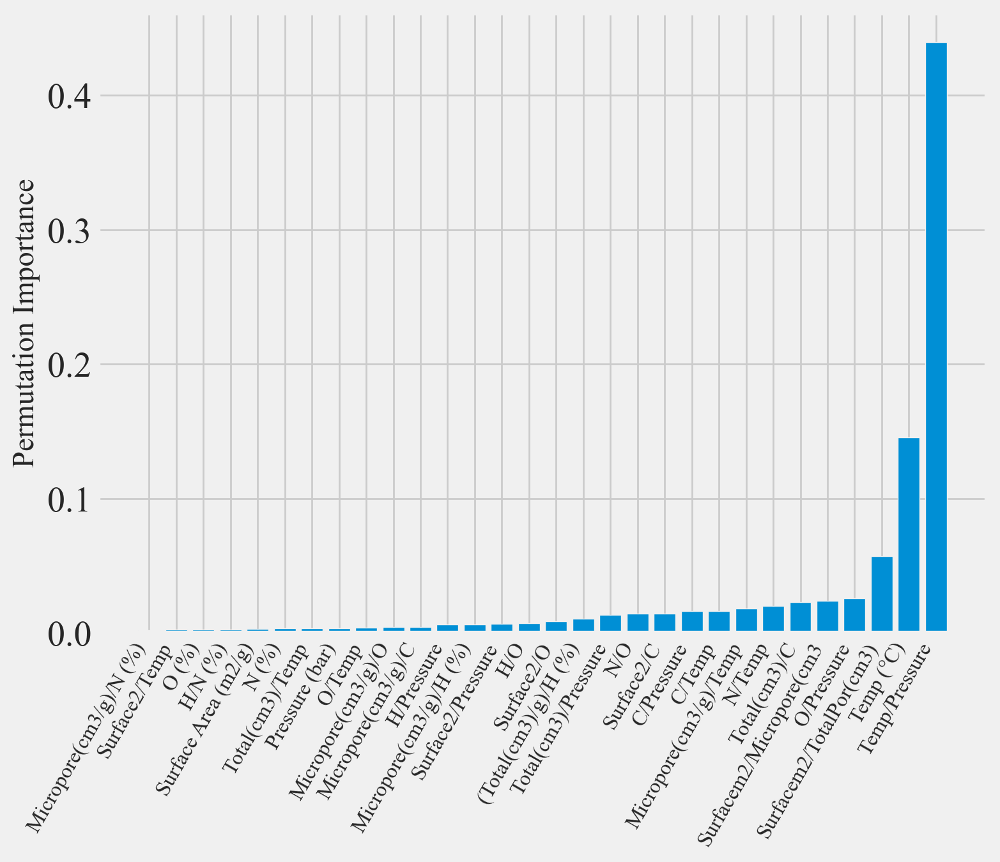

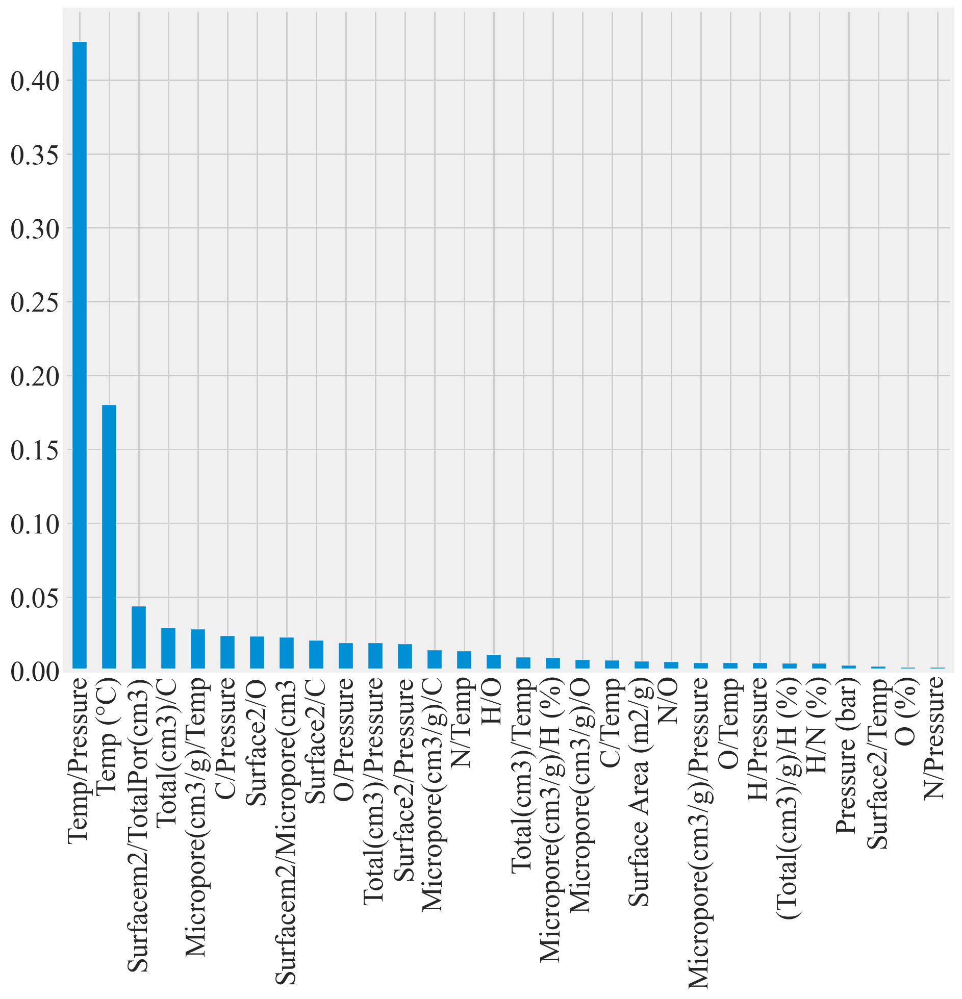

In [90]:
features_dss,imp_sorted_index=importance_features(dss)

(Index(['C/N (%)', 'Total(cm3)/Micropore(cm3)', 'N/Pressure', 'H/Pressure',
        'Surface2/N (%)', 'Micropore(cm3/g)/Pressure', 'Micropore(cm3/g)/N (%)',
        'H/N (%)', 'Total Pore Volume(cm3/g)', 'Surface Area (m2/g)',
        'Total(cm3)/N (%)', 'H/O', 'O (%)', 'Micropore Volume (cm3/g)',
        'Micropore(cm3/g)/H (%)', 'Surface2/Pressure', 'Micropore(cm3/g)/C',
        'Surface2/O', 'Surface2/C', '(Total(cm3)/g)/H (%)',
        'Total(cm3)/Pressure', 'Total(cm3)/C', 'O/Pressure',
        'Surfacem2/Micropore(cm3)', 'N/O', 'N (%)', 'Surfacem2/TotalPor(cm3))',
        'C/Pressure', 'Pressure (bar)', 'Temp (°C)'],
       dtype='object'),
 Index(['Surface2/H (%)', 'H (%)', 'C/N (%)', 'Total(cm3)/O', 'C (%)', 'C/O',
        'H/Pressure', 'Surface2/N (%)', 'Micropore(cm3/g)/N (%)', 'C/H (%)',
        'O (%)', 'N/Pressure', 'Total(cm3)/Micropore(cm3)',
        '(Total(cm3)/g)/H (%)', 'Micropore(cm3/g)/O', 'Total(cm3)/N (%)',
        'H/N (%)', 'H/O', 'Surface Area (m2/g)', 'Total 

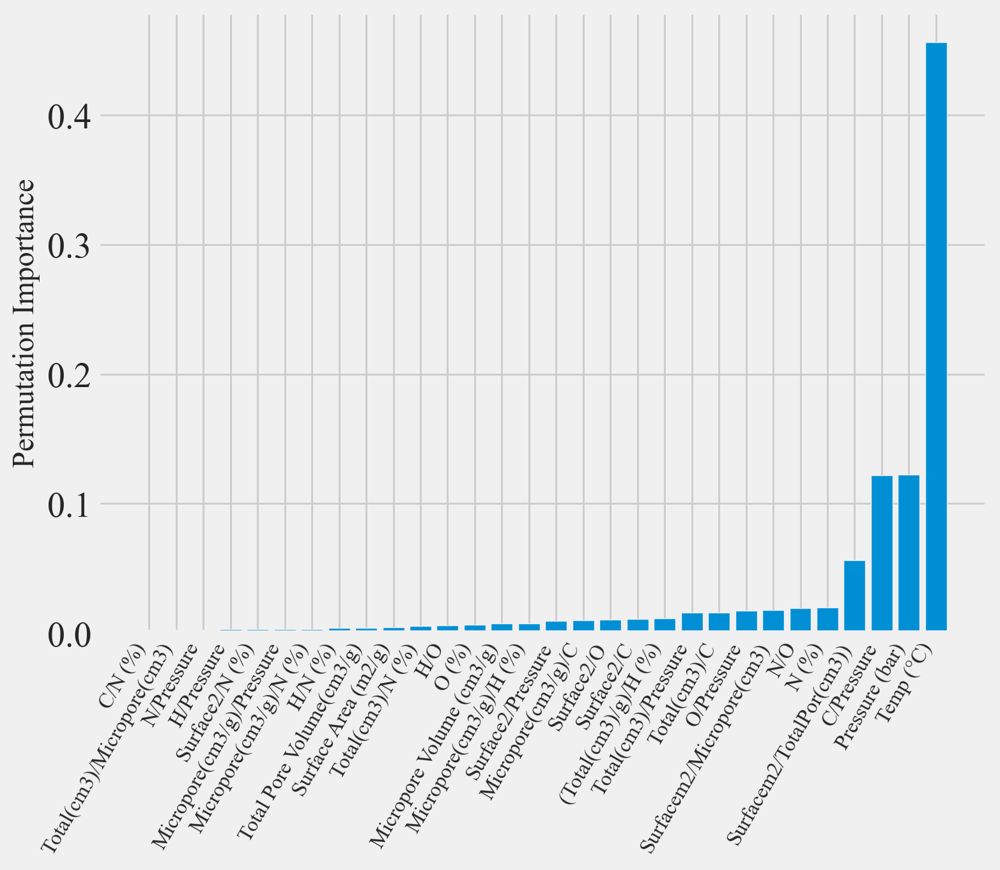

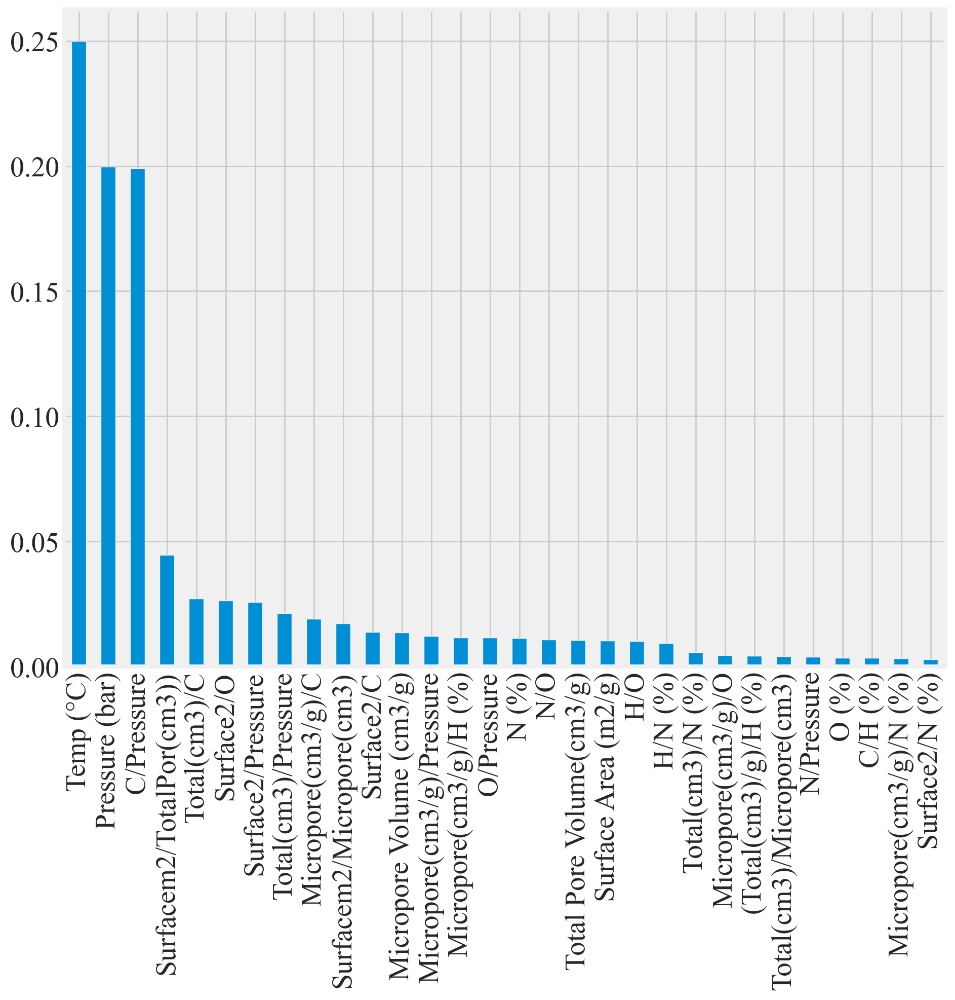

In [91]:
importance_features(dss0)

## mutual information

In [92]:

# Utility functions from Tutorial
def make_mi_scores(x, y):
    x = x.copy()
    for colname in x.select_dtypes(["object", "category"]):
        x[colname], _ = x[colname].factorize()
    # All discrete features should now have integer dtypes
    discrete_features = [pd.api.types.is_integer_dtype(t) for t in x.dtypes]
    mi_scores = mutual_info_regression(x, y, discrete_features=discrete_features, random_state=0)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=x.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores


def plot_mi_scores(scores):
    scores = scores.sort_values(ascending=True)
#     width = np.arange(len(scores))
#     ticks = list(scores.index)
    plt.bar(scores)
    #plt.yticks(width, ticks)
    plt.title("Mutual Information Scores")



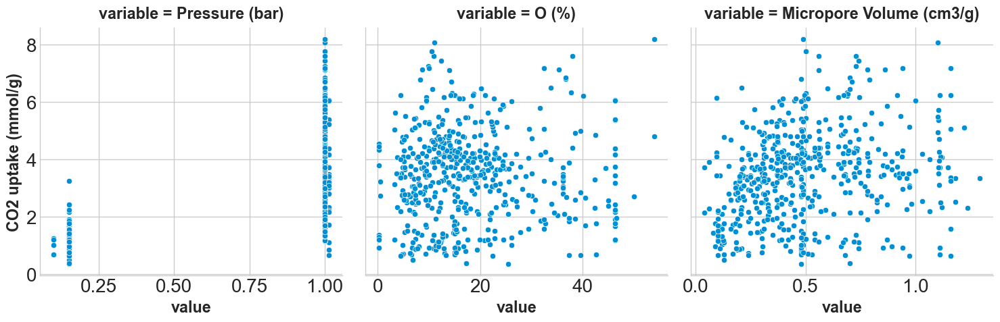

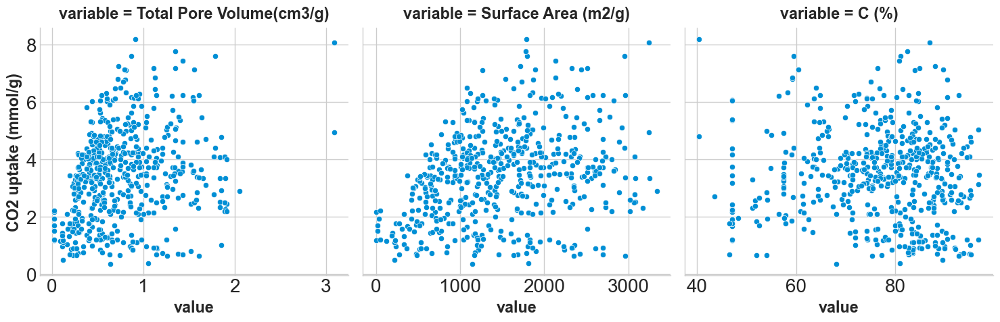

In [93]:
# Set Matplotlib defaults
plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True)
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=14,
    titlepad=10,
)

features1 = ["Pressure (bar)", "O (%)", "Micropore Volume (cm3/g)"]
features2 = ['Total Pore Volume(cm3/g)','Surface Area (m2/g)','C (%)']
sns.relplot( x="value", y="CO2 uptake (mmol/g)", col="variable",
            data=dss.melt(id_vars="CO2 uptake (mmol/g)", value_vars=features1), facet_kws=dict(sharex=False),);
sns.relplot( x="value", y="CO2 uptake (mmol/g)", col="variable",
            data=dss.melt(id_vars="CO2 uptake (mmol/g)", value_vars=features2), facet_kws=dict(sharex=False),);

In [94]:
x = dss.copy()
y = x.pop('CO2 uptake (mmol/g)')

mi_scores = make_mi_scores(x, y)
mi_scores[:10]


Temp/Pressure               0.5184
Surface2/Pressure           0.3812
Total(cm3)/Pressure         0.3432
C/Pressure                  0.3414
Micropore(cm3/g)/Pressure   0.3203
Pressure (bar)              0.3098
H/Pressure                  0.2561
O/Pressure                  0.2395
Total(cm3)/Temp             0.2285
C/Temp                      0.2249
Name: MI Scores, dtype: float64

In [95]:
#plt.plot(mi_scores[:10])
ser = pd.DataFrame(mi_scores)

mu_features=ser.index
mu_features
dsm=dss[mu_features[:30]]
dsm['CO2 uptake (mmol/g)']=dss['CO2 uptake (mmol/g)']
x_mu=dsm
x_mu

,Temp/Pressure,Surface2/Pressure,Total(cm3)/Pressure,C/Pressure,Micropore(cm3/g)/Pressure,Pressure (bar),H/Pressure,O/Pressure,Total(cm3)/Temp,C/Temp,...,H/N (%),O (%),N/Temp,Micropore(cm3/g)/C,C (%),Surface Area (m2/g),C/N (%),Total(cm3)/N (%),(Total(cm3)/g)/H (%),CO2 uptake (mmol/g)
0,25.0000,1281.6000,0.7100,69.2200,0.3200,1.0000,3.9900,26.3000,0.0284,2.7688,...,49.8750,26.3000,0.0032,0.0046,69.2200,1281.6000,865.2500,8.8750,0.1779,2.6250
1,25.0000,1012.6000,0.5600,64.8300,0.2200,1.0000,3.6400,30.7700,0.0224,2.5932,...,9.5789,30.7700,0.0152,0.0034,64.8300,1012.6000,170.6053,1.4737,0.1538,2.5864
2,25.0000,1408.8000,0.8300,72.4100,0.3600,1.0000,3.6300,23.5900,0.0332,2.8964,...,363.0000,23.5900,0.0004,0.0050,72.4100,1408.8000,7241.0000,83.0000,0.2287,2.9205
3,25.0000,1403.9000,0.8500,69.5100,0.3300,1.0000,4.3500,24.9400,0.0340,2.7804,...,5.7237,24.9400,0.0304,0.0047,69.5100,1403.9000,91.4605,1.1184,0.1954,2.4386
4,25.0000,841.3000,0.3600,68.4300,0.3049,1.0000,4.3500,0.4800,0.0144,2.7372,...,0.1399,0.4800,1.2436,0.0045,68.4300,841.3000,2.2010,0.0116,0.0828,3.2300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
521,166.6667,14866.6667,6.8667,576.6667,5.9333,0.1500,14.0667,79.3333,0.0412,3.4600,...,5.2750,11.9000,0.0160,0.0103,86.5000,2230.0000,216.2500,2.5750,0.4882,0.9800
522,166.6667,13000.0000,5.8667,565.3333,4.8000,0.1500,14.0667,79.3333,0.0352,3.3920,...,5.2750,11.9000,0.0160,0.0085,84.8000,1950.0000,212.0000,2.2000,0.4171,1.1400
523,18.4506,1230.0000,0.9000,66.4100,0.2292,1.0000,2.1100,25.2600,0.0488,3.5993,...,0.2533,25.2600,0.4515,0.0035,66.4100,1230.0000,7.9724,0.1080,0.4265,5.1400
524,18.4506,2380.0000,1.6400,77.9300,0.6988,1.0000,2.1100,17.1300,0.0889,4.2237,...,0.4271,17.1300,0.2677,0.0090,77.9300,2380.0000,15.7753,0.3320,0.7773,5.4500


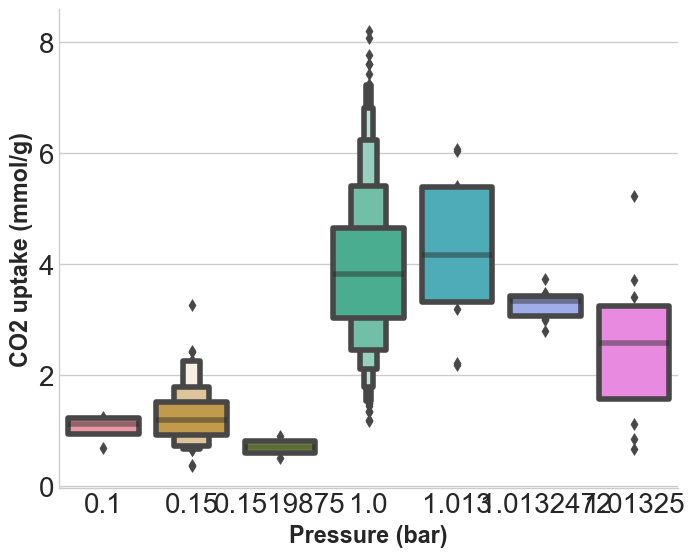

In [96]:
#plt.figure(figsize=(20,16),dpi=150)
g=sns.catplot(x="Pressure (bar)", y="CO2 uptake (mmol/g)", data=dss, kind="boxen");
g.fig.set_size_inches(8,6)


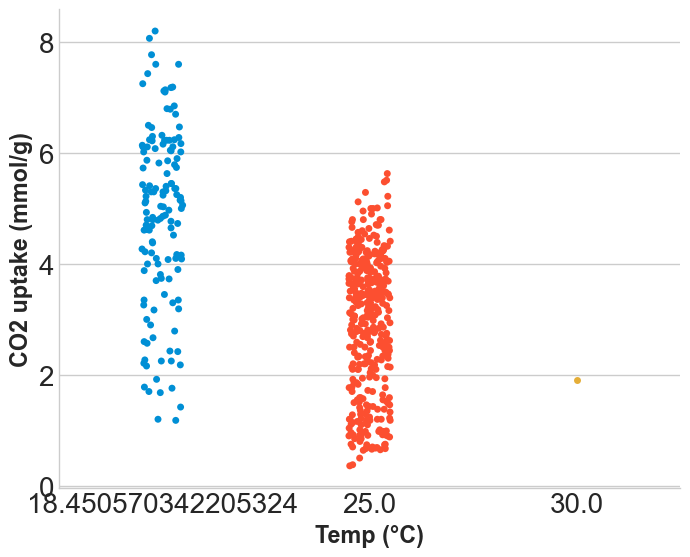

In [97]:
#plt.figure(figsize=(20,16),dpi=150)
g=sns.catplot(x="Temp (°C)", y="CO2 uptake (mmol/g)", data=dss, kind="strip");
g.fig.set_size_inches(8,6)


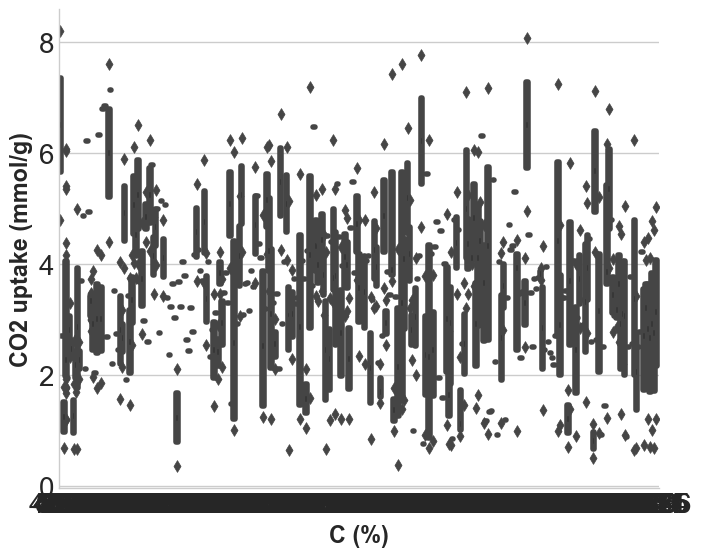

In [98]:
#plt.figure(figsize=(20,16),dpi=150)
g=sns.catplot(x="C (%)", y="CO2 uptake (mmol/g)", data=dss, kind="boxen");
g.fig.set_size_inches(8,6)


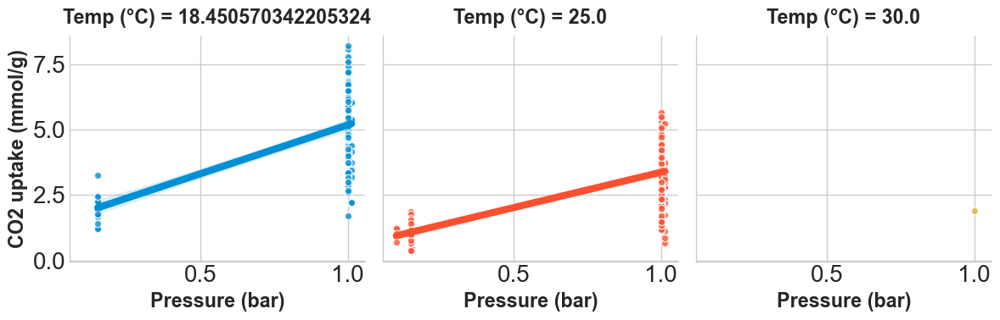

In [99]:
feature = "Pressure (bar)"

sns.lmplot(
    x=feature, y="CO2 uptake (mmol/g)", hue="Temp (°C)", col="Temp (°C)",
    data=dss, scatter_kws={"edgecolor": 'w'}, col_wrap=3, height=4,
);

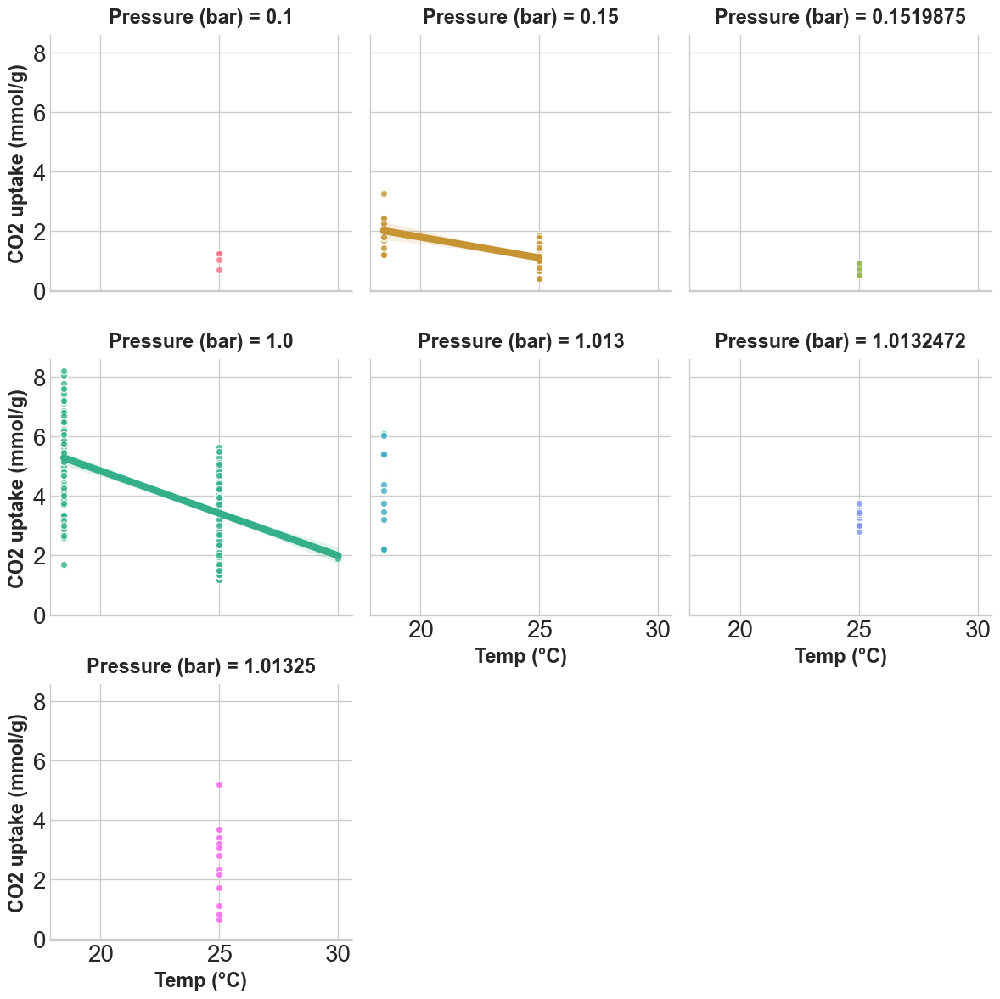

In [100]:
feature = "Temp (°C)"

sns.lmplot(
    x=feature, y="CO2 uptake (mmol/g)", hue="Pressure (bar)", col="Pressure (bar)",
    data=dss, scatter_kws={"edgecolor": 'w'}, col_wrap=3, height=4,
);

## Outliers are checked but, all of them kept for preventing  data lossing 

(526, 10)


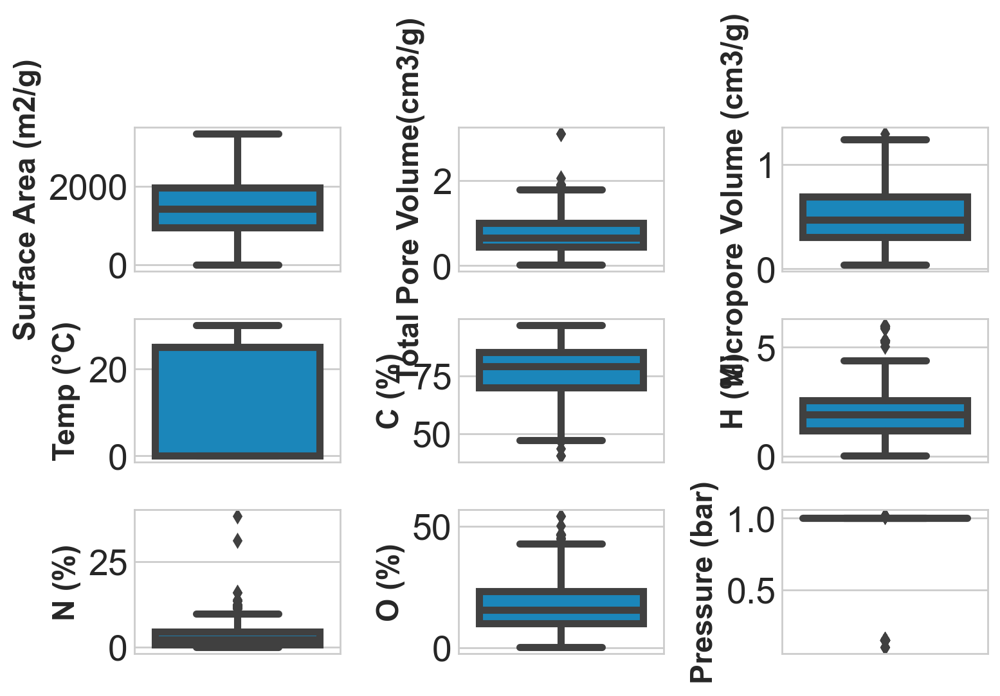

In [101]:
plt.figure(figsize=(8,6),dpi=200);

ax=plt.subplot(4,3,1);
sns.boxplot(y=ds0['Surface Area (m2/g)']);

ax=plt.subplot(4,3,2);
sns.boxplot(y=ds0['Total Pore Volume(cm3/g)']);

ax=plt.subplot(4,3,3)
sns.boxplot(y=ds0['Micropore Volume (cm3/g)']);

ax=plt.subplot(4,3,4);
sns.boxplot(y=ds0['Temp (°C)']);

ax=plt.subplot(4,3,5);
sns.boxplot(y=ds0['C (%)']);

ax=plt.subplot(4,3,6);
sns.boxplot(y=ds0['H (%)']);

ax=plt.subplot(4,3,7);
sns.boxplot(y=ds0['N (%)']);

ax=plt.subplot(4,3,8);
sns.boxplot(y=ds0['O (%)']);


ax=plt.subplot(4,3,9);
sns.boxplot(y=ds0['Pressure (bar)'])



plt.subplots_adjust(wspace=0.8);
plt.subplots_adjust(hspace=0.4);
print(ds0.shape)

plt.show();


Q11 = ds0['Surface Area (m2/g)'].quantile(0.05)
Q13 = ds0['Surface Area (m2/g)'].quantile(0.95)
IQR1 = Q13 - Q11

Q21 = ds0['Total Pore Volume(cm3/g)'].quantile(0.05)
Q23 = ds0['Total Pore Volume(cm3/g)'].quantile(0.95)
IQR2 = Q23 - Q21

Q31 = ds0['Micropore Volume (cm3/g)'].quantile(0.05)
Q33 = ds0['Micropore Volume (cm3/g)'].quantile(0.95)
IQR3 = Q33 - Q31

Q41 = ds0['Pressure (bar)'].quantile(0.05)
Q43 = ds0['Pressure (bar)'].quantile(0.95)
IQR4 = Q43 - Q41


shape of dataset after removing outliers (524, 10)
(524, 10)


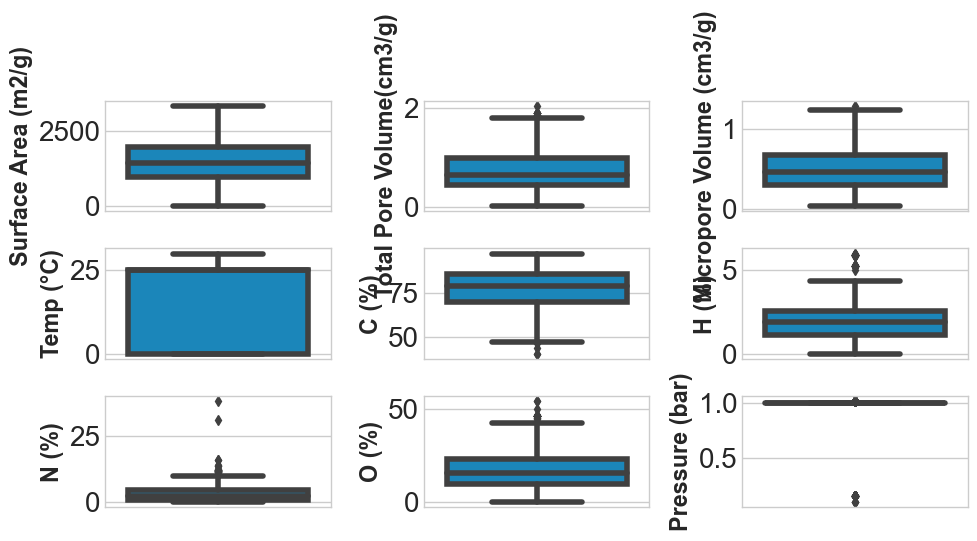

In [102]:
new_df = ds0[
        #(ds0['Surface Area (m2/g)'] > Q11-IQR1 ) & (ds0['Surface Area (m2/g)'] < Q13+IQR1 )&  
         (ds0['Total Pore Volume(cm3/g)'] > Q21-IQR2) & (ds0['Total Pore Volume(cm3/g)'] < Q23+IQR2)&
         (ds0['Micropore Volume (cm3/g)'] > Q31 -IQR3) & (ds0['Micropore Volume (cm3/g)'] < Q33+IQR3)&
         (ds0['Pressure (bar)'] > Q41 -IQR4) & (ds0['Pressure (bar)'] < Q43+IQR4)]#&

print('shape of dataset after removing outliers',new_df.shape)


plt.figure(figsize=(10,6),dpi=100)

ax=plt.subplot(4,3,1)
sns.boxplot(y=new_df['Surface Area (m2/g)'])

ax=plt.subplot(4,3,2)
sns.boxplot(y=new_df['Total Pore Volume(cm3/g)'])

ax=plt.subplot(4,3,3)
sns.boxplot(y=new_df['Micropore Volume (cm3/g)'])

ax=plt.subplot(4,3,4)
sns.boxplot(y=new_df['Temp (°C)'])

ax=plt.subplot(4,3,5)
sns.boxplot(y=new_df['C (%)'])

ax=plt.subplot(4,3,6)
sns.boxplot(y=new_df['H (%)'])

ax=plt.subplot(4,3,7)
sns.boxplot(y=new_df['N (%)'])

ax=plt.subplot(4,3,8)
sns.boxplot(y=new_df['O (%)'])

ax=plt.subplot(4,3,9)
sns.boxplot(y=new_df['Pressure (bar)'])


plt.subplots_adjust(wspace=0.8)
plt.subplots_adjust(hspace=0.4)
print(new_df.shape)

plt.show()


# dataset after adding newfeature and feature selection

In [103]:
def split_datasets(dataset,size):
    print(dataset.shape)
    x=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']

    df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)

    print('shape of train set is:      ',df_train.shape)
    print('shape of train label set is:',df_label.shape)
    print()
    print('shape of test set is:      ',df_test.shape)
    print('shape of test label set is:',df_test_label.shape)
    return df_train,df_test,df_label,df_test_label

30
(526, 30)


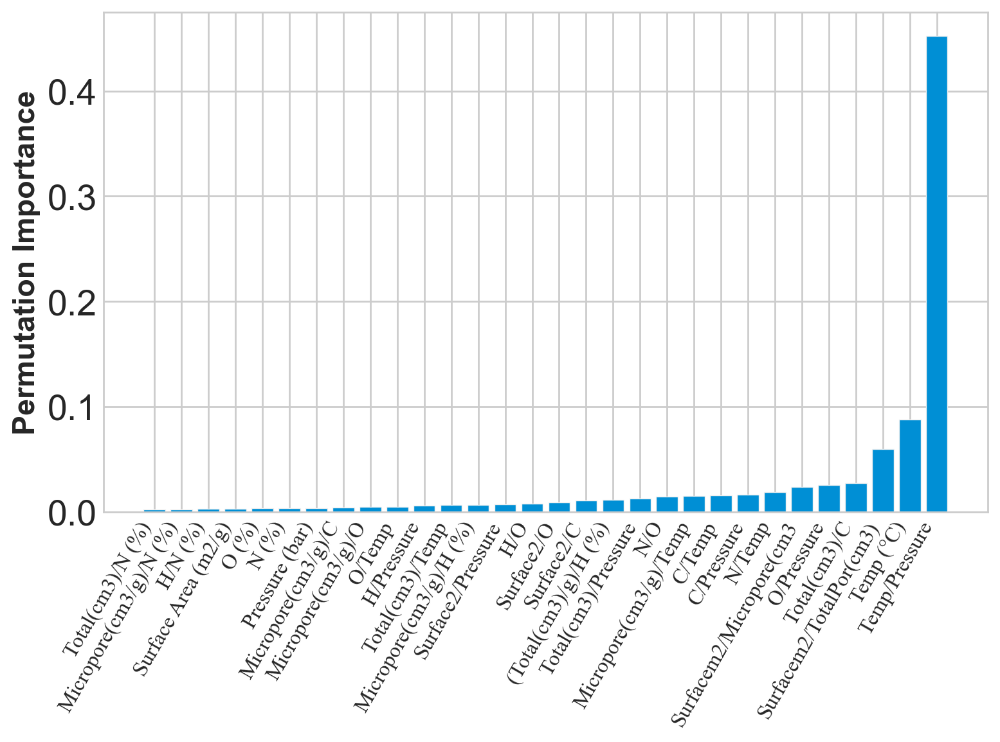

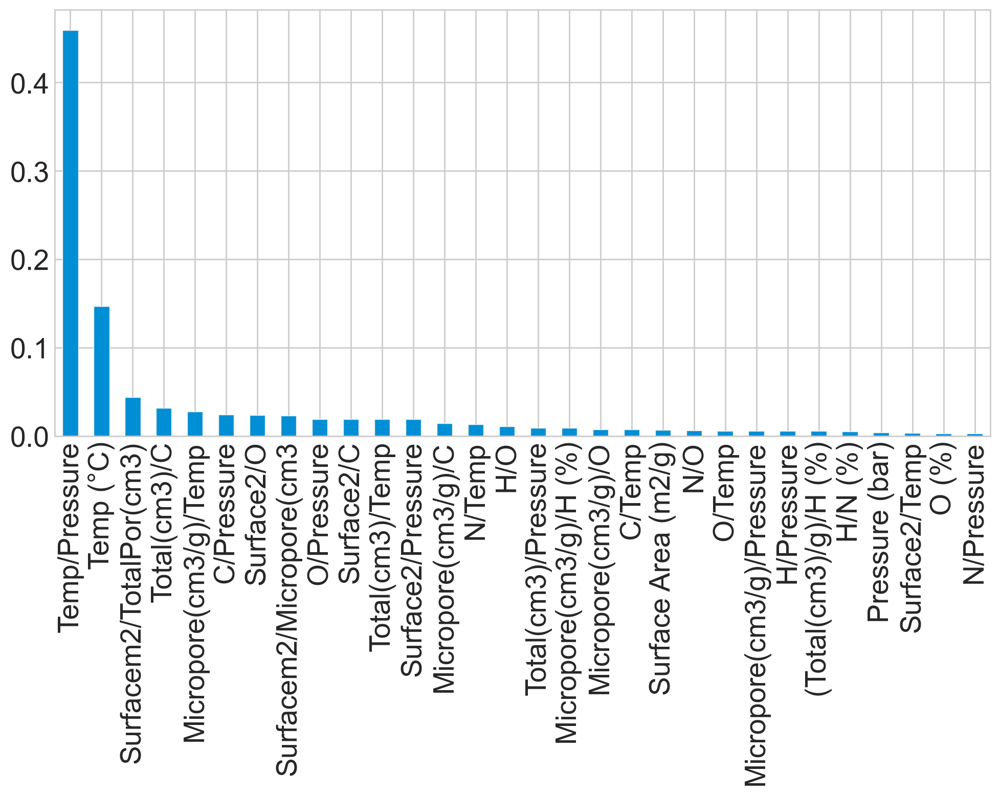

In [104]:
features_dss,imp_sorted_index=importance_features(dss)
print(len(features_dss))
dff=dss[features_dss]
print(dff.shape)
dff['CO2 uptake (mmol/g)']=dss['CO2 uptake (mmol/g)']

x3=dff.drop(['CO2 uptake (mmol/g)'],axis=1)
y3=dss['CO2 uptake (mmol/g)']


30
(526, 30)


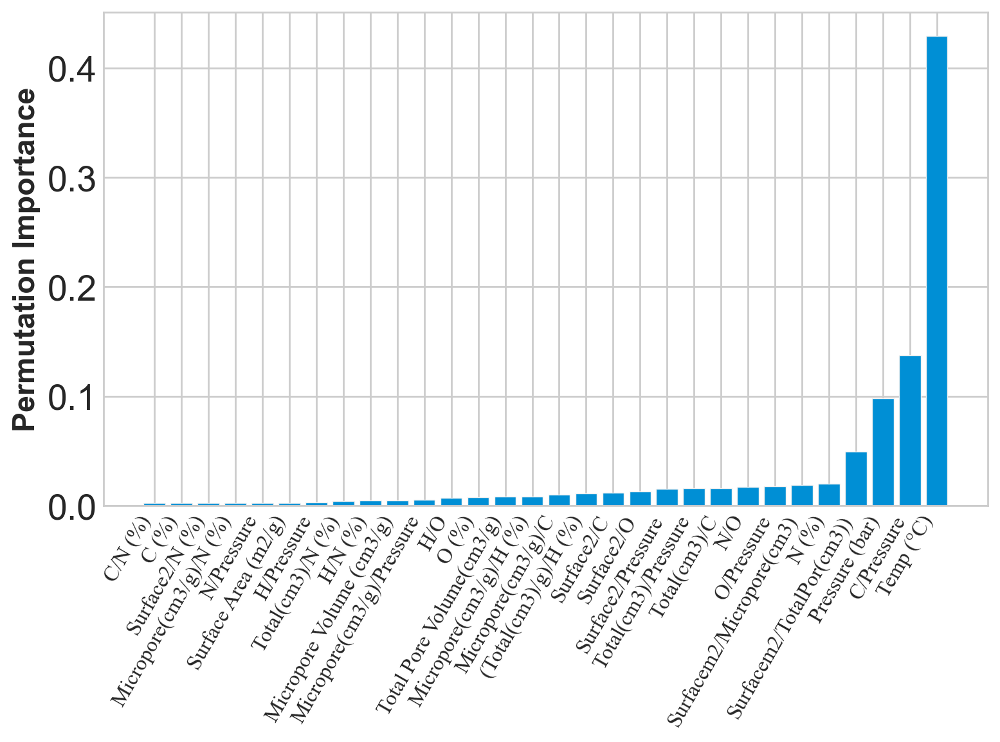

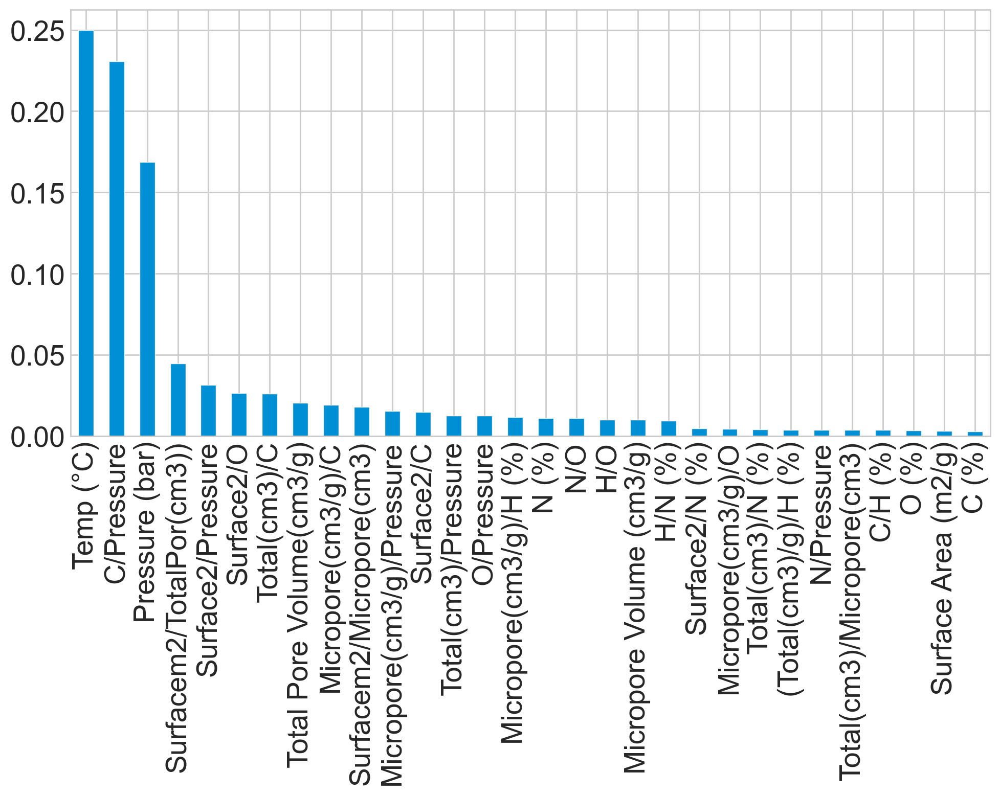

In [105]:
features_dss0,imp_sorted_index0=importance_features(dss0)
imp_sorted_index0
print(len(features_dss0))
dff0=dss0[features_dss0[-30:]]
print(dff0.shape)
dff0['CO2 uptake (mmol/g)']=dss0['CO2 uptake (mmol/g)']
x4=dff0.drop(['CO2 uptake (mmol/g)'],axis=1)
y4=dss0['CO2 uptake (mmol/g)']

## recrussive feature selection


In [106]:
#gbr=GradientBoostingRegressor(n_estimators=80)
gbr=GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1,
                          min_samples_split = 2, n_estimators = 300, subsample = 0.5)
def rfecv_feature(dataset,n,t):
    x=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    
    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    scaler_Min = scalers[n]#MinMaxScaler()
    
    x = scaler_Min.fit_transform(x)
    # X_test2= scaler_Min.fit_transform(X_test2)
    gbr=GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1,
                          min_samples_split = 2, n_estimators = 300, subsample = 0.5)
  

    df_trains,df_tests,df_labels,df_test_labels=train_test_split(x,y,test_size=.15, random_state=42)

    print('shape of train set is:      ',df_trains.shape)
    print('shape of train label set is:',df_labels.shape)
    print()
    print('shape of test set is:      ',df_tests.shape)
    print('shape of test label set is:',df_test_labels.shape)

    regressor_names=['gbr','rf']
    sg = LinearRegression()
    rf=RandomForestRegressor(random_state =42)
    k_best1 = [9,12,15,18,22,26,30,34]
    k_best2 = [9,12,15,18,22,26,30,34,38,40,42,45]
    k_best=[k_best1,k_best2]
    
    fig, axs = plt.subplots(1, 2, figsize=(12,5))
    cv = RepeatedKFold(n_splits=5, n_repeats=10, random_state=321)

    mean_score = {}
    for i, regressor in enumerate([gbr, rf]):
      scores = []
      for k in k_best[t]:
          sel = SelectKBest(score_func=f_regression, k=k)
          _X = sel.fit_transform(x, y.values.ravel())
          score = cross_val_score(regressor, _X, y, scoring="r2", cv=cv, n_jobs=-1)
          scores.append(score)
          mean_score[regressor_names[i]+'-'+str(k)] = np.mean(score)
      scores = pd.DataFrame(scores).T
      scores.boxplot(ax=axs[i], grid=False)
      axs[i].set_title(regressor_names[i])
      axs[i].set_ylabel('r2 score')
      axs[i].set_xlabel('K-best features')
      axs[i].set_xticklabels(k_best[0])

    plt.show()
    print("The mean r2-scores are:")
    for name, score in sorted(mean_score.items(), key=lambda item: item[1]):
      print(str(name)+" features:\t", score)
        
    
    
 

In [107]:
#rfecv_feature(dss0,4,0)

In [108]:
def rfecv_sel(dataset,n):
    x=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    xx=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    
    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    scaler_Min = scalers[n]  #MinMaxScaler()
    
    x = scaler_Min.fit_transform(x)
    gbr=GradientBoostingRegressor(learning_rate= 0.05, max_depth = 4, min_samples_leaf = 1,
                          min_samples_split = 2, random_state=42, n_estimators = 300, subsample = 0.5)
  
    rfecv = RFECV(estimator=gbr, step=1, scoring='neg_mean_squared_error')

    # Fit recursive feature eliminator 
    rfecv.fit(x, y)

    X_new = rfecv.transform(x)
    print("Num Features Before:", x.shape[1])
    print("Num Features After:", X_new.shape[1])
    
    #print(x.columns.shape)
    print(rfecv.support_.shape)
    features_kept = pd.DataFrame({'columns': xx.columns,'Kept': rfecv.support_})
    print(features_kept)
    
    last_columns=features_kept['columns'][features_kept['Kept']==True]
    print(last_columns)
    
    X_new_df = xx.iloc[:, rfecv.support_]
    print(X_new_df.shape)
    
    X_new_df['CO2 uptake (mmol/g)']=dataset['CO2 uptake (mmol/g)']
    
    yr=X_new_df['CO2 uptake (mmol/g)']
    xr=X_new_df.drop(['CO2 uptake (mmol/g)'],axis=1)
    print(rfecv.n_features_)
    print(rfecv.get_support(indices=True))
  
    return xr,yr,X_new_df

In [109]:
xrs01,yrs01,X_new_dfs01=rfecv_sel(dss0,1)

Num Features Before: 37
Num Features After: 28
(37,)
                      columns   Kept
0         Surface Area (m2/g)   True
1    Total Pore Volume(cm3/g)   True
2    Micropore Volume (cm3/g)   True
3                       C (%)  False
4                       H (%)  False
5                       N (%)   True
6                       O (%)  False
7                   Temp (°C)   True
8              Pressure (bar)   True
9    Surfacem2/TotalPor(cm3))   True
10   Surfacem2/Micropore(cm3)   True
11                 Surface2/C   True
12             Surface2/H (%)  False
13             Surface2/N (%)   True
14                 Surface2/O   True
15          Surface2/Pressure   True
16  Total(cm3)/Micropore(cm3)   True
17               Total(cm3)/C   True
18       (Total(cm3)/g)/H (%)   True
19           Total(cm3)/N (%)  False
20               Total(cm3)/O  False
21        Total(cm3)/Pressure   True
22         Micropore(cm3/g)/C   True
23     Micropore(cm3/g)/H (%)   True
24     Micropore(cm3/g

In [110]:
X_new_dfs01

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),N (%),Temp (°C),Pressure (bar),Surfacem2/TotalPor(cm3)),Surfacem2/Micropore(cm3),Surface2/C,Surface2/N (%),...,Micropore(cm3/g)/O,Micropore(cm3/g)/Pressure,C/Pressure,H/N (%),H/O,H/Pressure,N/O,N/Pressure,O/Pressure,CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,0.0800,25,1.0000,1805.0704,4005.0000,18.5149,16020.0000,...,0.0122,0.3200,69.2200,49.8750,0.1517,3.9900,0.0030,0.0800,26.3000,2.6250
1,1012.6000,0.5600,0.2200,0.3800,25,1.0000,1808.2143,4602.7273,15.6193,2664.7368,...,0.0071,0.2200,64.8300,9.5789,0.1183,3.6400,0.0123,0.3800,30.7700,2.5864
2,1408.8000,0.8300,0.3600,0.0100,25,1.0000,1697.3494,3913.3333,19.4559,140880.0000,...,0.0153,0.3600,72.4100,363.0000,0.1539,3.6300,0.0004,0.0100,23.5900,2.9205
3,1403.9000,0.8500,0.3300,0.7600,25,1.0000,1651.6471,4254.2424,20.1971,1847.2368,...,0.0132,0.3300,69.5100,5.7237,0.1744,4.3500,0.0305,0.7600,24.9400,2.4386
4,841.3000,0.3600,0.3049,31.0900,25,1.0000,2336.9444,2759.2653,12.2943,27.0601,...,0.6352,0.3049,68.4300,0.1399,9.0625,4.3500,64.7708,31.0900,0.4800,3.2300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
521,2230.0000,1.0300,0.8900,0.4000,25,0.1500,2165.0485,2505.6180,25.7803,5575.0000,...,0.0748,5.9333,576.6667,5.2750,0.1773,14.0667,0.0336,2.6667,79.3333,0.9800
522,1950.0000,0.8800,0.7200,0.4000,25,0.1500,2215.9091,2708.3333,22.9953,4875.0000,...,0.0605,4.8000,565.3333,5.2750,0.1773,14.0667,0.0336,2.6667,79.3333,1.1400
523,1230.0000,0.9000,0.2292,8.3300,0,1.0000,1366.6667,5366.4921,18.5213,147.6591,...,0.0091,0.2292,66.4100,0.2533,0.0835,2.1100,0.3298,8.3300,25.2600,5.1400
524,2380.0000,1.6400,0.6988,4.9400,0,1.0000,1451.2195,3405.8386,30.5402,481.7814,...,0.0408,0.6988,77.9300,0.4271,0.1232,2.1100,0.2884,4.9400,17.1300,5.4500


In [111]:
xrs04,yrs04,X_new_dfs04=rfecv_sel(dss0,4)

Num Features Before: 37
Num Features After: 36
(37,)
                      columns   Kept
0         Surface Area (m2/g)   True
1    Total Pore Volume(cm3/g)   True
2    Micropore Volume (cm3/g)   True
3                       C (%)   True
4                       H (%)   True
5                       N (%)   True
6                       O (%)   True
7                   Temp (°C)   True
8              Pressure (bar)   True
9    Surfacem2/TotalPor(cm3))   True
10   Surfacem2/Micropore(cm3)   True
11                 Surface2/C   True
12             Surface2/H (%)   True
13             Surface2/N (%)   True
14                 Surface2/O   True
15          Surface2/Pressure   True
16  Total(cm3)/Micropore(cm3)   True
17               Total(cm3)/C   True
18       (Total(cm3)/g)/H (%)   True
19           Total(cm3)/N (%)   True
20               Total(cm3)/O   True
21        Total(cm3)/Pressure   True
22         Micropore(cm3/g)/C   True
23     Micropore(cm3/g)/H (%)   True
24     Micropore(cm3/g

In [112]:
xrs1,yrs1,X_new_dfs1=rfecv_sel(dss,1)

Num Features Before: 45
Num Features After: 28
(45,)
                      columns   Kept
0         Surface Area (m2/g)  False
1    Total Pore Volume(cm3/g)  False
2    Micropore Volume (cm3/g)  False
3                       C (%)  False
4                       H (%)  False
5                       N (%)  False
6                       O (%)  False
7                   Temp (°C)  False
8              Pressure (bar)  False
9     Surfacem2/TotalPor(cm3)   True
10    Surfacem2/Micropore(cm3   True
11                 Surface2/C   True
12             Surface2/H (%)  False
13             Surface2/N (%)   True
14                 Surface2/O   True
15              Surface2/Temp   True
16          Surface2/Pressure   True
17  Total(cm3)/Micropore(cm3)   True
18               Total(cm3)/C   True
19       (Total(cm3)/g)/H (%)   True
20           Total(cm3)/N (%)  False
21               Total(cm3)/O   True
22            Total(cm3)/Temp   True
23        Total(cm3)/Pressure   True
24         Micropore(c

In [113]:
X_new_dfs1

,Surfacem2/TotalPor(cm3),Surfacem2/Micropore(cm3,Surface2/C,Surface2/N (%),Surface2/O,Surface2/Temp,Surface2/Pressure,Total(cm3)/Micropore(cm3),Total(cm3)/C,(Total(cm3)/g)/H (%),...,H/N (%),H/O,H/Pressure,N/O,N/Temp,N/Pressure,O/Temp,O/Pressure,Temp/Pressure,CO2 uptake (mmol/g)
0,1805.0704,4005.0000,18.5149,16020.0000,48.7300,51.2640,1281.6000,2.2188,0.0103,0.1779,...,49.8750,0.1517,3.9900,0.0030,0.0032,0.0800,1.0520,26.3000,25.0000,2.6250
1,1808.2143,4602.7273,15.6193,2664.7368,32.9087,40.5040,1012.6000,2.5455,0.0086,0.1538,...,9.5789,0.1183,3.6400,0.0123,0.0152,0.3800,1.2308,30.7700,25.0000,2.5864
2,1697.3494,3913.3333,19.4559,140880.0000,59.7202,56.3520,1408.8000,2.3056,0.0115,0.2287,...,363.0000,0.1539,3.6300,0.0004,0.0004,0.0100,0.9436,23.5900,25.0000,2.9205
3,1651.6471,4254.2424,20.1971,1847.2368,56.2911,56.1560,1403.9000,2.5758,0.0122,0.1954,...,5.7237,0.1744,4.3500,0.0305,0.0304,0.7600,0.9976,24.9400,25.0000,2.4386
4,2336.9444,2759.2653,12.2943,27.0601,1752.7083,33.6520,841.3000,1.1807,0.0053,0.0828,...,0.1399,9.0625,4.3500,64.7708,1.2436,31.0900,0.0192,0.4800,25.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
521,2165.0485,2505.6180,25.7803,5575.0000,187.3950,89.2000,14866.6667,1.1573,0.0119,0.4882,...,5.2750,0.1773,14.0667,0.0336,0.0160,2.6667,0.4760,79.3333,166.6667,0.9800
522,2215.9091,2708.3333,22.9953,4875.0000,163.8655,78.0000,13000.0000,1.2222,0.0104,0.4171,...,5.2750,0.1773,14.0667,0.0336,0.0160,2.6667,0.4760,79.3333,166.6667,1.1400
523,1366.6667,5366.4921,18.5213,147.6591,48.6936,66.6646,1230.0000,3.9267,0.0136,0.4265,...,0.2533,0.0835,2.1100,0.3298,0.4515,8.3300,1.3691,25.2600,18.4506,5.1400
524,1451.2195,3405.8386,30.5402,481.7814,138.9375,128.9933,2380.0000,2.3469,0.0210,0.7773,...,0.4271,0.1232,2.1100,0.2884,0.2677,4.9400,0.9284,17.1300,18.4506,5.4500


In [114]:
xrs4,yrs4,X_new_dfs4=rfecv_sel(dss,4)

Num Features Before: 45
Num Features After: 40
(45,)
                      columns   Kept
0         Surface Area (m2/g)   True
1    Total Pore Volume(cm3/g)   True
2    Micropore Volume (cm3/g)   True
3                       C (%)   True
4                       H (%)  False
5                       N (%)  False
6                       O (%)  False
7                   Temp (°C)   True
8              Pressure (bar)   True
9     Surfacem2/TotalPor(cm3)   True
10    Surfacem2/Micropore(cm3   True
11                 Surface2/C   True
12             Surface2/H (%)  False
13             Surface2/N (%)   True
14                 Surface2/O   True
15              Surface2/Temp   True
16          Surface2/Pressure   True
17  Total(cm3)/Micropore(cm3)   True
18               Total(cm3)/C   True
19       (Total(cm3)/g)/H (%)   True
20           Total(cm3)/N (%)   True
21               Total(cm3)/O   True
22            Total(cm3)/Temp   True
23        Total(cm3)/Pressure   True
24         Micropore(c

In [115]:
X_new_dfs4

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),Temp (°C),Pressure (bar),Surfacem2/TotalPor(cm3),Surfacem2/Micropore(cm3,Surface2/C,Surface2/N (%),...,H/O,H/Temp,H/Pressure,N/O,N/Temp,N/Pressure,O/Temp,O/Pressure,Temp/Pressure,CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,25.0000,1.0000,1805.0704,4005.0000,18.5149,16020.0000,...,0.1517,0.1596,3.9900,0.0030,0.0032,0.0800,1.0520,26.3000,25.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,25.0000,1.0000,1808.2143,4602.7273,15.6193,2664.7368,...,0.1183,0.1456,3.6400,0.0123,0.0152,0.3800,1.2308,30.7700,25.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,25.0000,1.0000,1697.3494,3913.3333,19.4559,140880.0000,...,0.1539,0.1452,3.6300,0.0004,0.0004,0.0100,0.9436,23.5900,25.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,25.0000,1.0000,1651.6471,4254.2424,20.1971,1847.2368,...,0.1744,0.1740,4.3500,0.0305,0.0304,0.7600,0.9976,24.9400,25.0000,2.4386
4,841.3000,0.3600,0.3049,68.4300,25.0000,1.0000,2336.9444,2759.2653,12.2943,27.0601,...,9.0625,0.1740,4.3500,64.7708,1.2436,31.0900,0.0192,0.4800,25.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
521,2230.0000,1.0300,0.8900,86.5000,25.0000,0.1500,2165.0485,2505.6180,25.7803,5575.0000,...,0.1773,0.0844,14.0667,0.0336,0.0160,2.6667,0.4760,79.3333,166.6667,0.9800
522,1950.0000,0.8800,0.7200,84.8000,25.0000,0.1500,2215.9091,2708.3333,22.9953,4875.0000,...,0.1773,0.0844,14.0667,0.0336,0.0160,2.6667,0.4760,79.3333,166.6667,1.1400
523,1230.0000,0.9000,0.2292,66.4100,18.4506,1.0000,1366.6667,5366.4921,18.5213,147.6591,...,0.0835,0.1144,2.1100,0.3298,0.4515,8.3300,1.3691,25.2600,18.4506,5.1400
524,2380.0000,1.6400,0.6988,77.9300,18.4506,1.0000,1451.2195,3405.8386,30.5402,481.7814,...,0.1232,0.1144,2.1100,0.2884,0.2677,4.9400,0.9284,17.1300,18.4506,5.4500


In [116]:
dss0_shuffled = shuffle(dss0)

dss_shuffled = shuffle(dss)

df0_shuffled = shuffle(df0)

df_shuffled = shuffle(df)

dff_shuffled = shuffle(dff)

dff0_shuffled = shuffle(dff0)

X_new_dfs01_shuffled = shuffle(X_new_dfs01)

X_new_dfs04_shuffled = shuffle(X_new_dfs04)

X_new_dfs1_shuffled = shuffle(X_new_dfs1)

X_new_dfs4_shuffled = shuffle(X_new_dfs4)

# Comparison of performance of different models with different scalers

In [117]:
def com_per_models(dataset):
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]
    
    models=[LinearRegression(),RandomForestRegressor(random_state=42),gbr]
    models_names = ['Linear', 'RF','GBR']
    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]

    scalers_names = ['Row data', 'MinMax', 'MaxAbs', 'Robust', 'SS','Quantile']

    fig, axs = plt.subplots(figsize=(8,6),dpi=150)
    results = {}
    for j in range(len(models)):
        for k in range(len(scalers)):
            if scalers[k]:
                X_scaled = scalers[k].fit_transform(x)
            else:
                X_scaled = x
            
            cv = RepeatedKFold(n_splits=5, n_repeats=10, random_state=42)
            scores = cross_val_score(models[j], X_scaled, y, scoring='r2', cv=cv, n_jobs=1)
            results[f'{models_names[j]}-{scalers_names[k]}'] = scores

    df_res0 = pd.DataFrame(results).copy()
    df_res0.boxplot(rot=45)
    axs.set_ylabel("r$^2$ score")
    plt.xticks(ha='right')
    plt.show()
    return df_res0

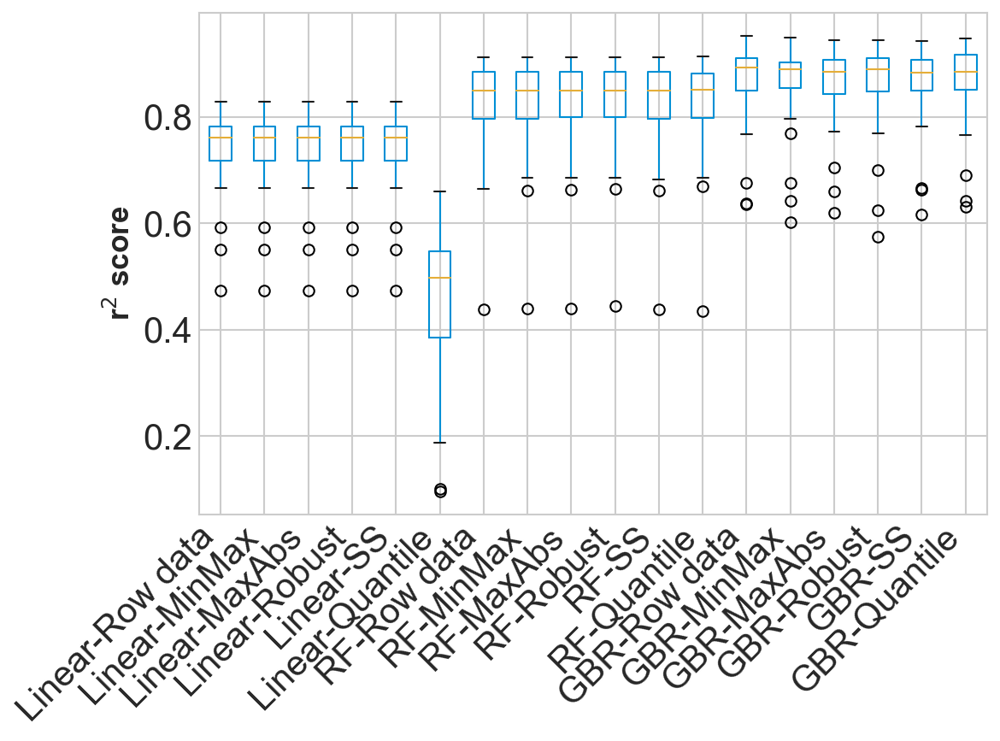

In [118]:
df_res0=com_per_models(df_first)

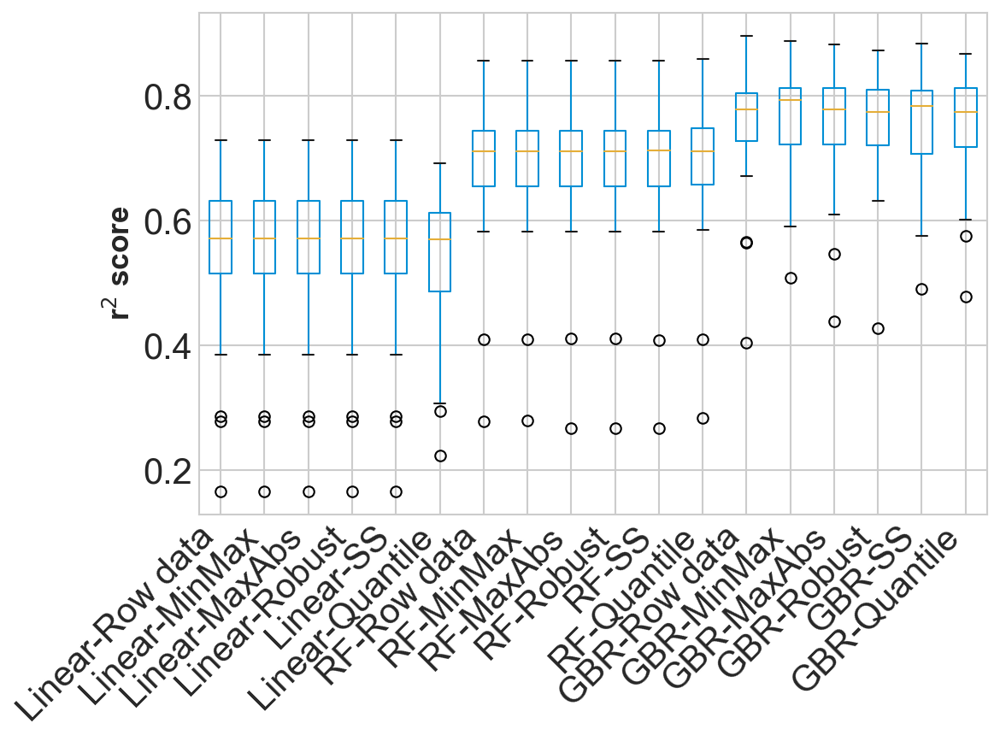

In [119]:
df_res0=com_per_models(df_second)

In [120]:
def skew_map(data):
    for column in data.columns:
        print(column)
        df_check = data[column].map(lambda i: np.log(i) if i > 0 else 0) 
        print(df_check.skew())
        print(df_check.skew())

In [121]:
skew_map(df_first)

Surface Area (m2/g)
-3.6230553438917137
-3.6230553438917137
Total Pore Volume(cm3/g)
-1.3521406338900097
-1.3521406338900097
Micropore Volume (cm3/g)
-0.6568104172271924
-0.6568104172271924
C (%)
-1.01033243632383
-1.01033243632383
H (%)
-2.343775294864554
-2.343775294864554
N (%)
-0.2689498085823247
-0.2689498085823247
O (%)
-1.3556076974178077
-1.3556076974178077
Temp (°C)
-0.6715091092073039
-0.6715091092073039
Pressure (bar)
-1.0045293278891376
-1.0045293278891376
CO2 uptake (mmol/g)
-0.6615224503746184
-0.6615224503746184


## Scaler effect

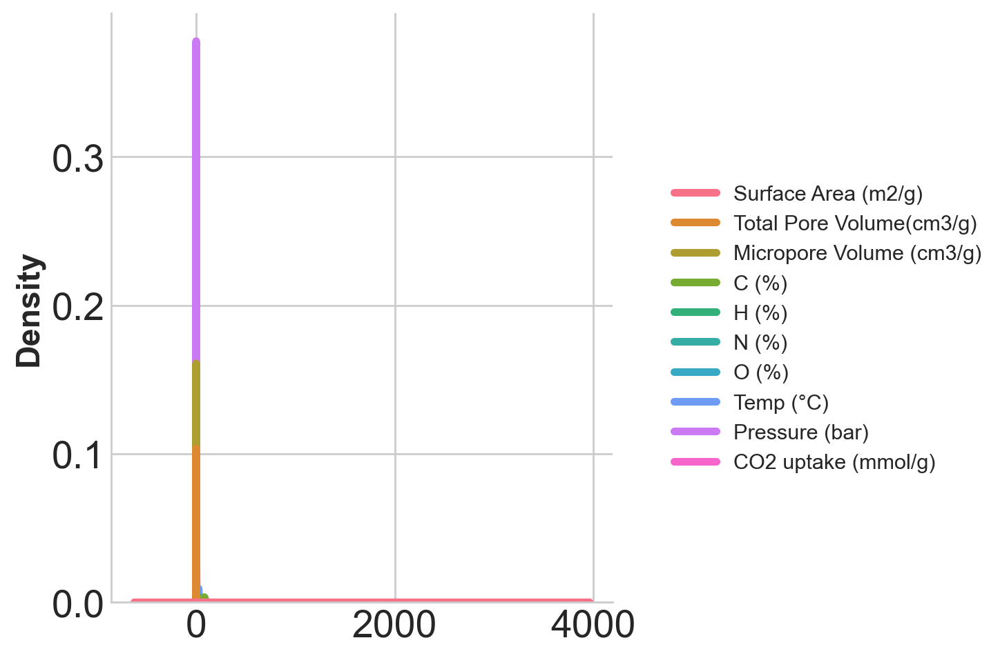

In [122]:
p=sns.displot(df_0, kind="kde")
p.fig.set_dpi(200)


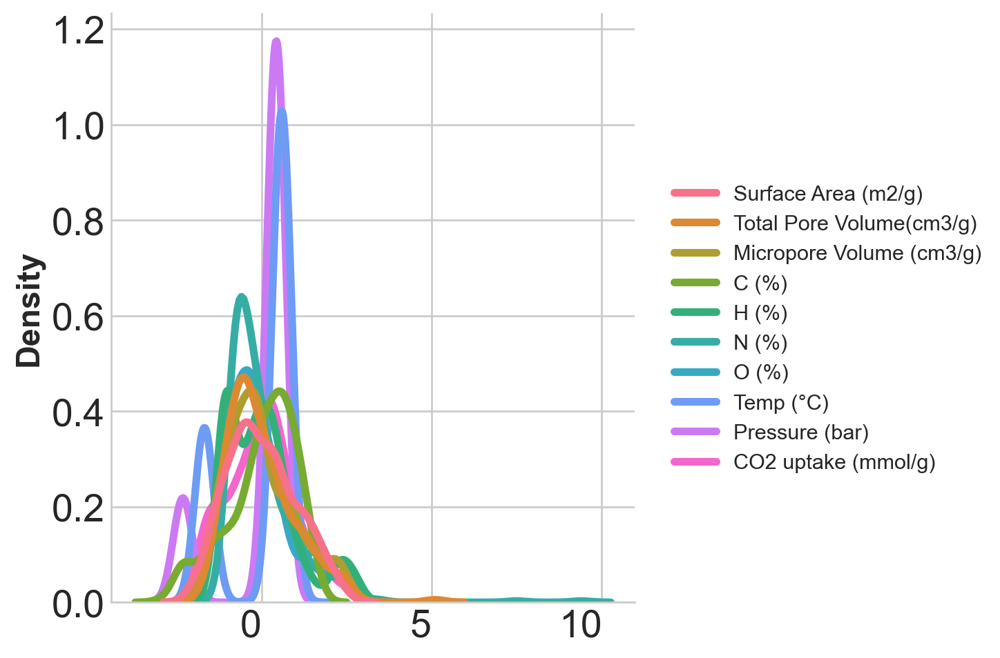

In [123]:
df_0_scaled = StandardScaler().fit_transform(df_0)

df_0_scaled = pd.DataFrame(df_0_scaled, columns=df_0.columns)

p_all = sns.displot(df_0_scaled, kind="kde", common_norm=False)

p_all.fig.set_dpi(200)

plt.xticks(rotation=0, ha='right')

plt.show()

# GBR results for new datasets

## modified GBR on first set of collected original dataset

In [124]:
def split_datasets(dataset,size):
    print(dataset.shape)
    x=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']

    df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)

    print('shape of train set is:      ',df_train.shape)
    print('shape of train label set is:',df_label.shape)
    print()
    print('shape of test set is:      ',df_test.shape)
    print('shape of test label set is:',df_test_label.shape)
    return df_train,df_test,df_label,df_test_label


In [125]:
def best_par_gbr(data,size):
    results={}
    df_train,df_test,df_label,df_test_label=split_datasets(data,size)

    for i in [0.5,0.1, 0.01, 0.001]:
        for j in [100, 250, 500, 750]:
            for k in [2, 4, 6]:
                
            
                gbr = GradientBoostingRegressor(learning_rate= i, max_depth = k, min_samples_leaf = 1,
                                  min_samples_split = 2, n_estimators = j,
                                  subsample = 0.5, random_state=42)
                #GradientBoostingRegressor(learning_rate=i, n_estimators=j)
                gbr = gbr.fit(df_train, df_label)
                print("predict output for GradientBoostingRegressor: learning_rate={}, n_estimators={},max_depth = {}".format(i, j,k))
                mse = mean_squared_error(df_test_label, gbr.predict(df_test))
                print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
                scores=gbr.score(df_test, df_test_label)
                pred2 = gbr.predict(df_test)
                print("Accuracy on training set: %.3f" % gbr.score(df_train, df_label))
                print("Accuracy on test set: %.3f" % scores)
                print("==============================================")
                results[f'{i}-{j}-{k}'] = scores

    df_scores = pd.DataFrame(results, index=[0]).copy()
    return results,df_scores


In [126]:
def best_par_gbr2(dataset,fold,size):
    '''finding best parameters for each dataset'''
    results={}
    x=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)

    for i in [0.01, 0.05, 0.1]:
        for j in [300, 500, 700,750,800]:
            for k in [3, 4, 5, 6]:
                
            
                gbr = GradientBoostingRegressor(learning_rate= i, max_depth = k, min_samples_leaf = 1,
                                  min_samples_split = 2, n_estimators = j,
                                  subsample = 0.5, random_state=42)
                #GradientBoostingRegressor(learning_rate=i, n_estimators=j)
                gbr = gbr.fit(df_train, df_label)
                
                pred2 = gbr.predict(df_test)
                scores = cross_val_score(gbr, x, y , cv=fold, scoring='r2')
                
                
                print("predict output for GradientBoostingRegressor: learning_rate={}, n_estimators={},max_depth = {}".format(i, j,k))
                mse = mean_squared_error(df_test_label, gbr.predict(df_test))
                print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
                #scores=gbr.score(df_test, df_test_label)
                #pred2 = gbr.predict(df_test)
                #print("Accuracy on training set: %.3f" % pred2)
                print("mean on test set: %.3f" % scores.mean())
                print("std on test set: %.3f" % scores.std())

                print("==============================================")
                results[f'{i}-{j}-{k}'] = scores.mean()


    df_scores = pd.DataFrame(results, index=[0]).copy()

    return results,df_scores


In [127]:
results,df_scores=best_par_gbr2(dff_shuffled,5,.15)

predict output for GradientBoostingRegressor: learning_rate=0.01, n_estimators=300,max_depth = 3
The mean squared error (MSE) on test set: 0.4727
mean on test set: 0.771
std on test set: 0.030
predict output for GradientBoostingRegressor: learning_rate=0.01, n_estimators=300,max_depth = 4
The mean squared error (MSE) on test set: 0.4373
mean on test set: 0.786
std on test set: 0.028
predict output for GradientBoostingRegressor: learning_rate=0.01, n_estimators=300,max_depth = 5
The mean squared error (MSE) on test set: 0.4016
mean on test set: 0.790
std on test set: 0.029
predict output for GradientBoostingRegressor: learning_rate=0.01, n_estimators=300,max_depth = 6
The mean squared error (MSE) on test set: 0.4096
mean on test set: 0.792
std on test set: 0.026
predict output for GradientBoostingRegressor: learning_rate=0.01, n_estimators=500,max_depth = 3
The mean squared error (MSE) on test set: 0.4015
mean on test set: 0.801
std on test set: 0.026
predict output for GradientBoosting

predict output for GradientBoostingRegressor: learning_rate=0.05, n_estimators=750,max_depth = 6
The mean squared error (MSE) on test set: 0.3420
mean on test set: 0.825
std on test set: 0.026
predict output for GradientBoostingRegressor: learning_rate=0.05, n_estimators=800,max_depth = 3
The mean squared error (MSE) on test set: 0.3341
mean on test set: 0.841
std on test set: 0.019
predict output for GradientBoostingRegressor: learning_rate=0.05, n_estimators=800,max_depth = 4
The mean squared error (MSE) on test set: 0.3269
mean on test set: 0.836
std on test set: 0.029
predict output for GradientBoostingRegressor: learning_rate=0.05, n_estimators=800,max_depth = 5
The mean squared error (MSE) on test set: 0.3468
mean on test set: 0.828
std on test set: 0.027
predict output for GradientBoostingRegressor: learning_rate=0.05, n_estimators=800,max_depth = 6
The mean squared error (MSE) on test set: 0.3419
mean on test set: 0.825
std on test set: 0.026
predict output for GradientBoosting

In [128]:
max(df_scores.loc[0])
df_scores['0.1-750-6']
maxValueIndexObj = df_scores.idxmax(axis=1)
df_scores[maxValueIndexObj]

,0.05-800-3
0,0.8410


## Functions for compare

In [129]:
dff2=dff
dff2=dff2.assign(MP= dss['Micropore(cm3/g)/Pressure'],
                 TO=dss['Total(cm3)/O' ] ,
                 TN= dss['Total(cm3)/N (%)' ],
                 OT= dss['O/Temp' ],
                 CN= dss[ 'C/N (%)'], 
                 MH= dss[ 'Micropore(cm3/g)/H (%)'], 
                 MO= dss['Micropore(cm3/g)/O' ] ,
                 SH= dss['Surface2/H (%)' ] ,
                 CH= dss[ 'C/H (%)'] ,
                 MN= dss[ 'Micropore(cm3/g)/N (%)'] ,
                 TPV= dss['Total Pore Volume(cm3/g)' ])#,'22'=Total(cm3)/O])
dff2.shape

dff2_shuffled = shuffle(dff2)


dff02=dff0
dff02=dff02.assign(MP= dss0['Micropore(cm3/g)/Pressure'],
                 TO=dss0['Total(cm3)/O' ] ,
                 TN= dss0['Total(cm3)/N (%)' ],
#                  ff04= dss0['O/Temp' ],
                 CN= dss0[ 'C/N (%)'], 
                 MH= dss0[ 'Micropore(cm3/g)/H (%)'], 
                 MO= dss0['Micropore(cm3/g)/O' ] ,
                 SH= dss0['Surface2/H (%)' ] ,
                 CH= dss0[ 'C/H (%)'] ,
                 MN= dss0[ 'Micropore(cm3/g)/N (%)'] ,
                 TPV= dss0['Total Pore Volume(cm3/g)' ])#,'22'=Total(cm3)/O])
dff02.shape

dff02_shuffled = shuffle(dff02)

In [130]:
def generate_short_names(names, length=3):
    """
    Generate short names for features.

    :param names: List of feature names
    :param length: Length of short names
    :return: List of short names
    """
    short_names = [name[:length] for name in names]
    return short_names

In [131]:
df_0

,Surface Area (m2/g),Total Pore Volume(cm3/g),Micropore Volume (cm3/g),C (%),H (%),N (%),O (%),Temp (°C),Pressure (bar),CO2 uptake (mmol/g)
0,1281.6000,0.7100,0.3200,69.2200,3.9900,0.0800,26.3000,25,1.0000,2.6250
1,1012.6000,0.5600,0.2200,64.8300,3.6400,0.3800,30.7700,25,1.0000,2.5864
2,1408.8000,0.8300,0.3600,72.4100,3.6300,0.0100,23.5900,25,1.0000,2.9205
3,1403.9000,0.8500,0.3300,69.5100,4.3500,0.7600,24.9400,25,1.0000,2.4386
4,841.3000,0.3600,0.3049,68.4300,0.0000,31.0900,0.4800,25,1.0000,3.2300
...,...,...,...,...,...,...,...,...,...,...
522,2230.0000,1.0300,0.8900,86.5000,0.0000,0.4000,11.9000,25,0.1500,0.9800
523,1950.0000,0.8800,0.7200,84.8000,0.0000,0.4000,11.9000,25,0.1500,1.1400
524,1230.0000,0.9000,0.2292,66.4100,0.0000,8.3300,25.2600,0,1.0000,5.1400
525,2380.0000,1.6400,0.6988,77.9300,0.0000,4.9400,17.1300,0,1.0000,5.4500


In [132]:
def loss_GBR_ML(data, size):
    '''loss function using GBR'''
    X = data.drop('CO2 uptake (mmol/g)',axis=1) # assuming 'target' is the column you want to predict
    y = data['CO2 uptake (mmol/g)']
    gbr_params = {'learning_rate': 0.1, 'max_depth': 4, 'min_samples_leaf': 1,
                  'min_samples_split': 2, 'n_estimators': 750, 'subsample': 0.5}

    df_train, df_test, df_label, df_test_label = train_test_split(X,y,test_size=.15, random_state=42)
    sc = StandardScaler()
    X_train_std = sc.fit_transform(df_train)
    X_test_std = sc.transform(df_test)

    gbr = GradientBoostingRegressor(**gbr_params)

    # Compute cross-validated R2 scores
    cv_scores = cross_val_score(gbr, X_train_std, df_label, cv=7, scoring='r2')
    mean_cv_score = np.mean(cv_scores)
    std_cv_score = np.std(cv_scores)

    print("Mean cross-validated R2 score: %.2f" % (mean_cv_score * 100))
    print("Standard deviation of cross-validated R2 scores: %.2f" % (std_cv_score * 100))

    # Fit the model
    gbr.fit(X_train_std, df_label)

    # Initialize variables to store training and test losses
    train_score = np.zeros((gbr_params['n_estimators'],), dtype=np.float64)
    test_score = np.zeros((gbr_params['n_estimators'],), dtype=np.float64)

    # Calculate the training set loss at each boosting iteration
    for i, y_pred in enumerate(gbr.staged_predict(X_train_std)):
        train_score[i] = gbr.loss_(df_label, y_pred)

    # Calculate the test set loss at each boosting iteration
    y_test = df_test_label
    for i, y_pred in enumerate(gbr.staged_predict(X_test_std)):
        test_score[i] = gbr.loss_(y_test, y_pred)

    # Plot Deviance (Loss)
    fig = plt.figure(figsize=(8, 6), dpi=300)
    plt.subplot(1, 1, 1)
    #plt.title('Deviance')
    plt.plot(np.arange(gbr_params['n_estimators']) + 1, train_score, 'b-', label='Training Set Deviance')
    plt.plot(np.arange(gbr_params['n_estimators']) + 1, test_score, 'r-', label='Test Set Deviance')
    plt.legend(loc='upper right')
    plt.xlabel('Boosting Iterations', fontsize=16)
    plt.ylabel('Loss', fontsize=16)
    fig.tight_layout()
    plt.show()

    # Plot Feature Importance
    bhp = pd.DataFrame(df_train, columns=df_train.columns)
    feature_importance = gbr.feature_importances_
    sorted_idx = np.argsort(feature_importance)[-10:]
    pos = np.arange(sorted_idx.shape[0]) + .5
    fig = plt.figure(figsize=(8, 6), dpi=300)
    plt.barh(pos, feature_importance[sorted_idx], align='center')
    plt.yticks(pos, bhp.columns[sorted_idx], fontsize=16)
    plt.title('Feature Importance (MDI)')
    fig.tight_layout()
    plt.show()



Mean cross-validated R2 score: 80.70
Standard deviation of cross-validated R2 scores: 6.26


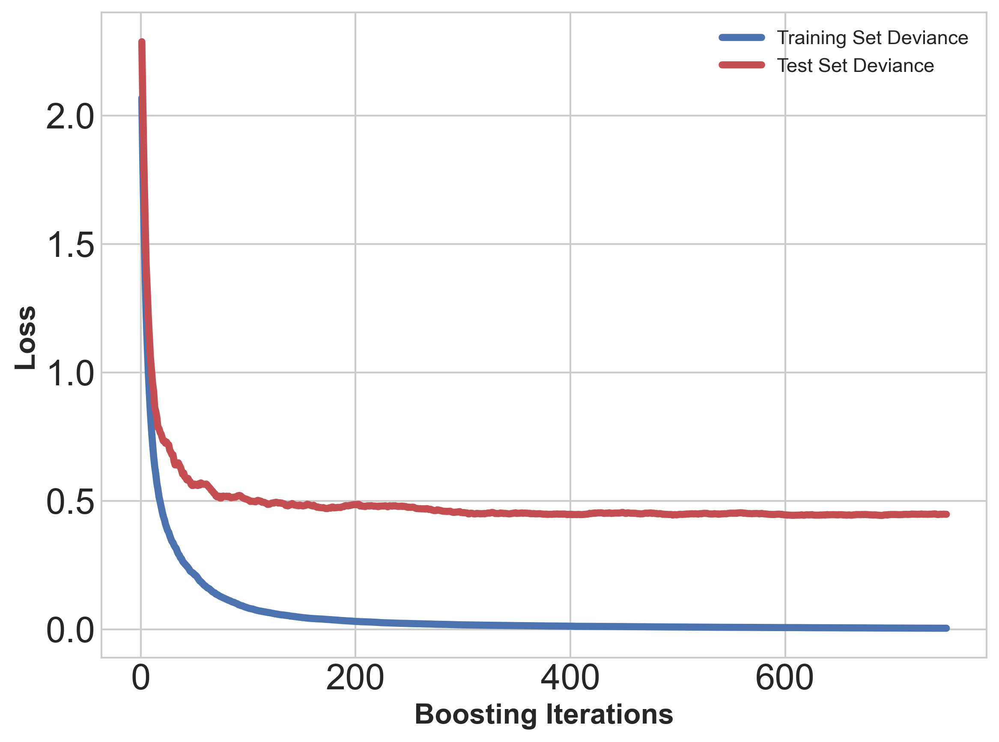

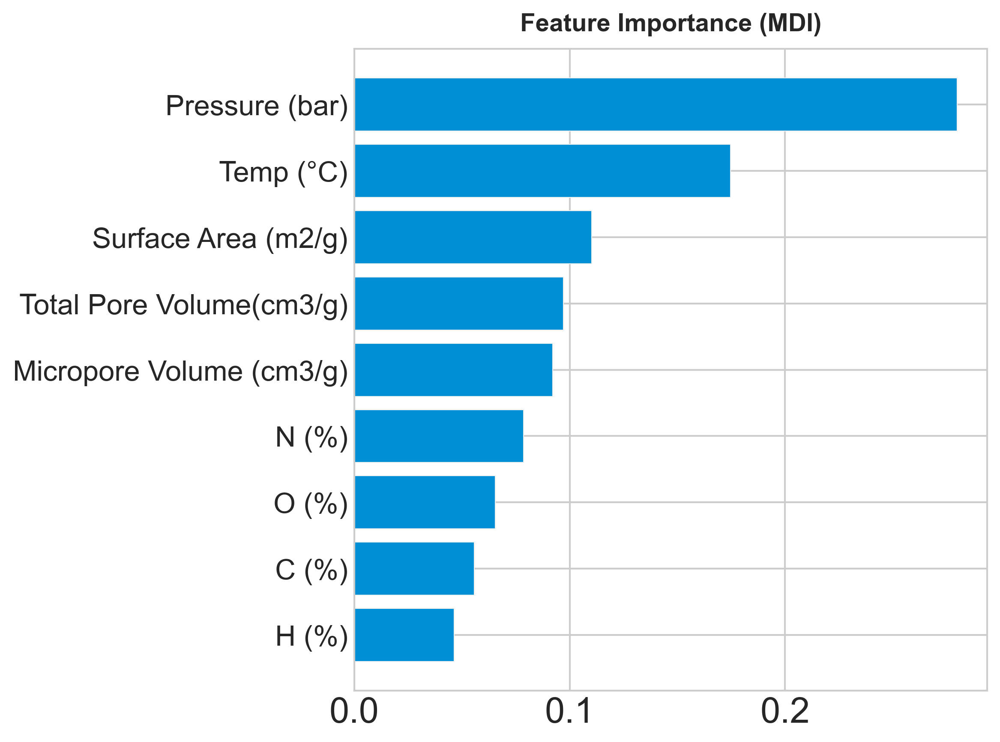

In [133]:
loss_GBR_ML(df_0,.15)

Mean cross-validated R2 score: 82.72
Standard deviation of cross-validated R2 scores: 4.66


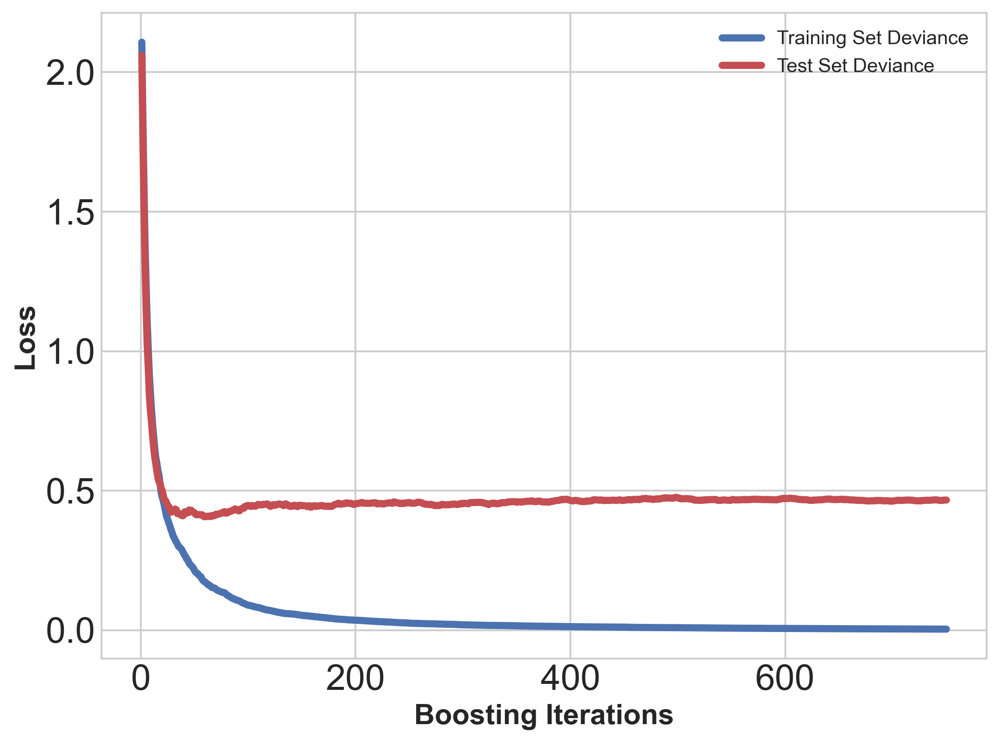

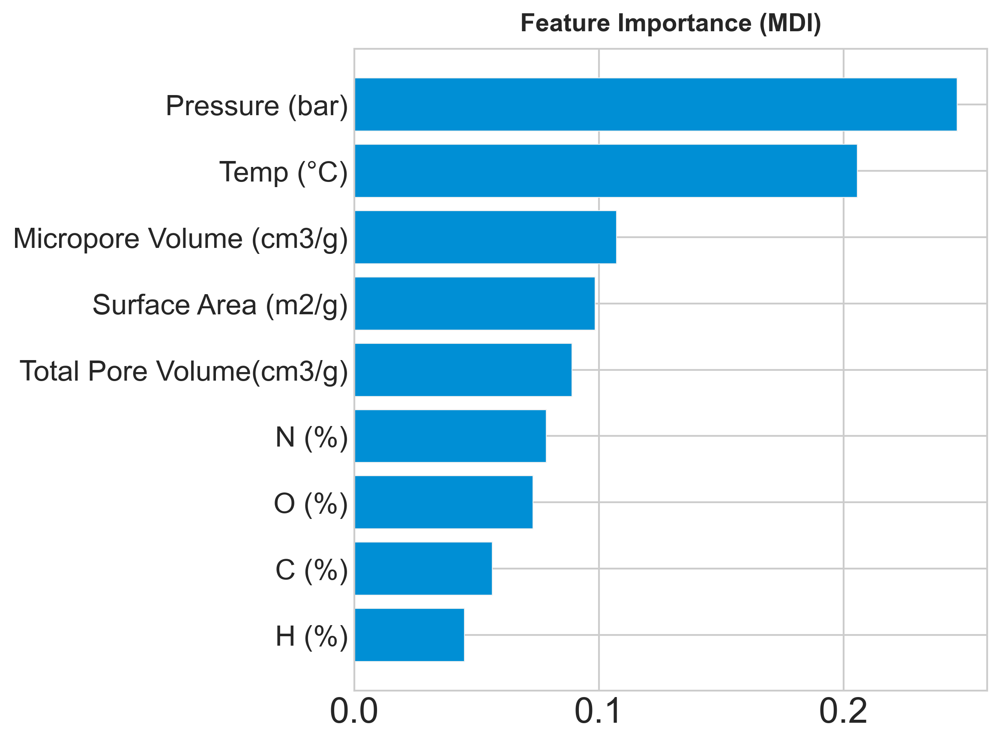

In [134]:
loss_GBR_ML(df_0_shuffled,.15)

Mean cross-validated R2 score: 84.26
Standard deviation of cross-validated R2 scores: 4.13


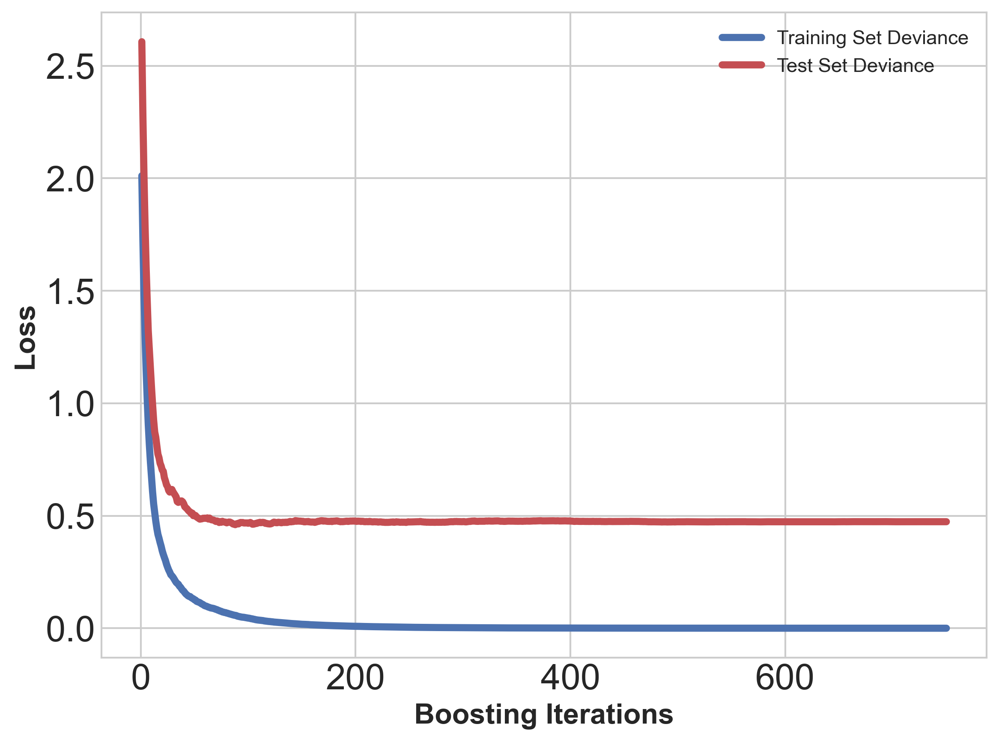

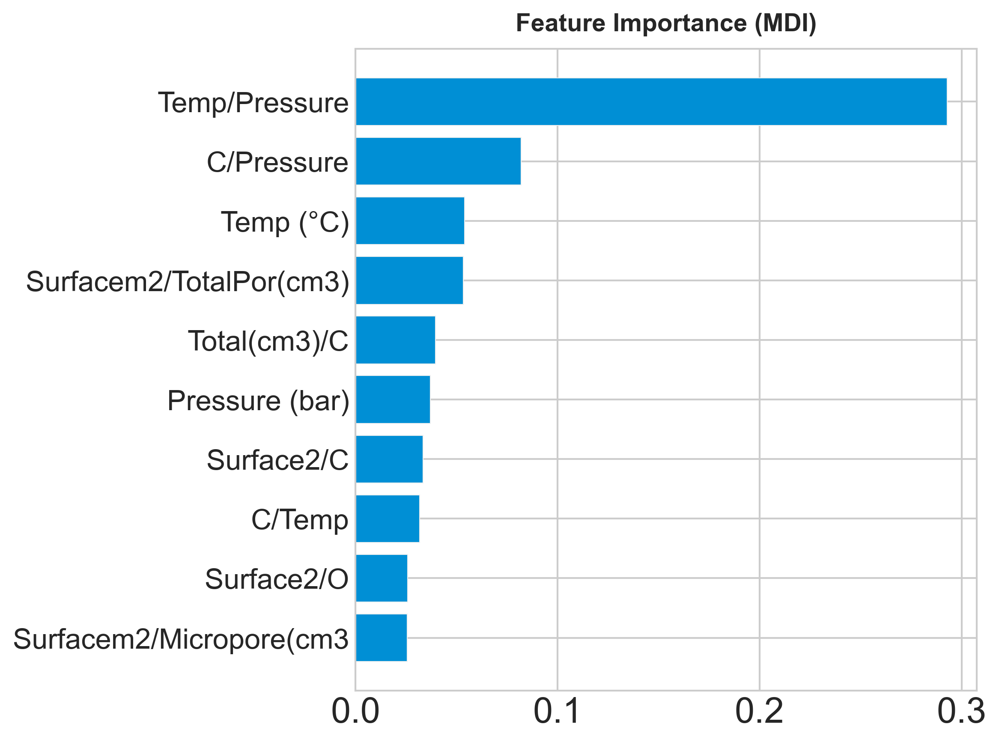

In [135]:
loss_GBR_ML(dss_shuffled,.15)

Mean cross-validated R2 score: 81.25
Standard deviation of cross-validated R2 scores: 6.95


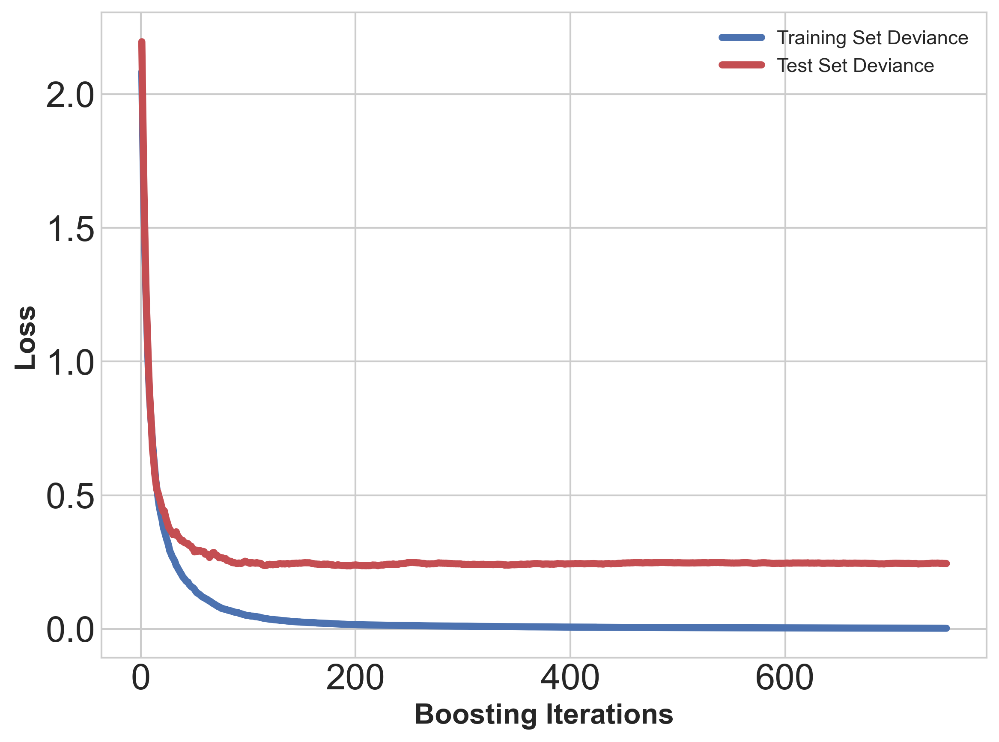

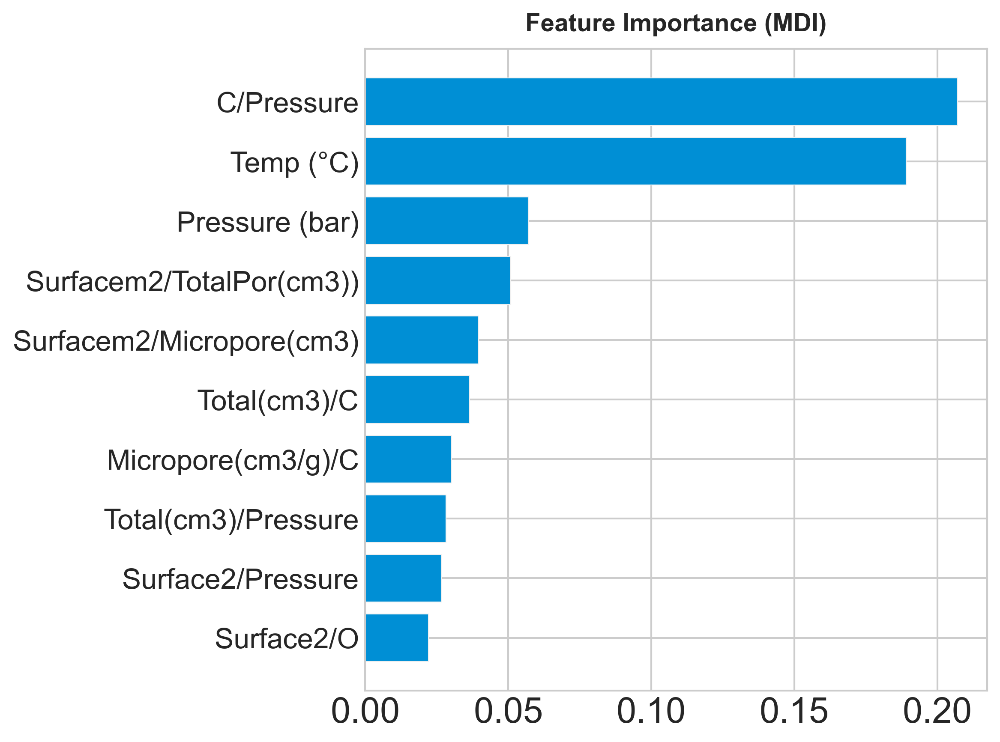

In [136]:
loss_GBR_ML(dss0_shuffled,.15)

In [137]:
def loss_GBR_ML_per(data,size):
    '''loss function and permutation importance using GBR'''
    
    X = data.drop('CO2 uptake (mmol/g)',axis=1) # assuming 'target' is the column you want to predict
    y = data['CO2 uptake (mmol/g)']
    gbr_params = {'learning_rate': 0.1, 'max_depth': 4, 'min_samples_leaf': 1,
                  'min_samples_split': 2, 'n_estimators': 750, 'subsample': 0.5}

    df_train, df_test, df_label, df_test_label = train_test_split(X,y,test_size=.15, random_state=42)
    sc = StandardScaler()
    X_train_std = sc.fit_transform(df_train)
    X_test_std = sc.transform(df_test)

    gbr = GradientBoostingRegressor(**gbr_params)
    cv_scores = cross_val_score(gbr, X_train_std, df_label, cv=5, scoring='r2')
    mean_cv_score = np.mean(cv_scores)
    std_cv_score = np.std(cv_scores)

    print("Mean cross-validated R2 score: %.2f" %( mean_cv_score*100))
    print("Standard deviation of cross-validated R2 scores: %.3f" % (std_cv_score*100))

    gbr.fit(X_train_std, df_label)

    train_score = np.zeros((gbr_params['n_estimators'],), dtype=np.float64)
    test_score = np.zeros((gbr_params['n_estimators'],), dtype=np.float64)
    train_score = gbr.train_score_

    y_test = df_test_label
    for i, y_pred in enumerate(gbr.staged_predict(X_test_std)):
        test_score[i] = gbr.loss_(y_test, y_pred)

    fig = plt.figure(figsize=(8, 6), dpi=300)
    plt.subplot(1, 1, 1)
    plt.title('Deviance')
    plt.plot(np.arange(gbr_params['n_estimators']) + 1, train_score, 'b-', label='Training Set Deviance')
    plt.plot(np.arange(gbr_params['n_estimators']) + 1, test_score, 'r-', label='Test Set Deviance')
    plt.legend(loc='upper right')
    plt.xlabel('Boosting Iterations')
    plt.ylabel('Deviance')
    fig.tight_layout()
    plt.show()

    train_sizes, train_scores, test_scores = learning_curve(gbr, X_train_std, df_label, cv=5,
                                                            train_sizes=np.linspace(0.1, 1.0, 10),
                                                            scoring='neg_mean_squared_error', n_jobs=2)
    train_scores_mean = -np.mean(train_scores, axis=1)
    test_scores_mean = -np.mean(test_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    fig, ax = plt.subplots(figsize=(8, 6), dpi=300)
    ax.set_title("Learning Curves")
    ax.set_xlabel("Training examples")
    ax.set_ylabel("Score")
    ax.grid()
    ax.fill_between(train_sizes, train_scores_mean - train_scores_std,
                    train_scores_mean + train_scores_std, alpha=0.1,
                    color="r")
    ax.fill_between(train_sizes, test_scores_mean - test_scores_std,
                    test_scores_mean + test_scores_std, alpha=0.1, color="g")
    ax.plot(train_sizes, train_scores_mean, 'o-', color="r",
            label="Training score")
    ax.plot(train_sizes, test_scores_mean, 'o-', color="g",
            label="Cross-validation score")
    ax.legend(loc="best")
    fig.tight_layout()
    plt.show()

    bhp = pd.DataFrame(df_train, columns=df_train.columns)
    feature_importance = gbr.feature_importances_
    sorted_idx = np.argsort(feature_importance)[-10:]
    pos = np.arange(sorted_idx.shape[0]) + .5
    fig = plt.figure(figsize=(8, 6), dpi=300)
    plt.barh(pos, feature_importance[sorted_idx], align='center')
    plt.yticks(pos, bhp.columns[sorted_idx], fontsize=12)
    plt.title('Feature Importance (MDI)')
    fig.tight_layout()
    plt.show()

    result = permutation_importance(gbr, X_test_std, df_test_label, n_repeats=5,
                                    random_state=42, n_jobs=2)
    sorted_idx = result.importances_mean.argsort()[-10:]
    fig, ax = plt.subplots(figsize=(8, 6), dpi=300)
    ax.boxplot(result.importances[sorted_idx].T,
               vert=False, labels=np.array(bhp.columns)[sorted_idx])
    ax.set_title("Permutation Importances (test set)")
    fig.tight_layout()
    plt.show()


Mean cross-validated R2 score: 84.75
Standard deviation of cross-validated R2 scores: 4.207


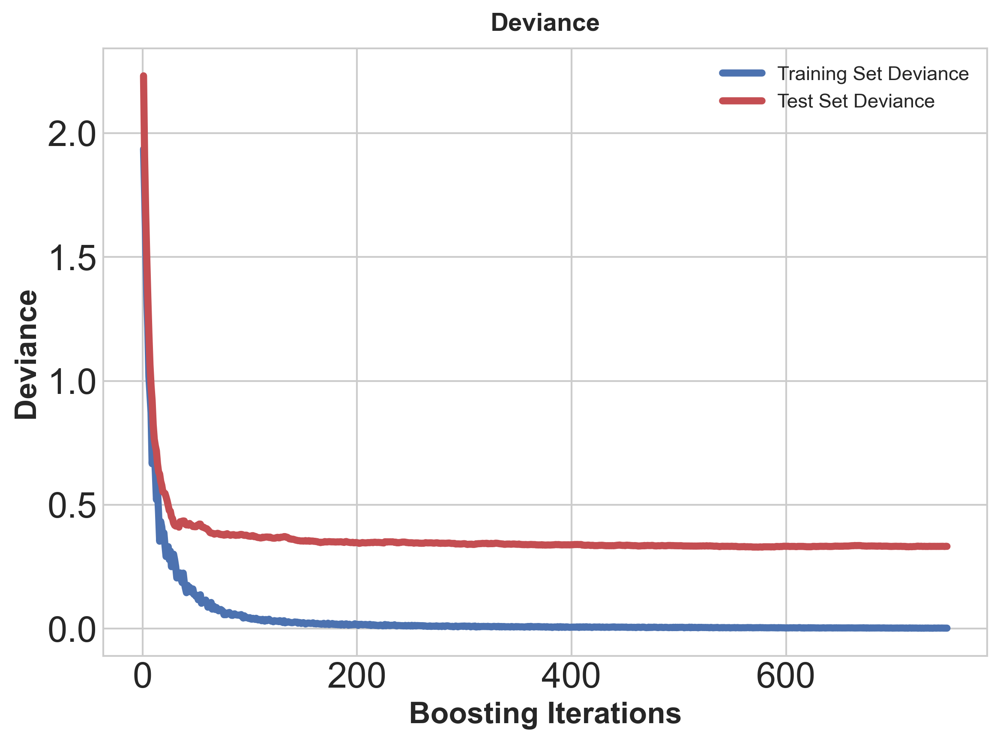

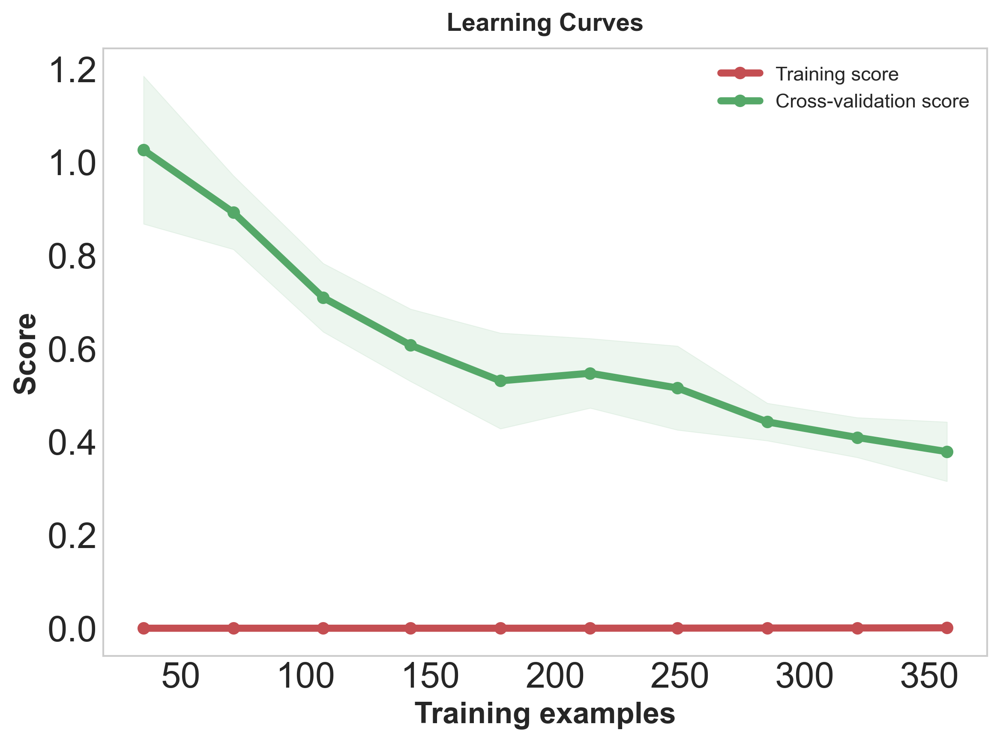

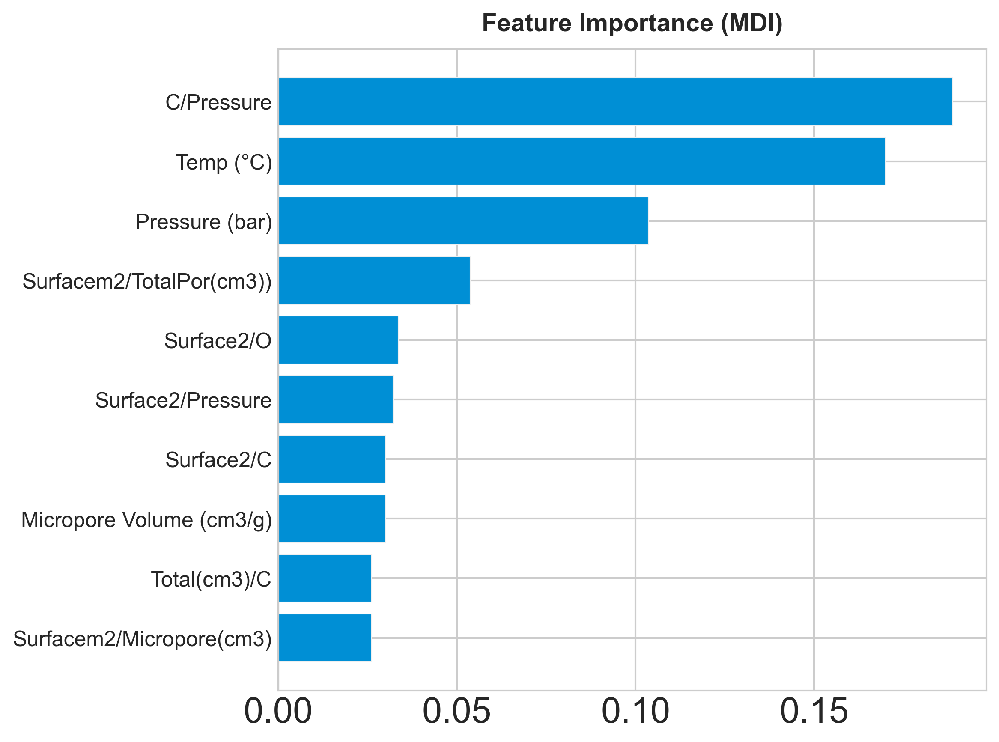

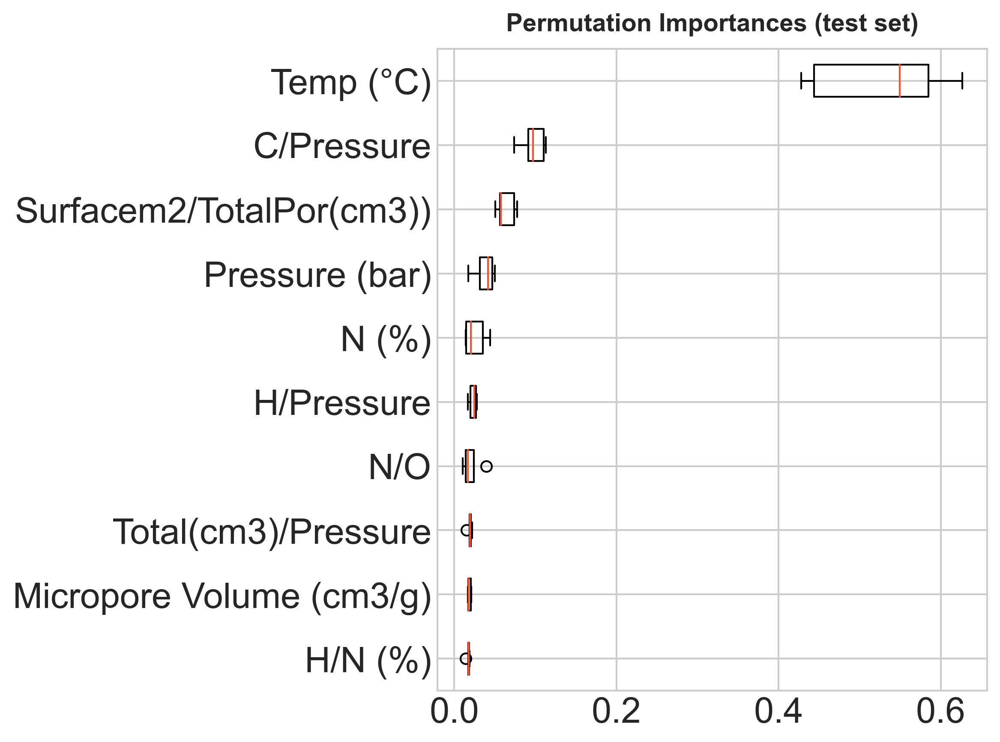

In [138]:
loss_GBR_ML_per(X_new_dfs01_shuffled,.15)

Mean cross-validated R2 score: 81.22
Standard deviation of cross-validated R2 scores: 2.513


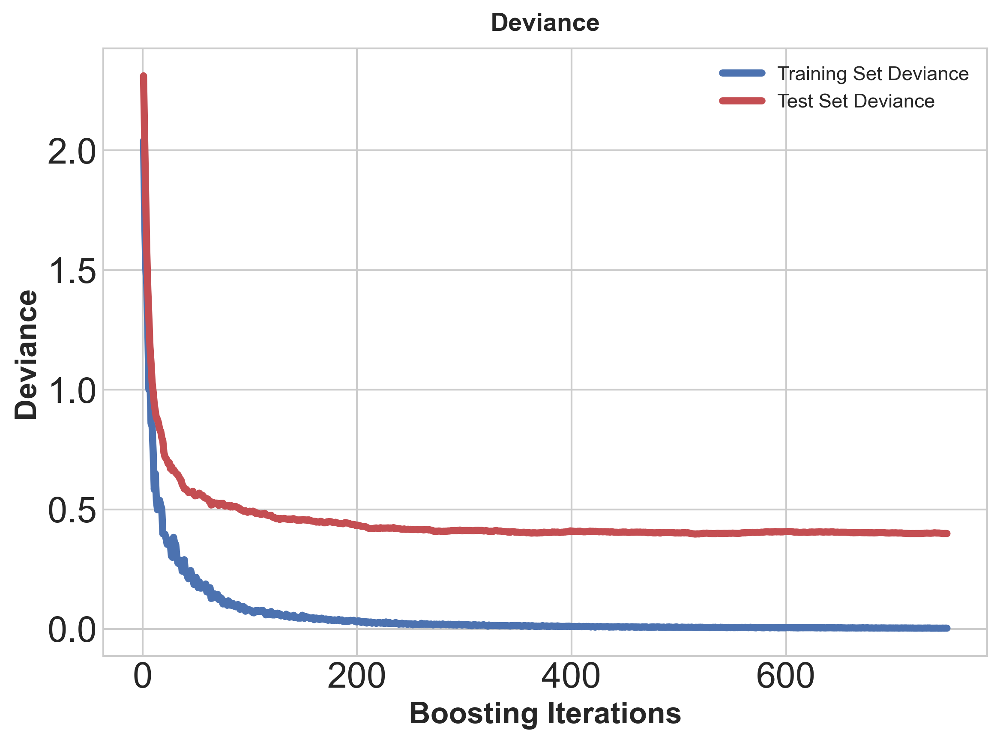

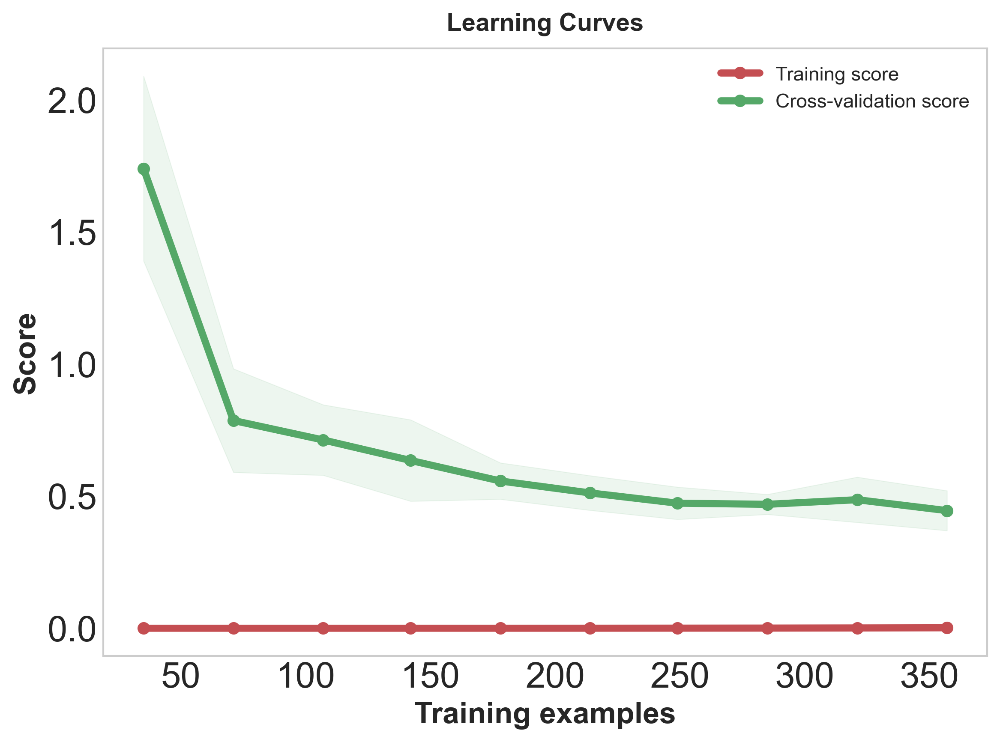

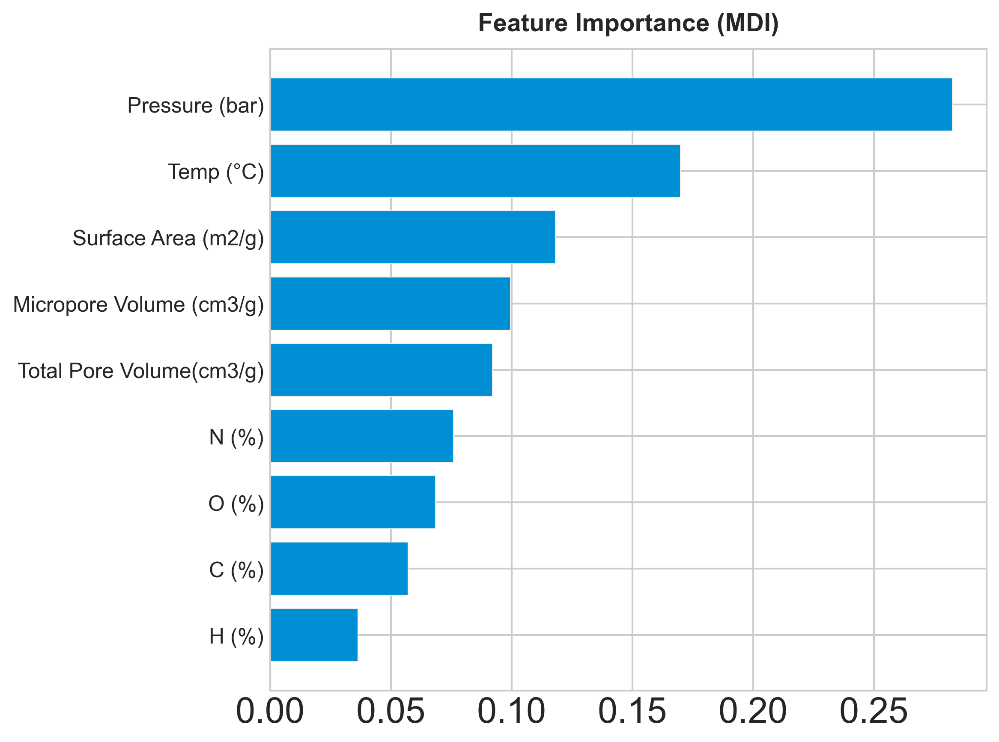

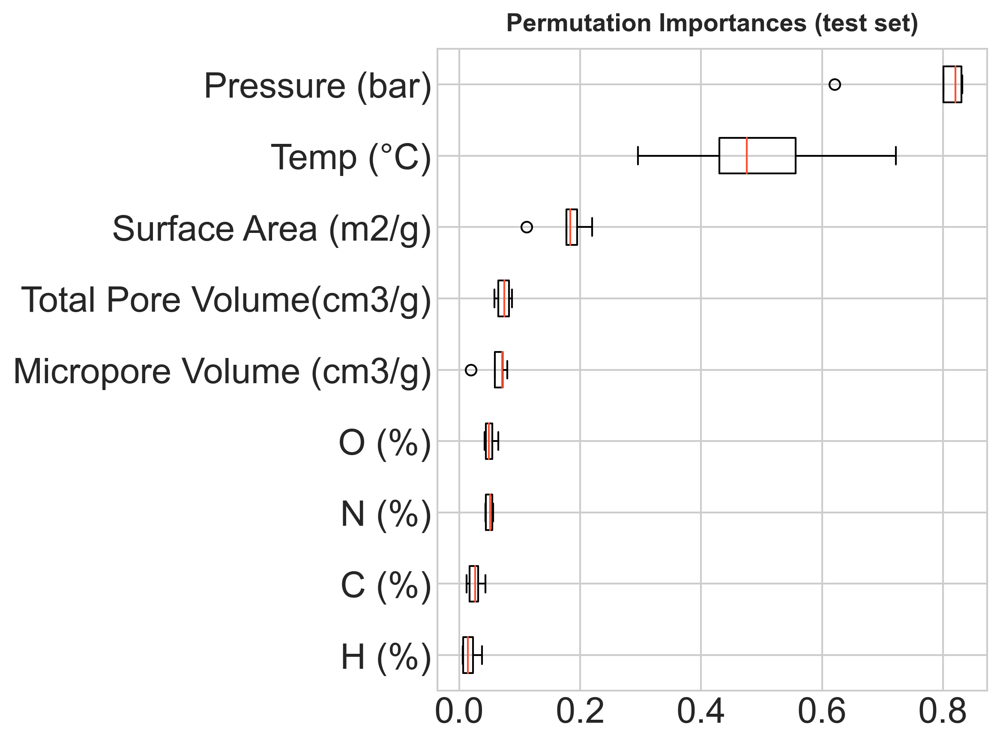

In [139]:
loss_GBR_ML_per(df_0,.15)

Mean cross-validated R2 score: 80.13
Standard deviation of cross-validated R2 scores: 4.084


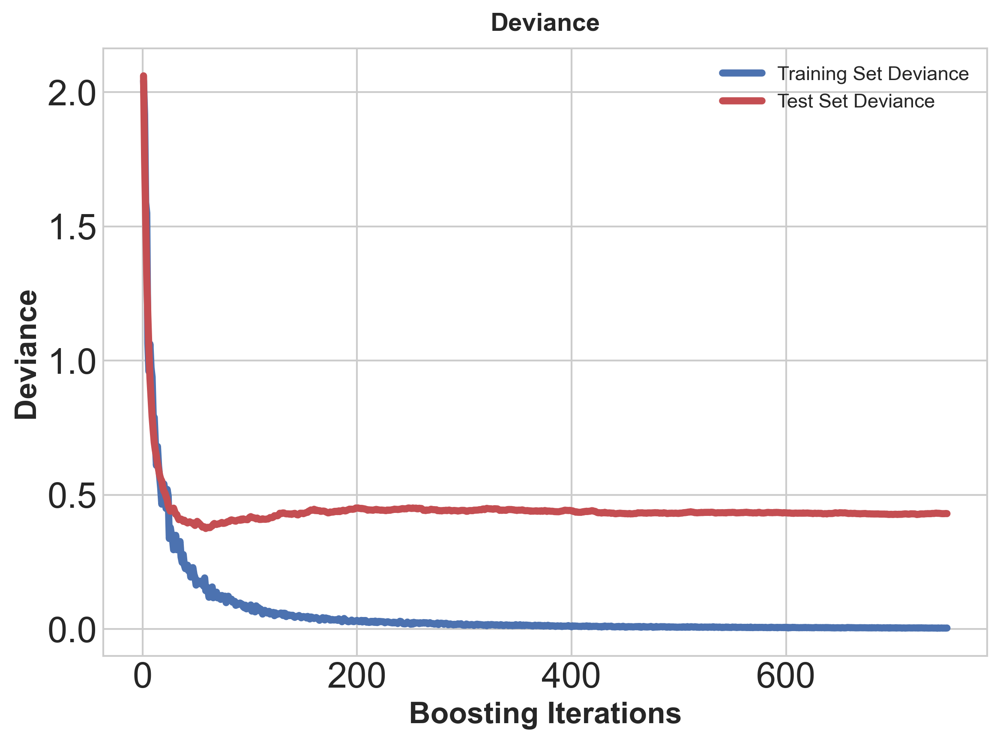

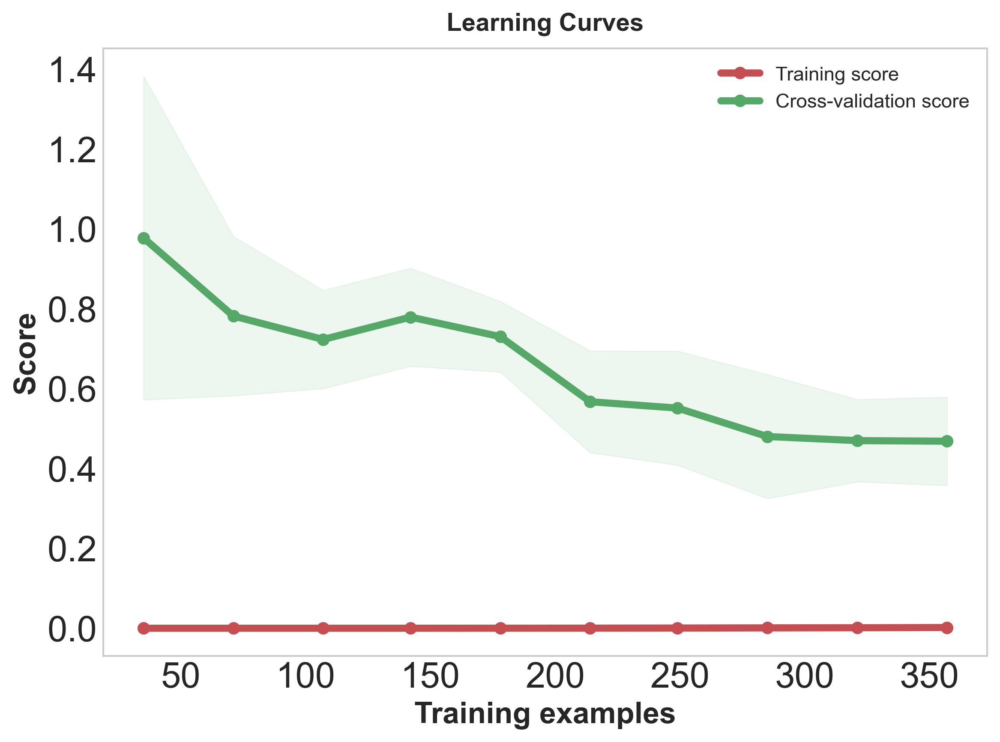

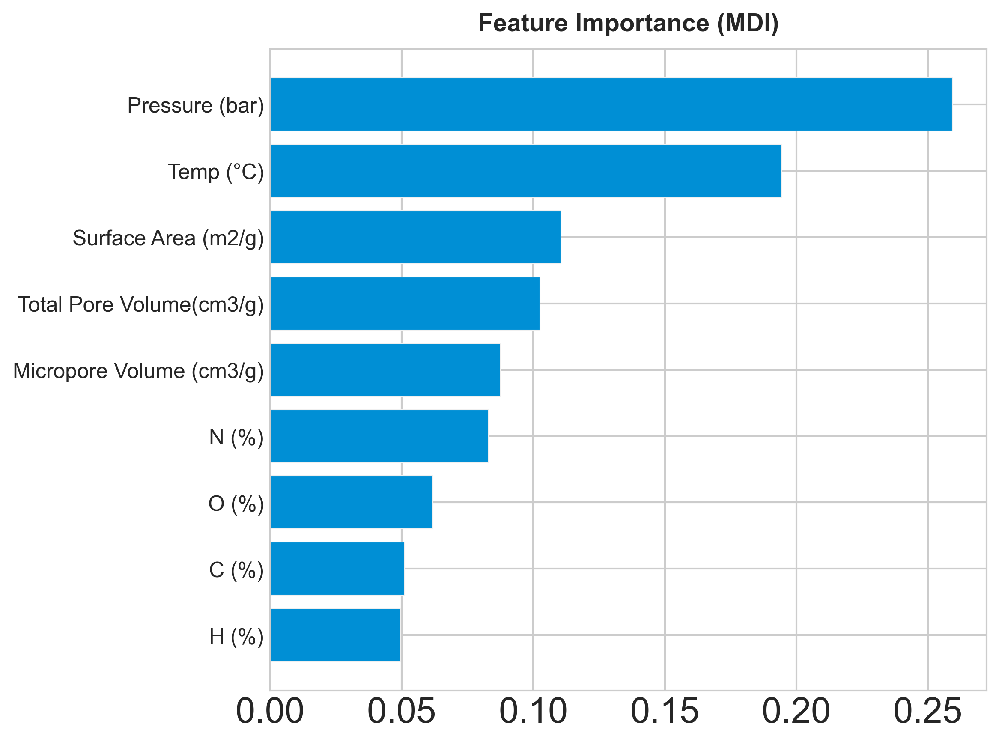

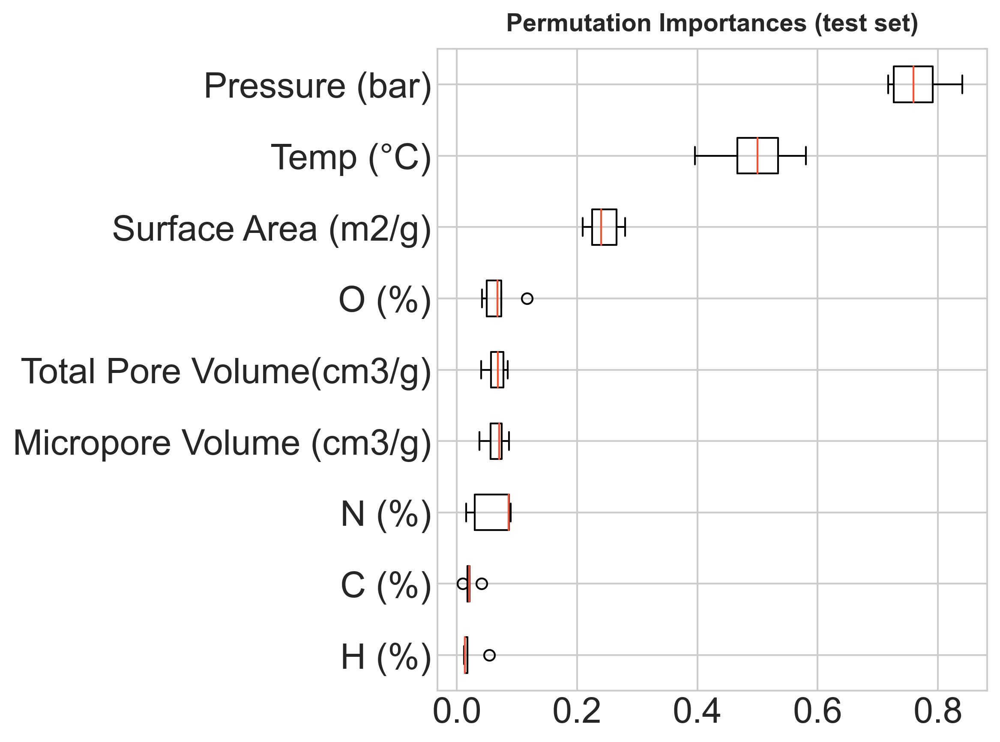

In [140]:
loss_GBR_ML_per(df_0_shuffled,.15)

Mean cross-validated R2 score: 81.87
Standard deviation of cross-validated R2 scores: 5.988


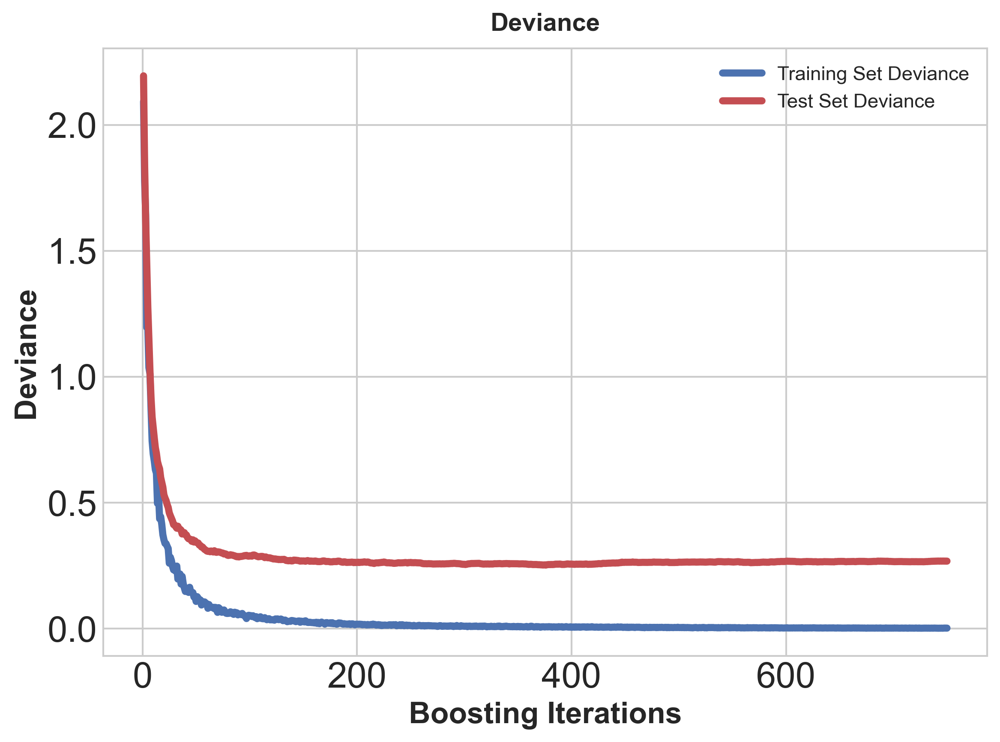

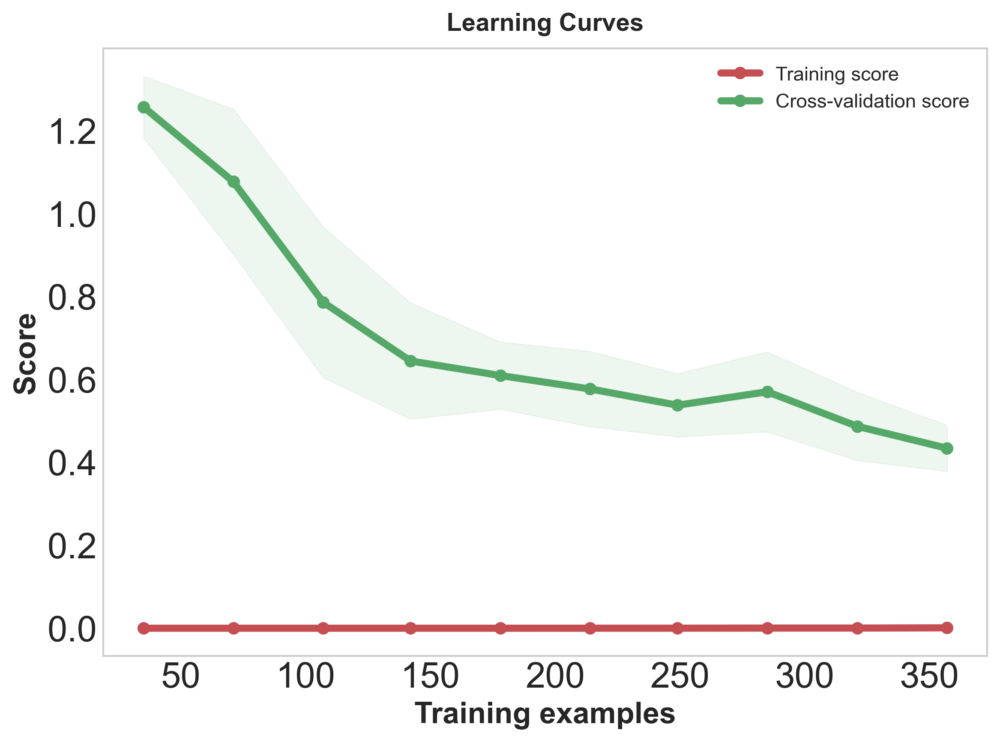

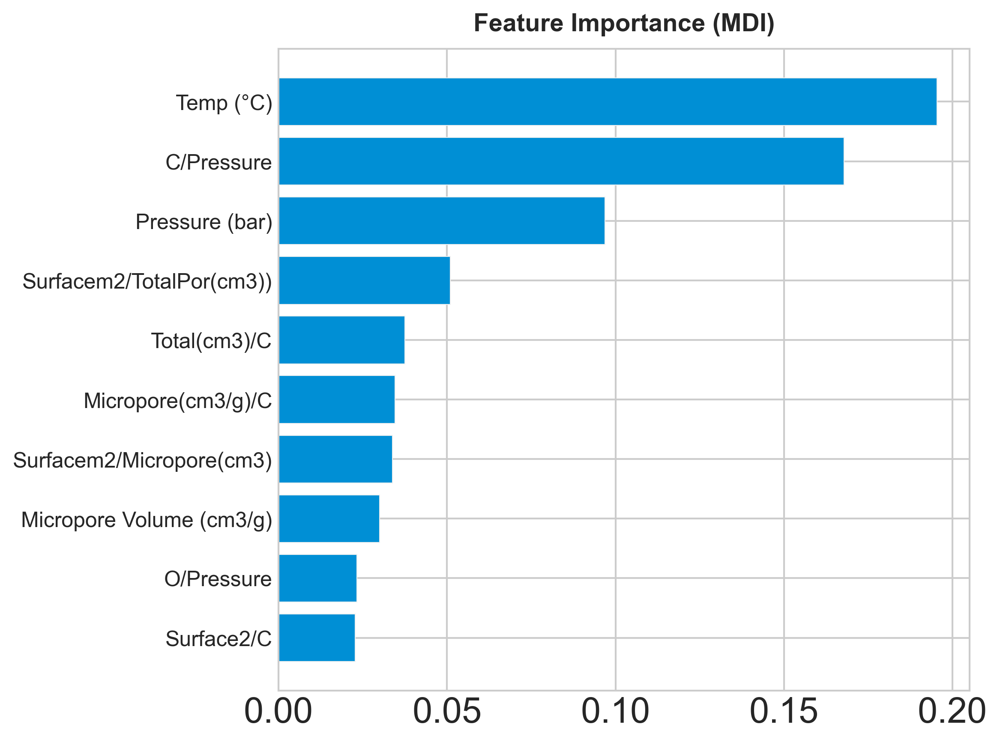

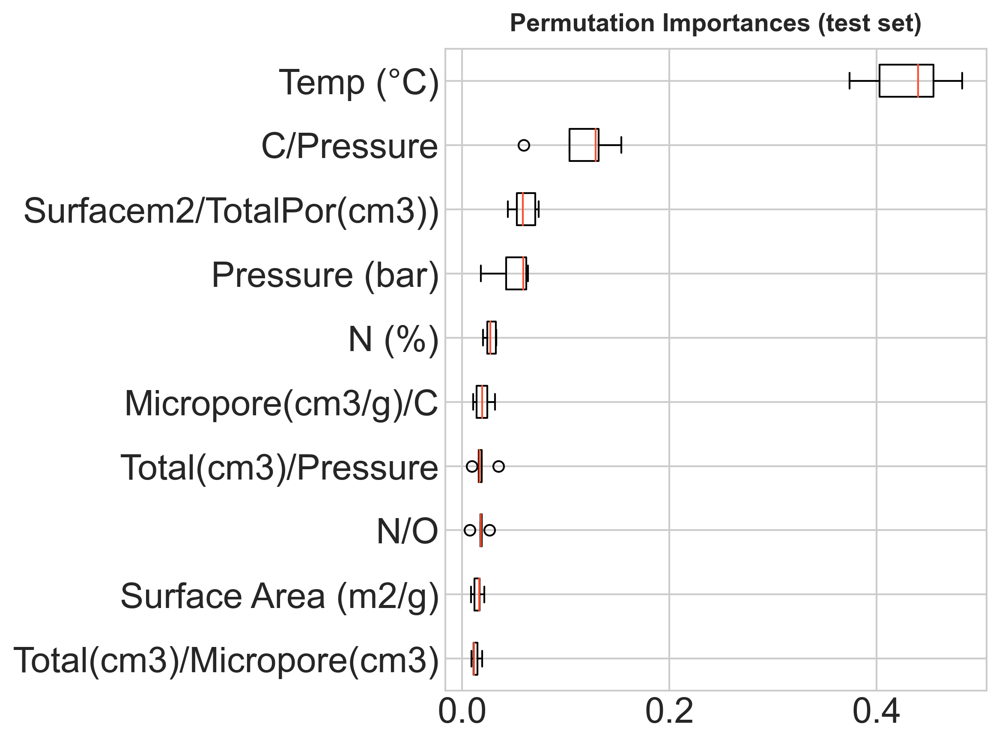

In [141]:
loss_GBR_ML_per(dss0_shuffled,.15)

Mean cross-validated R2 score: 81.01
Standard deviation of cross-validated R2 scores: 4.344


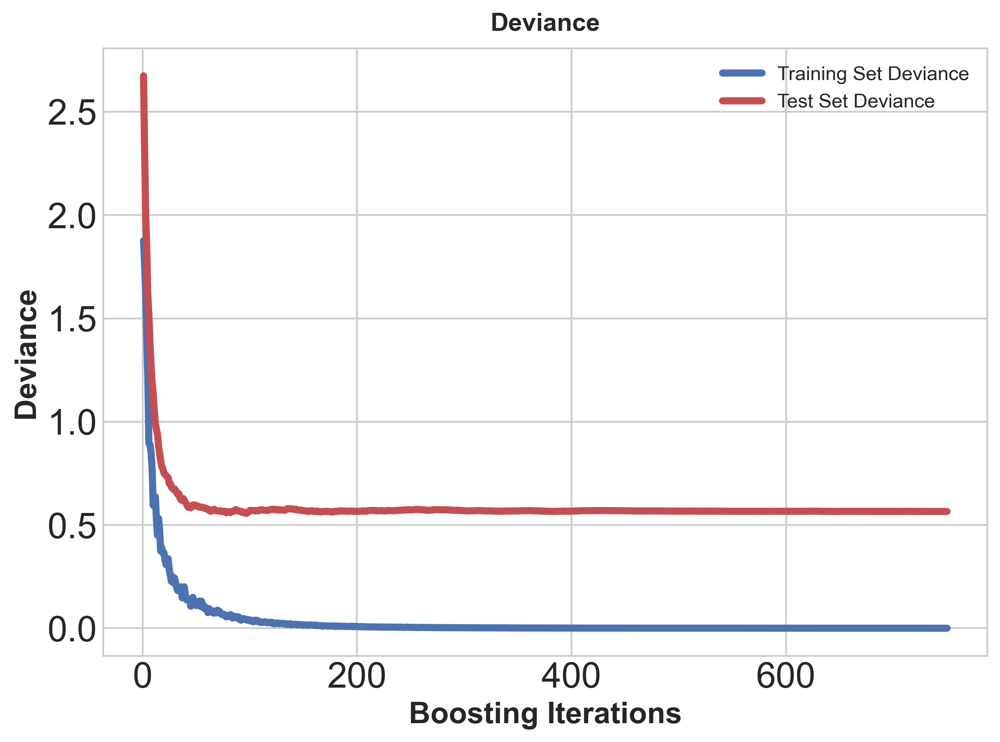

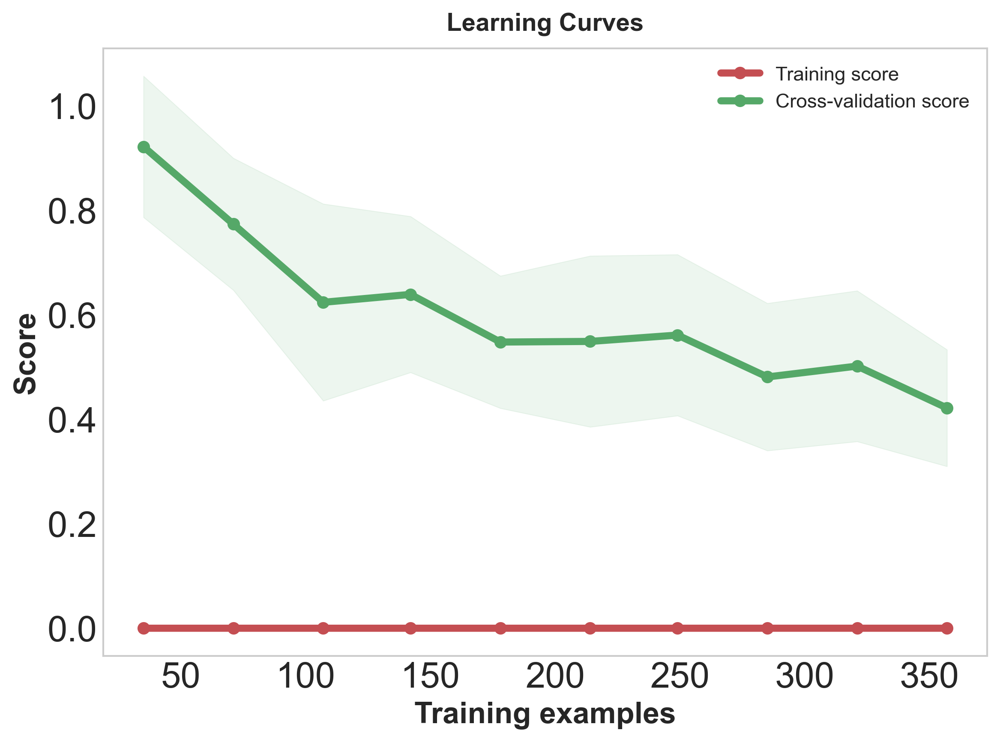

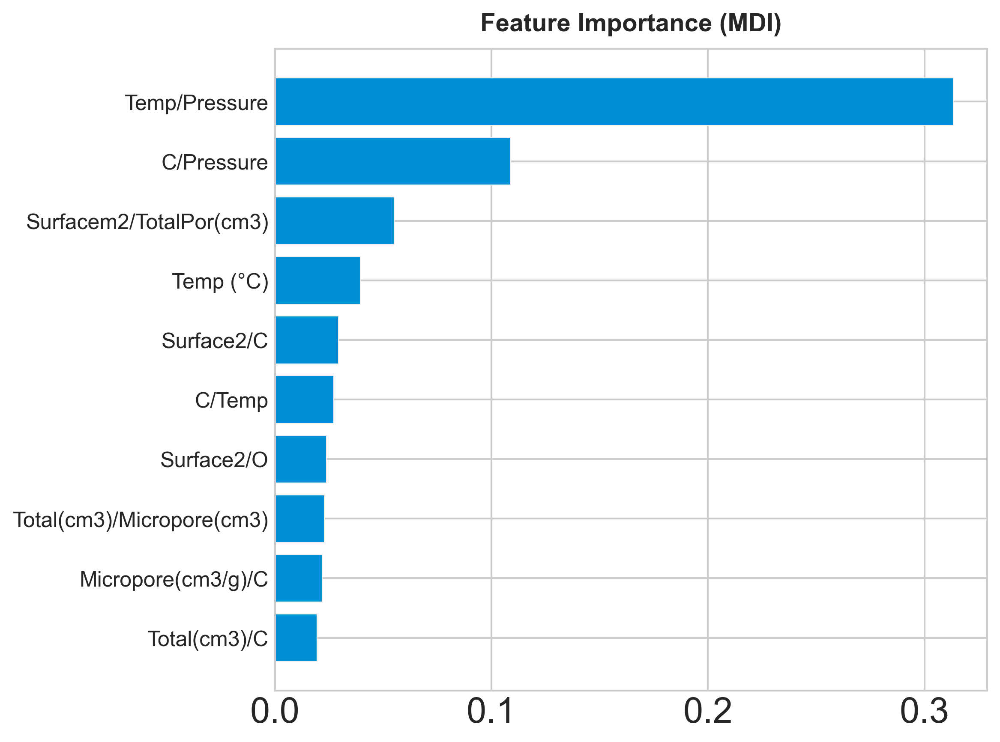

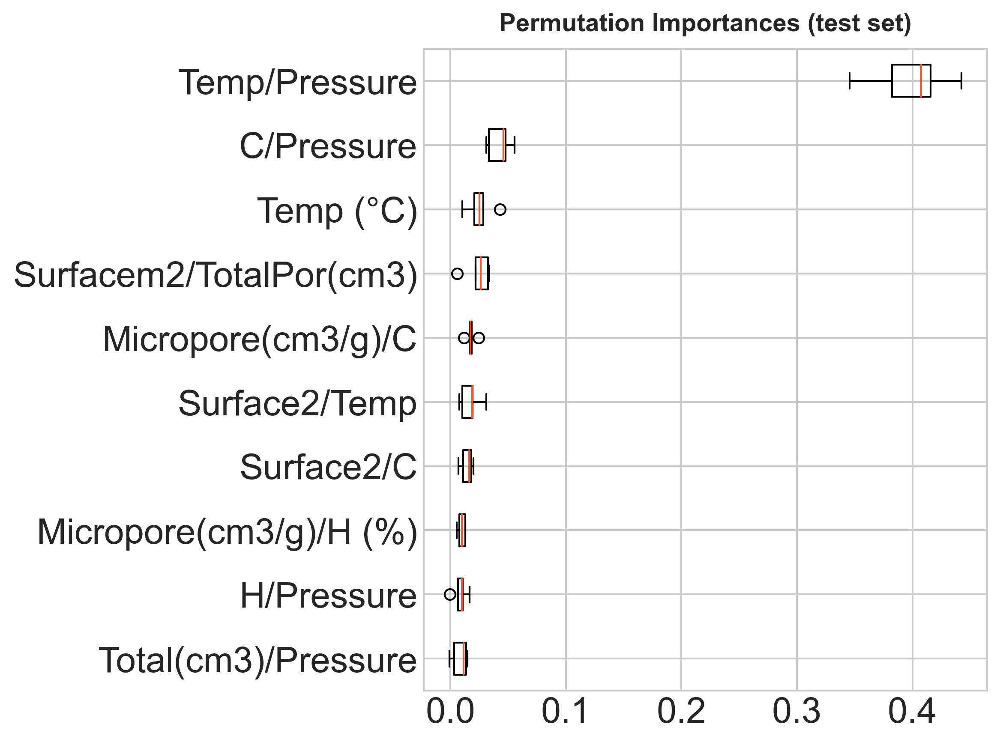

In [142]:
loss_GBR_ML_per(dss_shuffled,.15)

In [143]:
dff2['Micropore Volume (cm3/g)']=dss['Micropore Volume (cm3/g)']
dff2_shuffled = shuffle(dff2)

In [144]:
def N_par_gbr(dataset,fold,size,n):
    ''' this function find effect of changes in Nitrogen features on co2 adsorption '''
    results0={}
    results20={}

    for i in range(1, n):#[.1,.2,.3,.4,.5,.6,.7,.8,.9,1,1.2,1.3,1.4,1.5]:
        
        

        dataset_shuffled=shuffle(dataset)
     
        #dataset_shuffled['Pressure (bar)']= dataset['Pressure (bar)']+i/10
        #dataset_shuffled.loc[:,['N (%)']]= dataset_shuffled.loc[:,['N (%)']]+round(i / 3, 1)
        dataset_shuffled.loc[:,['N (%)']]= round(i / 10, 2)

        print(dataset_shuffled['N (%)'].head(2))
        x=dataset_shuffled.drop(['CO2 uptake (mmol/g)'],axis=1)
        y=dataset_shuffled['CO2 uptake (mmol/g)']
        df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)


        gbr = GradientBoostingRegressor(learning_rate= .1, max_depth = 5, min_samples_leaf = 1,
                          min_samples_split = 2, n_estimators = 300,
                          subsample = 0.5, random_state=42)
        #GradientBoostingRegressor(learning_rate=i, n_estimators=j)
        gbr = gbr.fit(df_train, df_label)

        pred20 = gbr.predict(df_test)
        scores0 = cross_val_score(gbr, x, y , cv=fold, scoring='r2')
        print(scores0)

        print("predict output for GradientBoostingRegressor: presuure = {}".format(i))
        mse = mean_squared_error(df_test_label, gbr.predict(df_test))
        print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
        #scores=gbr.score(df_test, df_test_label)
        #pred2 = gbr.predict(df_test)
        #print("Accuracy on training set: %.3f" % pred2)
        print("mean on test set: %.3f" % scores0.mean())
        print("std on test set: %.3f" % scores0.std())

        print("==============================================")
        results0[f'{i}'] = scores0.mean()
        results20[f'{i}'] = scores0.std()


    df_scores0 = pd.DataFrame(results0, index=[0]).copy()
    df_scores20 = pd.DataFrame(results20, index=[0]).copy()


    return results0,results20,df_scores0,df_scores20


In [145]:
# N_par_gbr(dff2,7,.15,10)

In [146]:
def pressure_par_gbr(dataset,fold,size,n):
    
    ''' this function find effect of changes in Presuure features on co2 adsorption '''
    
    results0={}
    results20={}

    for i in range(1, n):#[.1,.2,.3,.4,.5,.6,.7,.8,.9,1,1.2,1.3,1.4,1.5]:
        
        

        dataset_shuffled=shuffle(dataset)
     
        #dataset_shuffled['Pressure (bar)']= dataset['Pressure (bar)']+i/10
        dataset_shuffled.loc[:,['Temp (°C)']]= dataset_shuffled.loc[:,['Temp (°C)']]+round(i / 3, 1)
        print(dataset_shuffled['Temp (°C)'].head(2))
        x=dataset_shuffled.drop(['CO2 uptake (mmol/g)'],axis=1)
        y=dataset_shuffled['CO2 uptake (mmol/g)']
        df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)


        gbr = GradientBoostingRegressor(learning_rate= .1, max_depth = 5, min_samples_leaf = 1,
                          min_samples_split = 2, n_estimators = 300,
                          subsample = 0.5, random_state=42)
        #GradientBoostingRegressor(learning_rate=i, n_estimators=j)
        gbr = gbr.fit(df_train, df_label)

        pred20 = gbr.predict(df_test)
        scores0 = cross_val_score(gbr, x, y , cv=fold, scoring='r2')
        print(scores0)

        print("predict output for GradientBoostingRegressor: presuure = {}".format(i))
        mse = mean_squared_error(df_test_label, gbr.predict(df_test))
        print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
        #scores=gbr.score(df_test, df_test_label)
        #pred2 = gbr.predict(df_test)
        #print("Accuracy on training set: %.3f" % pred2)
        print("mean on test set: %.3f" % scores0.mean())
        print("std on test set: %.3f" % scores0.std())

        print("==============================================")
        results0[f'{i}'] = scores0.mean()
        results20[f'{i}'] = scores0.std()


    df_scores0 = pd.DataFrame(results0, index=[0]).copy()
    df_scores20 = pd.DataFrame(results20, index=[0]).copy()


    return results0,results20,df_scores0,df_scores20


In [147]:
def pressure_par_gbr_added(dataset,fold,size,n):
    results={}
    results2={}
    
    for i in range(1, n):#[.1,.2,.3,.4,.5,.6,.7,.8,.9,1,1.2,1.3,1.4,1.5]:
        
                
        
        dataset_shuffled=shuffle(dataset)
        dataset_shuffled.loc[:,['Pressure (bar)']]= dataset_shuffled.loc[:,['Pressure (bar)']]+round(i / 30, 1)
        #dataset_shuffled['Pressure (bar)']=dataset['Pressure (bar)']+i/10
        print(dataset_shuffled['Pressure (bar)'].head(2))

        x=dataset_shuffled.drop(['CO2 uptake (mmol/g)'],axis=1)
        y=dataset_shuffled['CO2 uptake (mmol/g)']
        df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)


        gbr = GradientBoostingRegressor(learning_rate= .1, max_depth = 5, min_samples_leaf = 1,
                          min_samples_split = 2, n_estimators = 300,
                          subsample = 0.5, random_state=42)
        #GradientBoostingRegressor(learning_rate=i, n_estimators=j)
        gbr = gbr.fit(df_train, df_label)

        pred2 = gbr.predict(df_test)
        scores = cross_val_score(gbr, x, y , cv=fold, scoring='r2')
        print(scores)

        print("predict output for GradientBoostingRegressor: presuure = {}".format(i))
        mse = mean_squared_error(df_test_label, gbr.predict(df_test))
        print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
        #scores=gbr.score(df_test, df_test_label)
        #pred2 = gbr.predict(df_test)
        #print("Accuracy on training set: %.3f" % pred2)
        print("mean on test set: %.3f" % scores.mean())
        print("std on test set: %.3f" % scores.std())

        print("==============================================")
        results[f'{i}'] = scores.mean()
        results2[f'{i}'] = scores.std()


    df_scores = pd.DataFrame(results, index=[0]).copy()
    df_scores2 = pd.DataFrame(results2, index=[0]).copy()


    return results,results2,df_scores,df_scores2


In [148]:
def pressure_par_gbr2(dataset,fold,size):
    ''' this function find effect of changes in 3 pressure, temperature and MV features on co2 adsorption '''

    results={}
    results2={}
    resultsp={}
    resultst={}
    resultsm={}
    for i in range(10, 20, 2):#[.1,.2,.3,.4,.5,.6,.7,.8,.9,1,1.2,1.3,1.4,1.5]:
        for j in range(4, 32, 4):
            for k in range(1, 3, 1):
                
                dff2_shuffled=shuffle(dataset)

                dff2_shuffled['Pressure (bar)']=dff2_shuffled['Pressure (bar)']+i/10 
                dff2_shuffled['Temp (°C)']=dff2_shuffled['Temp (°C)']+j 
                dff2_shuffled['Micropore Volume (cm3/g)']=dff2_shuffled['Micropore Volume (cm3/g)']+k/10 

                x=dff2_shuffled.drop(['CO2 uptake (mmol/g)'],axis=1)
                y=dff2_shuffled['CO2 uptake (mmol/g)']
                df_train,df_test,df_label,df_test_label=train_test_split(x,y,test_size=size, random_state=42)


                gbr = GradientBoostingRegressor(learning_rate= .1, max_depth = 5, min_samples_leaf = 1,
                                  min_samples_split = 2, n_estimators = 300,
                                  subsample = 0.5, random_state=42)
                #GradientBoostingRegressor(learning_rate=i, n_estimators=j)
                gbr = gbr.fit(df_train, df_label)

                pred2 = gbr.predict(df_test)
                scores = cross_val_score(gbr, x, y , cv=fold, scoring='r2')
                print(scores)

                print("predict output for GradientBoostingRegressor: presuure = {}, Temp = {},  TPV = {} ".format(i,j,k))
                mse = mean_squared_error(df_test_label, gbr.predict(df_test))
                print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
                #scores=gbr.score(df_test, df_test_label)
                #pred2 = gbr.predict(df_test)
                #print("Accuracy on training set: %.3f" % pred2)
                print("mean on test set: %.3f" % scores.mean())
                print("std on test set: %.3f" % scores.std())

                print("==============================================")
                
                resultsp[f'{i}'] = scores.mean()
                resultst[f'{j}'] = scores.mean()
                resultsm[f'{k}'] = scores.mean()

                results[f'{i}-{j}-{k}'] = scores.mean()
                results2[f'{i}-{j}-{k}'] = scores.std()


    df_scores = pd.DataFrame(results, index=[0]).copy()
    df_scores2 = pd.DataFrame(results2, index=[0]).copy()


    return results,results2,df_scores,df_scores2,resultsp,resultst,resultsm




In [149]:
#results,results2,df_scores,df_scores2,resultsp,resultst,resultsm=pressure_par_gbr2(df_0,7,0.15)


In [150]:

# result = resultst.items()
  
# # Convert object to a list
# data = list(result)
  
# # Convert list to an array
# numpyArray = np.array(data)
# type(numpyArray)


In [151]:

# def effect_features(dataset,fold,size,n):

#     results,results2,df_scores,df_scores2=pressure_par_gbr_added(dataset,fold,size,n)
#     results0,results20,df_scores0,df_scores20=pressure_par_gbr(dataset,fold,size,n)

#     max_accuracy=max(df_scores.loc[0])
#     print(max_accuracy)
    
#     min_std=min(df_scores2.loc[0])
#     print(min_std)
#     min_std=float(min_std)
    
#     maxValueIndexObj = df_scores.idxmax(axis=1)
#     print(maxValueIndexObj)
    
#     minxValueIndexObj = df_scores2.idxmin(axis=1)
#     print(minxValueIndexObj)
    
    
#     max_accuracy0=max(df_scores0.loc[0])
#     print(max_accuracy0)
    
#     min_std0=min(df_scores20.loc[0])
#     print(min_std0)
    
#     maxValueIndexObj0 = df_scores0.idxmax(axis=1)
#     print(maxValueIndexObj0)
    
#     minxValueIndexObj0 = df_scores20.idxmin(axis=1)
#     print(minxValueIndexObj0)
    
    
#     accuracies=train_datasets2(dataset,4,fold,size)
    
#     accuracy=round(accuracies.mean(), 3)
#     accuracy=float(accuracy)
    
#     stdy=round(accuracies.std(),3)
#     stdy=float(stdy)
    
#     max_accuracy=round(max_accuracy,3)
#     maxValueIndexObj
#     maxValueIndexObj=float(maxValueIndexObj)
    
#     min_stady=round(min_std,3)
#     maxValueIndexObj
#     minxValueIndexObj=int(minxValueIndexObj)
    
#     maxValueIndexObj=int(maxValueIndexObj)
    

#     df_scores=np.append(accuracy, df_scores)
#     df_scores
#     df_scores2=np.append(stdy, df_scores2)
#     df_scores2
    
#     df_scores0=np.append(accuracy, df_scores0)
#     df_scores0
#     df_scores20=np.append(stdy, df_scores20)
#     df_scores20
    

#     plt.figure(figsize=(12, 6), dpi=300)
    
#     plt.text(1.1, accuracy, 'main accuray', fontsize = 14)
#     plt.text(maxValueIndexObj+1, max_accuracy, 'max accuray', fontsize = 14)
    
#     plt.plot(range(1, df_scores.shape[0]+1,1), df_scores, label='test set accuracy trend by changing pressure ',color='black', linestyle='dashed', marker='o',
#     markerfacecolor='red', markersize=10)


#     #plt.figure(figsize=(12, 6), dpi=300)
#     plt.plot(range(1, df_scores0.shape[0]+1,1), df_scores0, label='test set accuracy trend by pressure ',color='black', linestyle='dashed', marker='o',
#     markerfacecolor='blue', markersize=10)
    
    
#     plt.title('Accuracy of test set for presuure=.1, .2, . . ., 1.5')
#     plt.xlabel('pressure Value')
#     plt.ylabel('accuracy')
#     plt.legend()
#     # plt.show(block=False)
#     plt.show()
    
    
#     plt.figure(figsize=(12, 6), dpi=300)
    
#     plt.plot(df_scores, label='test set accuracy trend by changing pressure ',color='red')
#     #plt.figure(figsize=(12, 6), dpi=300)
#     plt.plot( df_scores0, label='test set accuracy trend by pressure ',color='black')
    
    
#     plt.title('Accuracy of test set for presuure=.1, .2, . . ., 1.5')
#     plt.xlabel('pressure Value')
#     plt.ylabel('accuracy')
#     plt.legend()
#     # plt.show(block=False)
#     plt.show()

    
#     plt.figure(figsize=(12, 6), dpi=300)
    
#     plt.text(1.1, stdy, 'main std', fontsize = 12)
#     plt.text(minxValueIndexObj+1, min_stady, 'min stady', fontsize = 12)
    
#     plt.plot(range(1, df_scores2.shape[0]+1,1), df_scores2, label='test set std trend by changing pressure ',color='black', linestyle='dashed', marker='o',
#     markerfacecolor='red', markersize=10)
#     # plt.plot(range(1, 17,1), df_scores, label='test set std trend by changing pressure ',color='black', linestyle='dashed', marker='o',
#     # markerfacecolor='blue', markersize=10)

#     plt.plot(range(1, df_scores20.shape[0]+1,1), df_scores20, label='test set std trend by pressure ',color='black', linestyle='dashed', marker='o',
#     markerfacecolor='blue', markersize=10)
#     # plt.plot(range(1, 17,1), df_scores, label='test set std trend by changing pressure ',color='black', linestyle='dashed', marker='o',
#     # markerfacecolor='blue', markersize=10)

#     plt.title('std of test for presuure=.1, .2, . . ., 1.5')
#     plt.xlabel('pressure Value')
#     plt.ylabel('accuracy')
#     plt.legend()
#     # plt.show(block=False)
#     plt.show()
    
    
#     plt.figure(figsize=(12, 6), dpi=300)
    
#     plt.plot(df_scores2, label='test set std trend by changing pressure ',color='black')
#     # plt.plot(range(1, 17,1), df_scores, label='test set std trend by changing pressure ',color='black', linestyle='dashed', marker='o',
#     # markerfacecolor='blue', markersize=10)

#     plt.plot(df_scores20, label='test set std trend by pressure ',color='red')
#     # plt.plot(range(1, 17,1), df_scores, label='test set std trend by changing pressure ',color='black', linestyle='dashed', marker='o',
#     # markerfacecolor='blue', markersize=10)

#     plt.title('std of test for presuure=.1, .2, . . ., 1.5')
#     plt.xlabel('pressure Value')
#     plt.ylabel('accuracy')
#     plt.legend()
#     # plt.show(block=False)
#     plt.show()
#     return df_scores


In [152]:
# effect_features(mdfs0,7,0.15,6)

In [153]:

def evaluate_model(dataset, model,cv,split):
    
    XX=dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]
    sc = StandardScaler()
    X= sc.fit_transform(XX)
    #define model evaluation method
    cv = RepeatedKFold(n_splits=split, n_repeats=1, random_state=1234)
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)
    scores1 = cross_validate( model, X, y, scoring='r2')
    # force scores to be positive
    print('Mean MAE: %.3f (%.3f)' % (mean(scores)*100, std(scores)*100))
    print(scores)
    print()
    print(scores.mean())
    print()
    print(scores.std())
    print(sorted(scores1.keys()))
    return absolute(scores),scores1.keys()
    
 


In [154]:
# plot the dataset and the model's line of best fit
def plot_best_fit(dataset, model):
    # fut the model on all data
    XX=dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]
    sc = StandardScaler()
    X= sc.fit_transform(XX)
    model.fit(X, y)
    # plot the dataset
    
    plt.scatter(dataset['Surface Area (m2/g)'].values,dataset["CO2 uptake (mmol/g)"].values)
    # plot the line of best fit
    xaxis = arange(dataset['Surface Area (m2/g)'].values.min(), dataset['Surface Area (m2/g)'].values.max(), 0.01)
    #yaxis = model.predict(xaxis.reshape((len(xaxis), 1)))
   # plt.plot(xaxis, yaxis, color='r')
    # show the plot
    plt.title(type(model).__name__)
    plt.show()


In [155]:
evaluate_model(dff2_shuffled,gbr,10,10)

Mean MAE: 84.679 (5.436)
[0.857494 0.898355 0.918041 0.858557 0.82908  0.717826 0.868217 0.793616
 0.843591 0.883098]

0.846787405073463

0.05435905835796347
['fit_time', 'score_time', 'test_score']


(array([0.857494, 0.898355, 0.918041, 0.858557, 0.82908 , 0.717826,
        0.868217, 0.793616, 0.843591, 0.883098]),
 dict_keys(['fit_time', 'score_time', 'test_score']))

In [156]:
evaluate_model(dff02_shuffled,gbr,10,10)

Mean MAE: 84.515 (6.339)
[0.923832 0.849868 0.852534 0.923244 0.866004 0.848775 0.822994 0.866754
 0.686205 0.811297]

0.8451506614291386

0.06338883902057076
['fit_time', 'score_time', 'test_score']


(array([0.923832, 0.849868, 0.852534, 0.923244, 0.866004, 0.848775,
        0.822994, 0.866754, 0.686205, 0.811297]),
 dict_keys(['fit_time', 'score_time', 'test_score']))

# Applying neural networks 

In [157]:
# !pip install scikeras
# !pip install keras_tuner
# !pip install keras_sequential_ascii

In [158]:
from tensorflow.keras.layers import Dense
from keras.models import Sequential
from keras import backend as K
from tensorflow.keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense, Activation
from tensorflow.keras.layers import Input, Reshape, LSTM, Dense, TimeDistributed
from keras.models import Sequential
from keras.utils.vis_utils import plot_model
from tabulate import tabulate
from keras.layers import Dense
from keras.models import Sequential
from keras.optimizers import SGD
from matplotlib import pyplot
from keras.optimizers import SGD
from numpy import mean
from numpy import std
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Input, Reshape, LSTM, Dense, TimeDistributed
from keras.layers import Dropout
from tensorflow.keras.layers import BatchNormalization
from sklearn.datasets import load_boston
from keras.models import Sequential
from keras.layers import Dense, Conv1D, Flatten
from sklearn.metrics import mean_squared_error


def R_squared(y, y_pred):
    
  residual = tf.reduce_sum(tf.square(tf.subtract(y, y_pred)))
  total = tf.reduce_sum(tf.square(tf.subtract(y, tf.reduce_mean(y))))
  r2 = tf.subtract(1.0, tf.divide(residual, total))
  return r2
#y=y_test8
  R_squared(y_test, test_preds)

## Deep model one

In [159]:

def first_deep(data,size,lr,batch,epoch):

    # Features (Input)
    x = data.drop("CO2 uptake (mmol/g)",axis=1)
    y = data["CO2 uptake (mmol/g)"]
    
    x = (x-x.min())/(x.max()-x.min())
    # Label (Output)

    y = (y-y.min())/(y.max()-y.min())
    # Splitting data into train and test dataset
    x_train , x_test , y_train , y_test = train_test_split(x,y, test_size=size,
    random_state = 0)
    # Defining R2 score
    def det_coeff(y_true, y_pred):
        SS_res = K.sum(K.square(y_true - y_pred))
        SS_tot = K.sum(K.square(y_true - K.mean(y_true)))
        return K.ones_like(SS_tot) - (SS_res / SS_tot)
    # Tuned learning rate
    learning_rate=lr
    regression1 = Sequential()
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    = 'relu', input_dim = x_train.shape[1]))
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    ='tanh' ))
    regression1.add(Dense(units= 1, kernel_initializer = 'glorot_uniform', activation
    = 'relu'))
    opt=Adam(learning_rate)
    regression1.compile(optimizer =opt , loss = 'mse',metrics=['mae'])
    # Fit the model
    regression1.fit(x_train, y_train, batch_size = batch, epochs = epoch)

    # Predict the result for train and test dataset
    y_pred_train = regression1.predict(x_train)
    y_pred_test = regression1.predict(x_test)
    # R2 results for each model
    R2_train_set= r2_score(y_train , y_pred_train)
    R2_test_set= r2_score(y_test , y_pred_test)
    # Print R2 results for each model
    print( 'R2 for train set is : ', R2_train_set )
    print( 'R2 for test set is : ', R2_test_set )
    
    return R2_train_set,R2_test_set,x_train , x_test , y_train , y_test,y_pred_train,y_pred_test


In [160]:
R2_train_set,R2_test_set,x_train,x_test,y_train,y_test,y_pred_train,y_pred_test=first_deep(df_0,.15,0.001,16,100)

Epoch 1/100
28/28 [==============================] - 1s 2ms/step - loss: 0.1274 - mae: 0.2920
Epoch 2/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0661 - mae: 0.1982
Epoch 3/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0518 - mae: 0.1762
Epoch 4/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0412 - mae: 0.1577
Epoch 5/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0329 - mae: 0.1411
Epoch 6/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0269 - mae: 0.1264
Epoch 7/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0222 - mae: 0.1165
Epoch 8/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0191 - mae: 0.1094
Epoch 9/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0171 - mae: 0.1036
Epoch 10/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0159 - mae: 0.0996
Epoch 11/100
28/28 [==============================] - 0s 3m

28/28 [==============================] - 0s 2ms/step - loss: 0.0095 - mae: 0.0741
Epoch 88/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0095 - mae: 0.0743
Epoch 89/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0094 - mae: 0.0744
Epoch 90/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0095 - mae: 0.0740
Epoch 91/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0094 - mae: 0.0737
Epoch 92/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0094 - mae: 0.0740
Epoch 93/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0093 - mae: 0.0736
Epoch 94/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0093 - mae: 0.0737
Epoch 95/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0093 - mae: 0.0732
Epoch 96/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0096 - mae: 0.0747
Epoch 97/100
28/28 [==============================] - 0s 2ms/st

In [161]:
R2_train_set,R2_test_set,x_train,x_test,y_train,y_test,y_pred_train,y_pred_test=first_deep(X_new_dfs04,.15,0.0001,16,100)

Epoch 1/100
28/28 [==============================] - 1s 2ms/step - loss: 0.1904 - mae: 0.3886
Epoch 2/100
28/28 [==============================] - 0s 2ms/step - loss: 0.1117 - mae: 0.2798
Epoch 3/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0483 - mae: 0.1656
Epoch 4/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0364 - mae: 0.1446
Epoch 5/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0327 - mae: 0.1376
Epoch 6/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0300 - mae: 0.1317
Epoch 7/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0278 - mae: 0.1267
Epoch 8/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0258 - mae: 0.1228
Epoch 9/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0243 - mae: 0.1201
Epoch 10/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0228 - mae: 0.1166
Epoch 11/100
28/28 [==============================] - 0s 2m

28/28 [==============================] - 0s 2ms/step - loss: 0.0090 - mae: 0.0693
Epoch 88/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0089 - mae: 0.0691
Epoch 89/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0088 - mae: 0.0686
Epoch 90/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0088 - mae: 0.0685
Epoch 91/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0088 - mae: 0.0683
Epoch 92/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0088 - mae: 0.0687
Epoch 93/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0087 - mae: 0.0676
Epoch 94/100
28/28 [==============================] - 0s 1ms/step - loss: 0.0086 - mae: 0.0675
Epoch 95/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0086 - mae: 0.0673
Epoch 96/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0085 - mae: 0.0672
Epoch 97/100
28/28 [==============================] - 0s 2ms/st

In [162]:

def first_deep2(data,size,lr,batch,epoch):

    # Features (Input)
    x = data.drop("CO2 uptake (mmol/g)",axis=1)
    y = data["CO2 uptake (mmol/g)"]
    
    x = (x-x.min())/(x.max()-x.min())
    # Label (Output)

    y = (y-y.min())/(y.max()-y.min())
    # Splitting data into train and test dataset
    x_train , x_test , y_train , y_test = train_test_split(x,y, test_size=size,
    random_state = 0)
    # Defining R2 score
    def det_coeff(y_true, y_pred):
        SS_res = K.sum(K.square(y_true - y_pred))
        SS_tot = K.sum(K.square(y_true - K.mean(y_true)))
        return K.ones_like(SS_tot) - (SS_res / SS_tot)
    # Tuned learning rate
    learning_rate=lr
    regression1 = Sequential()
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    = 'relu', input_dim = x_train.shape[1]))
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    ='tanh' ))
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    ='tanh' ))
    regression1.add(Dense(units= 1, kernel_initializer = 'glorot_uniform', activation
    = 'relu'))
    opt=Adam(learning_rate)
    regression1.compile(optimizer =opt , loss = 'mse')#, metrics =[det_coeff])
    # Fit the model
    regression1.fit(x_train, y_train, batch_size = batch, epochs = epoch)

    # Predict the result for train and test dataset
    y_pred_train = regression1.predict(x_train)
    y_pred_test = regression1.predict(x_test)
    # R2 results for each model
    R2_train_set= r2_score(y_train , y_pred_train)
    R2_test_set= r2_score(y_test , y_pred_test)
    # Print R2 results for each model
    print( 'R2 for train set is : ', R2_train_set )
    print( 'R2 for test set is : ', R2_test_set )
    
    return R2_train_set,R2_test_set,x_train , x_test , y_train , y_test,y_pred_train,y_pred_test


In [163]:

def first_deep3(data,size,lr,batch,epoch):

    # Features (Input)
    x = data.drop("CO2 uptake (mmol/g)",axis=1)
    y = data["CO2 uptake (mmol/g)"]
    
    x = (x-x.min())/(x.max()-x.min())
    # Label (Output)

    y = (y-y.min())/(y.max()-y.min())
    # Splitting data into train and test dataset
    x_train , x_test , y_train , y_test = train_test_split(x,y, test_size=size,
    random_state = 0)
    # Defining R2 score
    def det_coeff(y_true, y_pred):
        SS_res = K.sum(K.square(y_true - y_pred))
        SS_tot = K.sum(K.square(y_true - K.mean(y_true)))
        return K.ones_like(SS_tot) - (SS_res / SS_tot)
    # Tuned learning rate
    learning_rate=lr
    regression1 = Sequential()
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    = 'relu', input_dim = x_train.shape[1]))
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    ='tanh' ))
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    ='tanh' ))
    regression1.add(Dense(units=x_train.shape[1] , kernel_initializer = 'glorot_uniform', activation
    ='tanh' ))
    regression1.add(Dense(units= 1, kernel_initializer = 'glorot_uniform', activation
    = 'relu'))
    opt=Adam(learning_rate)
    regression1.compile(optimizer =opt , loss = 'mse', metrics ='mae')
    # Fit the model
    regression1.fit(x_train, y_train, batch_size = batch, epochs = epoch)

    # Predict the result for train and test dataset
    y_pred_train = regression1.predict(x_train)
    y_pred_test = regression1.predict(x_test)
    # R2 results for each model
    R2_train_set= r2_score(y_train , y_pred_train)
    R2_test_set= r2_score(y_test , y_pred_test)
    # Print R2 results for each model
    print( 'R2 for train set is : ', R2_train_set )
    print( 'R2 for test set is : ', R2_test_set )
    
    return R2_train_set,R2_test_set,x_train , x_test , y_train , y_test,y_pred_train,y_pred_test


In [164]:
def deep_train1(dataset,k,size,lr,batch):
        
    
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)
   
    
    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    
    scaler_Min =scalers[k]
    
    print('dataset scaled by:      ',scalers[k])
    print()
    
    if k==0:
        x_train=x_train
        x_test=x_test
    else:
        x_train = scaler_Min.fit_transform(x_train)
        x_test = scaler_Min.fit_transform(x_test)
    
    print('shape of train set is:      ',x_train.shape)
    print('shape of train label set is:',y_train.shape)
    print()
    print('shape of test set is:      ',x_test.shape)
    print('shape of test label set is:',y_test.shape)

    neural_regressor = models.Sequential([
        keras.layers.Dense(x_train.shape[1],  activation="relu", input_shape=(x_train.shape[1],)),
        keras.layers.Dense(x_train.shape[1], activation="relu"),
        keras.layers.Dense(x_train.shape[1], activation="relu"),
        keras.layers.Dense(x_train.shape[1], activation="relu"), 
        keras.layers.Dense(1)])


    neural_regressor.summary()
    #keras2ascii(neural_regressor)
    

    optimizer = keras.optimizers.Adam(learning_rate=lr)
  
    scikeras_regressor = KerasRegressor(model=neural_regressor, optimizer=optimizer,
                                    loss=keras.losses.mean_squared_error,
                                        epochs=200, verbose=0)
     
    history=scikeras_regressor.fit(x_train, y_train,batch_size=batch,validation_data=(x_test,y_test))# validation_split=size);
    
    test_preds = scikeras_regressor.predict(x_test)
    train_preds = scikeras_regressor.predict(x_train)
    
    from sklearn.metrics import mean_squared_error

    print("Train MSE : {:.4f}".format(mean_squared_error(y_train, train_preds)))
    print("Test  MSE : {:.4f}".format(mean_squared_error(y_test, test_preds)))

    test_scoree=scikeras_regressor.score(x_test, y_test)
    print("\nTrain R^2 : {:.2f}".format(scikeras_regressor.score(x_train, y_train)*100))
    print("Test  R^2 : {:.2f}".format(scikeras_regressor.score(x_test, y_test)*100))
    
    # "Loss"
    plt.figure(figsize=(8,6),dpi=100);
        
    plt.plot(history.history_['loss'],label = 'val_loss',linewidth=1);
    plt.plot(history.history_['val_loss'],label = 'val_loss',linewidth=1);

    
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
        
       ###################
    #pp_tr = scikeras_regressor.predict(x_train)
    
    plt.figure(figsize=(6,4),dpi=150)

    
    #y_predicted=scikeras_regressor.predict(x_test)
    g = sns.JointGrid(y_test, test_preds)
    
    sns.scatterplot(x=y_train, y=train_preds, s=100, color='red', ax=g.ax_joint)
    #sns.regplot(x=y_train, y=pp_tr, color='green', ax=g.ax_joint)

    
    sns.scatterplot(x=y_test, y=test_preds, s=100, color='blue', ax=g.ax_joint)
    sns.regplot(x=y_test, y=test_preds, color='blue',ax=g.ax_joint)
    #sns.lineplot(x=y_test, y=y_predicted, ax=g.ax_joint)
    plt.ylim(0, 7.5)
    plt.xlim(0, 7.5)

    g.set_axis_labels("Actual CO2 uptake (mmol/g)",
                      "Predicted CO2 uptake (mmol/g)", fontsize =22, fontname = 'Times New Roman')
    sns.histplot(x=y_train,ax=g.ax_marg_x, color ='red')
    sns.histplot(x=y_test, ax=g.ax_marg_x, color ='blue')
    g.ax_marg_x.legend(["Train", "Test"])
    plt.locator_params(tight=None, nbins=4)
    return x_train, x_test, y_train, y_test, train_preds, test_preds,test_scoree
    

dataset scaled by:       StandardScaler()

shape of train set is:       (447, 9)
shape of train label set is: (447,)

shape of test set is:       (80, 9)
shape of test label set is: (80,)
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_10 (Dense)            (None, 9)                 90        
                                                                 
 dense_11 (Dense)            (None, 9)                 90        
                                                                 
 dense_12 (Dense)            (None, 9)                 90        
                                                                 
 dense_13 (Dense)            (None, 9)                 90        
                                                                 
 dense_14 (Dense)            (None, 1)                 10        
                                                                

(array([[ 0.125949, -0.206438,  0.219725, ..., -0.178729,  0.597369,
          0.420116],
        [-1.493115, -1.179863, -1.240899, ..., -0.277009,  0.597369,
          0.420116],
        [ 0.16575 ,  0.434264,  1.010519, ...,  0.316942,  0.597369,
          0.420116],
        ...,
        [ 0.32358 ,  0.323798,  0.901544, ...,  1.391183,  0.597369,
          0.420116],
        [ 2.019913,  2.245904,  0.211371, ...,  1.692004, -1.669388,
          0.420116],
        [ 0.831382,  0.213332,  0.538295, ..., -0.74277 ,  0.597369,
          0.420116]]),
 array([[ 1.338268e+00,  1.091900e+00,  1.127957e+00,  9.135717e-01,
         -8.748549e-01, -5.078933e-01, -6.268861e-01,  5.773503e-01,
          4.772655e-01],
        [ 2.356300e-01,  4.477652e-01, -1.677488e+00, -9.932480e-02,
          5.982760e-01,  3.527969e-01,  3.886329e-03,  5.773503e-01,
          4.772655e-01],
        [-1.187574e+00, -1.055216e+00, -9.965548e-01, -5.112080e-01,
          1.287522e-01,  1.875444e-01, -2.953722e-

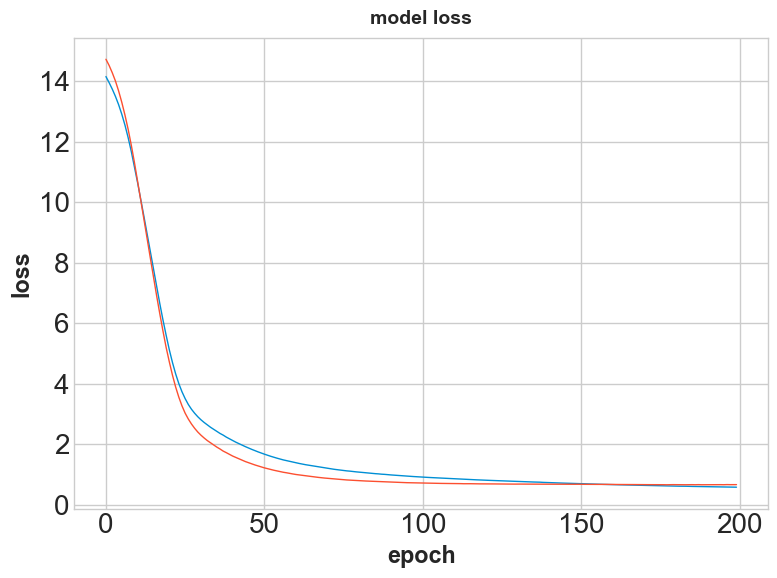

<Figure size 900x600 with 0 Axes>

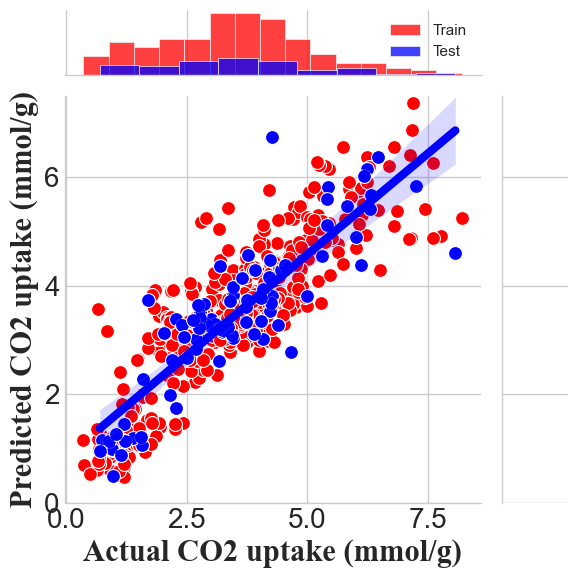

In [165]:
deep_train1(df_0,4,0.15,.00015,16)

## MLP deep models

In [166]:

def mlp1(data,size,lr,batch):
    x = data.drop("CO2 uptake (mmol/g)",axis=1)
    y = data["CO2 uptake (mmol/g)"]

    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)


    scalers = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]

    scaler_Min =scalers[4]




    x_train = scaler_Min.fit_transform(x_train)
    x_test = scaler_Min.fit_transform(x_test)

    print('shape of train set is:      ',x_train.shape)
    print('shape of train label set is:',y_train.shape)
    print()
    print('shape of test set is:      ',x_test.shape)
    print('shape of test label set is:',y_test.shape)


    trainX=x_train
    trainy=y_train

    testX=x_test
    testy=y_test

    # reshape 1d arrays to 2d arrays
    trainy = trainy.values.reshape(len(trainy),1)
    testy = testy.values.reshape(len(testy),1 )
    # created scaler
    scaler = StandardScaler()
    # fit scaler on training dataset
    scaler.fit(trainy)
    # transform training dataset
    trainy = scaler.transform(trainy)
    # transform test dataset
    testy = scaler.transform(testy)
    # define model
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model = Sequential()
    model.add(Dense(trainX.shape[1], input_dim=trainX.shape[1], activation='relu'))
    model.add(Dense(trainX.shape[1], input_dim=trainX.shape[1], activation='relu'))
    model.add(Dense(1, activation='linear'))
    # compile model
    model.compile(loss='mean_squared_error', optimizer=optimizer)#SGD(lr=0.01, momentum=0.5))
    # fit model
    history = model.fit(trainX, trainy, validation_data=(testX, testy),batch_size=batch, epochs=100, verbose=1)
    # evaluate the model
    train_mse = model.evaluate(trainX, trainy, verbose=0)
    test_mse = model.evaluate(testX, testy, verbose=0)
    print('Train: %.3f, Test: %.3f' % (train_mse, test_mse))

    train_preds = model.predict(trainX)
    test_preds = model.predict(testX)
    print('R_squared_train= ', R_squared(trainy, train_preds))

    print('R_squared_test= ', R_squared(testy, test_preds))

    # plot loss during training
    plt.title('Loss / Mean Squared Error')
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.legend()
    plt.show()


shape of train set is:       (447, 9)
shape of train label set is: (447,)

shape of test set is:       (80, 9)
shape of test label set is: (80,)
Epoch 1/100
112/112 [==============================] - 1s 4ms/step - loss: 1.6005 - val_loss: 1.5173
Epoch 2/100
112/112 [==============================] - 0s 2ms/step - loss: 1.4358 - val_loss: 1.3755
Epoch 3/100
112/112 [==============================] - 0s 3ms/step - loss: 1.3052 - val_loss: 1.2592
Epoch 4/100
112/112 [==============================] - 0s 2ms/step - loss: 1.2003 - val_loss: 1.1647
Epoch 5/100
112/112 [==============================] - 0s 3ms/step - loss: 1.1142 - val_loss: 1.0907
Epoch 6/100
112/112 [==============================] - 0s 4ms/step - loss: 1.0429 - val_loss: 1.0235
Epoch 7/100
112/112 [==============================] - 0s 3ms/step - loss: 0.9819 - val_loss: 0.9708
Epoch 8/100
112/112 [==============================] - 0s 2ms/step - loss: 0.9308 - val_loss: 0.9234
Epoch 9/100
112/112 [==========================

Epoch 80/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2883 - val_loss: 0.3009
Epoch 81/100
112/112 [==============================] - 0s 3ms/step - loss: 0.2872 - val_loss: 0.2995
Epoch 82/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2857 - val_loss: 0.2992
Epoch 83/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2847 - val_loss: 0.2992
Epoch 84/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2834 - val_loss: 0.2972
Epoch 85/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2823 - val_loss: 0.2967
Epoch 86/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2813 - val_loss: 0.2960
Epoch 87/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2804 - val_loss: 0.2958
Epoch 88/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2792 - val_loss: 0.2946
Epoch 89/100
112/112 [==============================] - 0s 2ms/step - loss: 0.2782

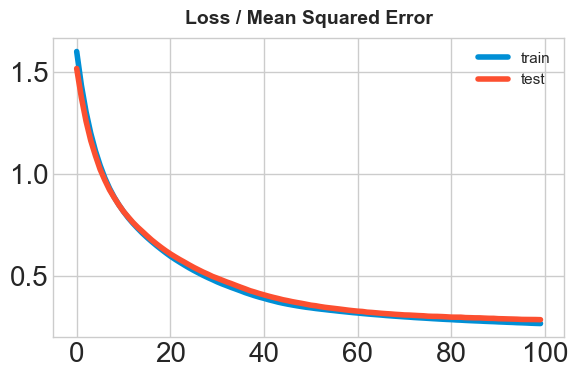

In [167]:
mlp1(df_0,.15,0.0001,4)

## LSTM models

In [168]:
def conv_lstm(data,size,lr,batch,epoch):
    ''' convolutiona_lstm'''


    x = data.drop("CO2 uptake (mmol/g)",axis=1)
    y = data["CO2 uptake (mmol/g)"]

    x = (x-x.min())/(x.max()-x.min())
        # Label (Output)

    y = (y-y.min())/(y.max()-y.min())


    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=size, random_state=42)

   
    x_train.shape[1]

    feature_length = x_train.shape[1]

    label_length = 1


    print(x_train.shape)
    print(y_train.shape)


    from tensorflow.keras.layers import Input, Reshape, LSTM, Dense, TimeDistributed

    
    model = tf.keras.models.Sequential([
        tf.keras.layers.Conv1D(filters=x_train.shape[1],
                               kernel_size=5,
                               padding="same",
                               activation="relu",
                               input_shape=(x_train.shape[1],1)),
         tf.keras.layers.MaxPooling1D(pool_size=1),
        tf.keras.layers.Conv1D(filters=x_train.shape[1],
                               kernel_size=5,
                               padding="same",
                               activation="relu"),
        tf.keras.layers.MaxPooling1D(pool_size=1),
        tf.keras.layers.LSTM(x_train.shape[1], return_sequences=True),
        tf.keras.layers.LSTM(x_train.shape[1], return_sequences=False),
        tf.keras.layers.Dense(1),
    ])
    optimizer1 = keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss=tf.keras.losses.MeanSquaredError(),
                  optimizer=optimizer1,
                  metrics=['mae'])
    model.summary()


    hist = model.fit(x_train, y_train,validation_data=(x_test,y_test), batch_size=batch, epochs=epoch)

    #resuilts model
    test_preds = model.predict(x_test)
    train_preds = model.predict(x_train)

    train_preds=train_preds.reshape(train_preds.shape[0],)
    test_preds=test_preds.reshape(test_preds.shape[0],)

    print( y_train.shape)

    print( y_test.shape)
    print( test_preds.shape)


    print( test_preds.shape)


    test_preds=np.squeeze(np.asarray(test_preds))
    train_preds=np.squeeze(np.asarray(train_preds))

    print("Train MSE : {:.4f}".format(mean_squared_error(y_train, train_preds)))
    print("Test  MSE : {:.4f}".format(mean_squared_error(y_test, test_preds)))
    train_score=R_squared(y_train, train_preds)
    test_score=R_squared(y_test, test_preds)

    print("R-score-train : {:.4f}".format(R_squared(y_train, train_preds)))
    print("R-score-test : {:.4f}".format(R_squared(y_test, test_preds)))
    
    plt.plot(figsize=(6,4),dpi=100)
    plt.plot(hist.history["loss"], label="Training Loss")
    plt.plot(hist.history["val_loss"], label="Validation Loss")
    plt.legend()


(447, 9)
(447,)
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 9, 9)              54        
                                                                 
 max_pooling1d (MaxPooling1D  (None, 9, 9)             0         
 )                                                               
                                                                 
 conv1d_3 (Conv1D)           (None, 9, 9)              414       
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 9, 9)             0         
 1D)                                                             
                                                                 
 lstm (LSTM)                 (None, 9, 9)              684       
                                                                 
 lstm_1 (LSTM)               (None, 9)

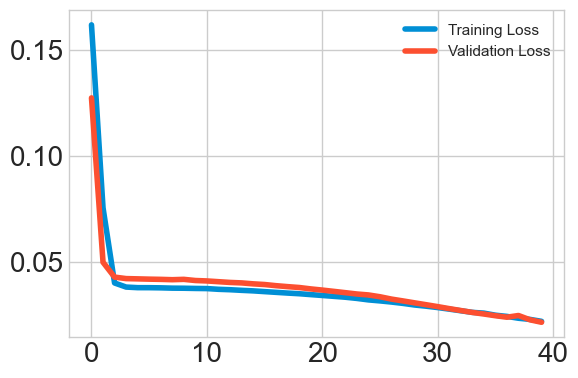

In [169]:
conv_lstm(df_0,.15,.0001,4,40)

In [170]:
def plot_history(hist):

  train_loss = hist.history['loss']
  val_loss = hist.history['val_loss']

  train_acc = hist.history['mae']
  val_acc = hist.history['val_mae']

  plt.figure()

  plt.plot
  plt.plot(np.arange(1,len(train_loss)+1), train_loss)
  plt.plot(np.arange(1,len(train_loss)+1), val_loss)
  plt.legend(['train','validation'])
  plt.grid()
  plt.xlabel('epoch')
  plt.ylabel('loss')
    
  plt.figure()

  plt.plot
  plt.plot(np.arange(1,len(train_acc)+1), train_acc)
  plt.plot(np.arange(1,len(val_acc)+1), val_acc)
  plt.legend(['train','validation'])
  plt.grid()
  plt.xlabel('epoch')
  plt.ylabel('loss')  
    


## Convolutional deep models

In [171]:
def deep_conv12(dataset,size,lr,batch):
    

    xx = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    x = xx.to_numpy()
    print(type(x))
    scaler_Min =StandardScaler()#MinMaxScaler()
    x = scaler_Min.fit_transform(xx)

    print(x.shape)

    x = x.reshape(x.shape[0], x.shape[1], 1)
    print(x.shape)

    xtrain, xtest, ytrain, ytest=train_test_split(x, y, test_size=size, random_state=42)
    optimizer = keras.optimizers.Adam(learning_rate=lr)

    model = Sequential()
    model.add(Conv1D(x.shape[1], 1, activation="relu", input_shape=(x.shape[1],1)))
    model.add(Flatten())
    model.add(Dense(x.shape[1], activation="relu"))
    model.add(Dense(1))
    model.compile(loss="mse", optimizer=optimizer)#"adam")
    model.summary()
    history=model.fit(xtrain, ytrain, batch_size=batch,epochs=120, verbose=0, validation_split=size)

    ypred = model.predict(xtest)
    print(model.evaluate(xtrain, ytrain))
    print("MSE: %.4f" % mean_squared_error(ytest, ypred))
    score=r2_score(ytest, ypred)
    print("r2: %.4f" % r2_score(ytest, ypred))

    print(history.history.keys())
    # "Loss"
    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'val_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()
    
    plt.figure(figsize=(8,6),dpi=100);

    x_ax = range(len(ypred))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="original")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()
    return score

<class 'numpy.ndarray'>
(527, 9)
(527, 9, 1)
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 9, 9)              18        
                                                                 
 flatten_2 (Flatten)         (None, 81)                0         
                                                                 
 dense_19 (Dense)            (None, 9)                 738       
                                                                 
 dense_20 (Dense)            (None, 1)                 10        
                                                                 
Total params: 766
Trainable params: 766
Non-trainable params: 0
_________________________________________________________________
14/14 [==============================] - 0s 2ms/step - loss: 0.6048
0.6047928333282471
MSE: 0.6797
r2: 0.7438
dict_keys(['loss', 'val_loss'])


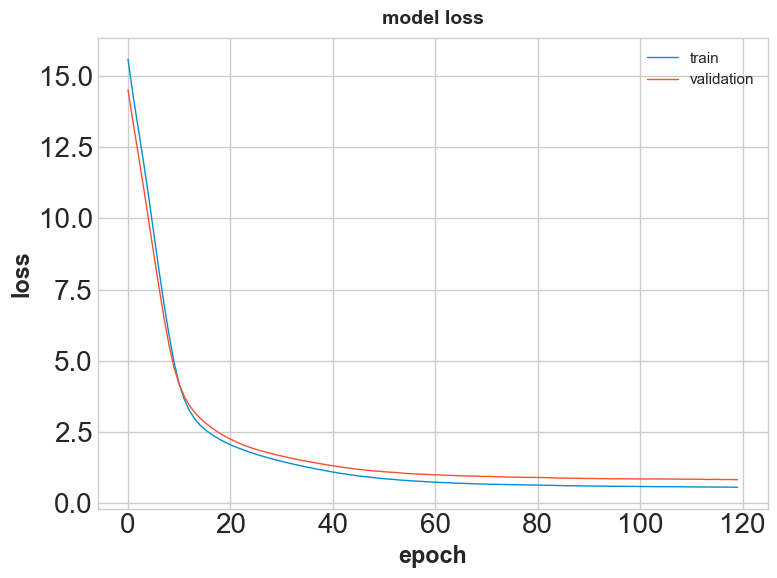

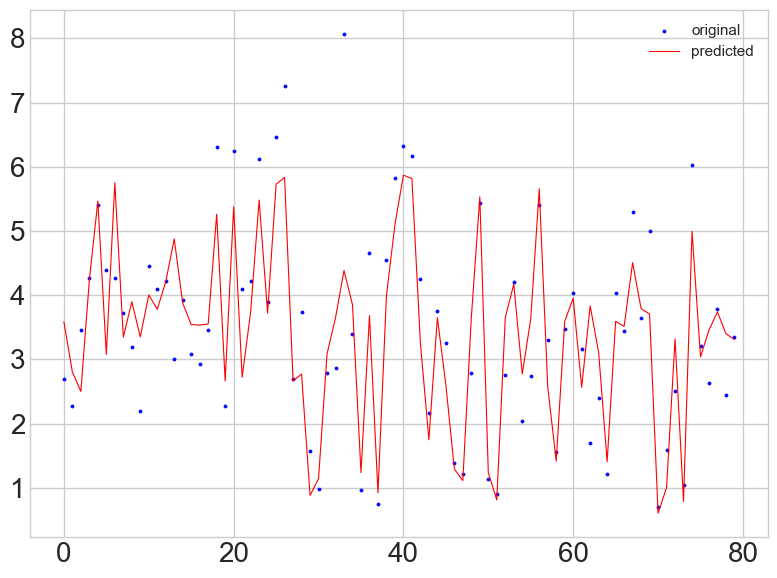

0.7437593246170688

In [172]:
deep_conv12(df_0,.15,.0001,4)

<class 'numpy.ndarray'>
(527, 9)
(527, 9, 1)
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_5 (Conv1D)           (None, 9, 9)              18        
                                                                 
 flatten_3 (Flatten)         (None, 81)                0         
                                                                 
 dense_21 (Dense)            (None, 9)                 738       
                                                                 
 dense_22 (Dense)            (None, 1)                 10        
                                                                 
Total params: 766
Trainable params: 766
Non-trainable params: 0
_________________________________________________________________
14/14 [==============================] - 0s 1ms/step - loss: 0.5940
0.5940209031105042
MSE: 0.5336
r2: 0.7772
dict_keys(['loss', 'val_loss'])


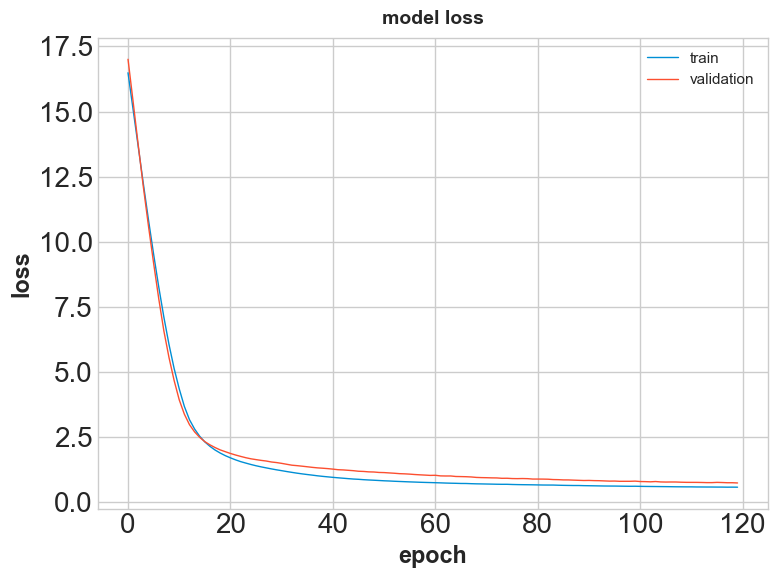

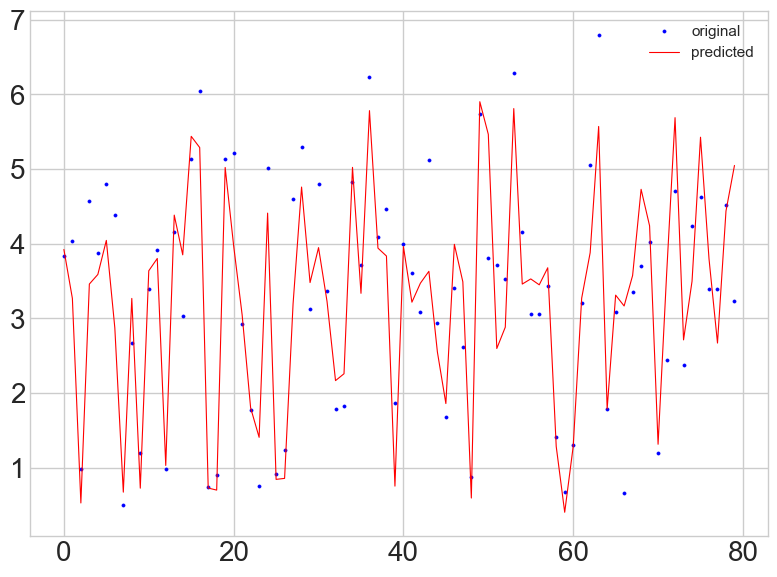

0.7771616203507027

In [173]:
deep_conv12(df_0_shuffled,.15,.0001,4)

In [174]:

def deep_conv2(dataset, test_size, lr, batch_size):
    
    X=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    # Scale the features using StandardScaler
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    y_scaled = (y - y.mean()) / y.std()


    # Reshape the features into a 3D tensor for Conv1D layer
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_scaled, test_size=test_size, random_state=42)

    # Create the neural network model
    model = Sequential()
    model.add(Conv1D(X_reshaped.shape[1], 1, activation="relu", input_shape=(X_reshaped.shape[1], 1)))
    model.add(Flatten())
    model.add(Dense(X_reshaped.shape[1], activation="relu"))
    model.add(Dense(1))
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss="mse", optimizer=optimizer)

    # Fit the model to the training data
    history = model.fit(X_train, y_train, batch_size=batch_size, epochs=120, verbose=0, validation_split=test_size)

    #history = model.fit(xtrain, ytrain, batch_size=batch, epochs=120, verbose=0, validation_split=size)
    xtest=X_test
    ytest=y_test
    xtrain=X_train
    ytrain=y_train
    ypred = model.predict(xtest)
    print("MSE_test: %.4f" % mean_squared_error(ytest, ypred))
    score = r2_score(ytest, ypred)
    print("r2_test: %.4f" % score)

    ypredtr = model.predict(xtrain)
    print("MSE_train: %.4f" % mean_squared_error(ytrain, ypredtr))
    scoretr = r2_score(ytrain, ypredtr)
    print("r2_train: %.4f" % scoretr)

    
    ytest =np.array(ytest)
    ypred = np.array(ypred)
    std = np.std(ytest - ypred)
    print("Standard deviation of predictions on test set: %.4f" % std)

    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'val_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()
    
    plt.figure(figsize=(8,6),dpi=100);

    x_ax = range(len(ypred))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="original")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    return score, scoretr, std

2/2 [==============================] - 0s 3ms/step
MSE_test: 0.3056
r2_test: 0.7458
15/15 [==============================] - 0s 1ms/step
MSE_train: 0.2061
r2_train: 0.7880
Standard deviation of predictions on test set: 1.4185


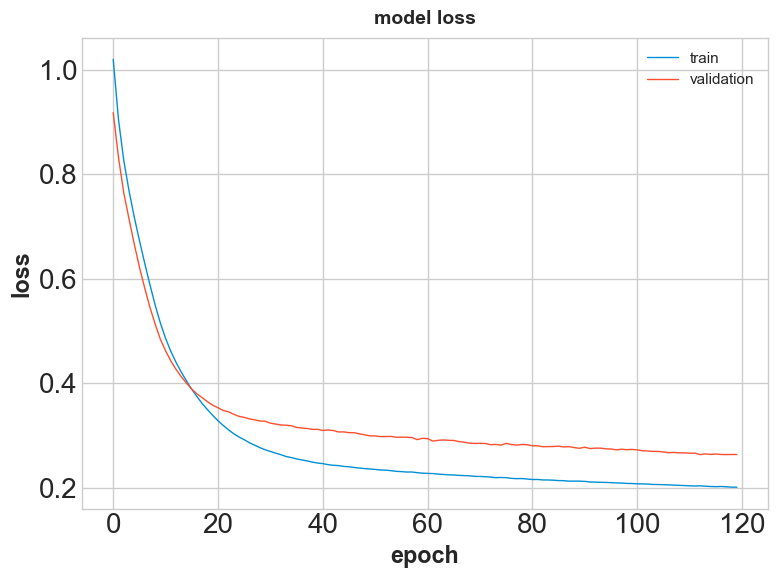

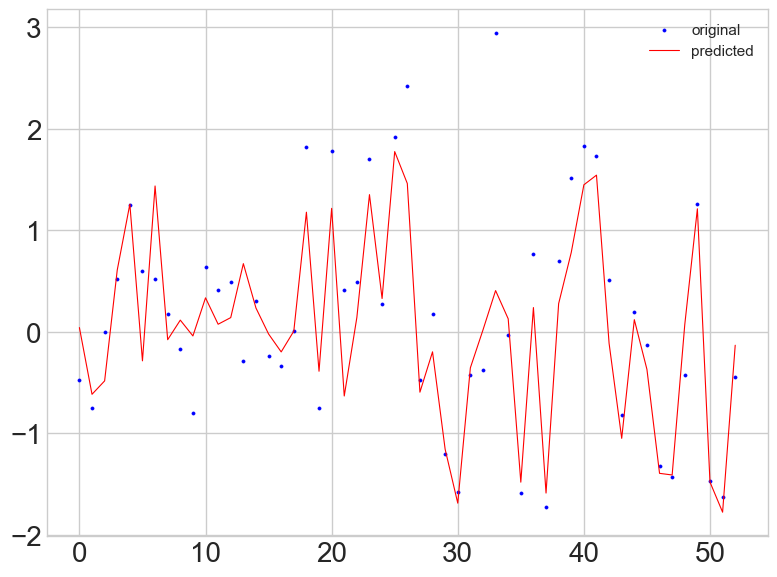

(0.745783953705948, 0.7880144201256538, 1.4185388306791675)

In [175]:
deep_conv2(df_0,.1,0.0001,4)

3/3 [==============================] - 0s 2ms/step
MSE_test: 0.2847
r2_test: 0.7362
14/14 [==============================] - 0s 1ms/step
MSE_train: 0.2293
r2_train: 0.7669
Standard deviation of predictions on test set: 1.3675


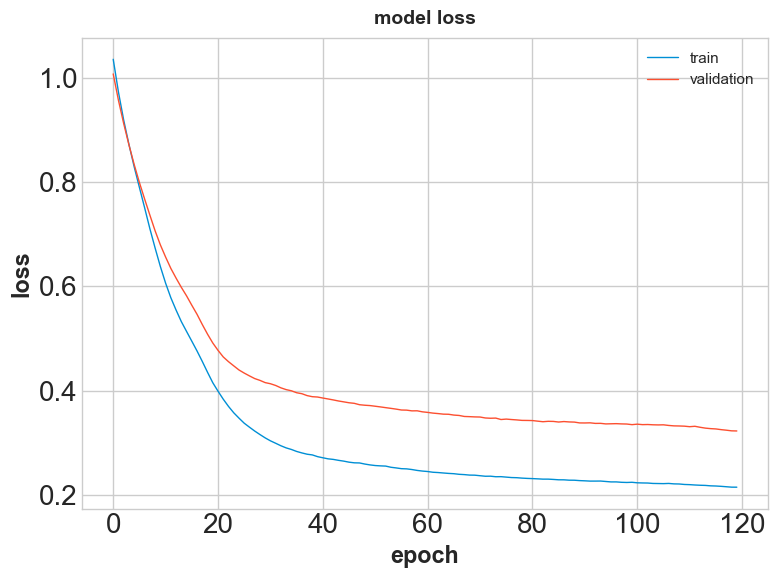

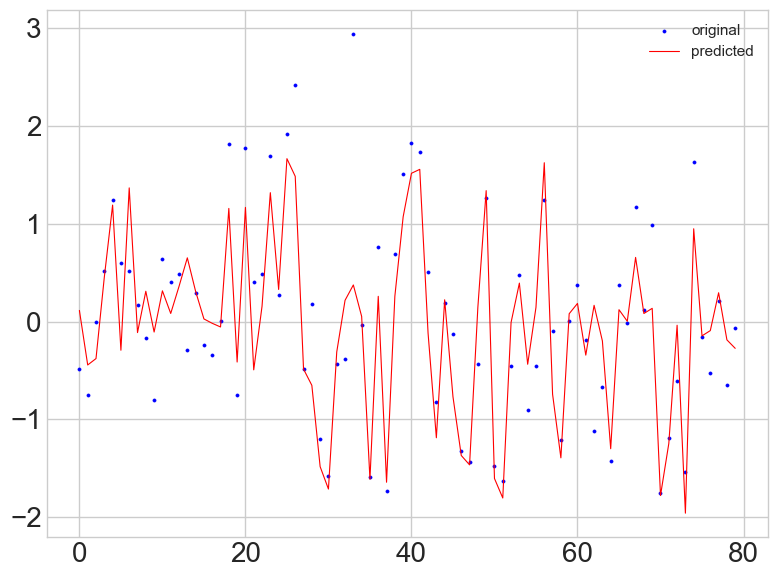

(0.7362092223924601, 0.7668581160351392, 1.3675318733444504)

In [176]:
deep_conv2(df_0,.15,0.0001,4)

3/3 [==============================] - 0s 3ms/step
MSE_test: 0.2309
r2_test: 0.7629
14/14 [==============================] - 0s 2ms/step
MSE_train: 0.2292
r2_train: 0.7710
Standard deviation of predictions on test set: 1.3491


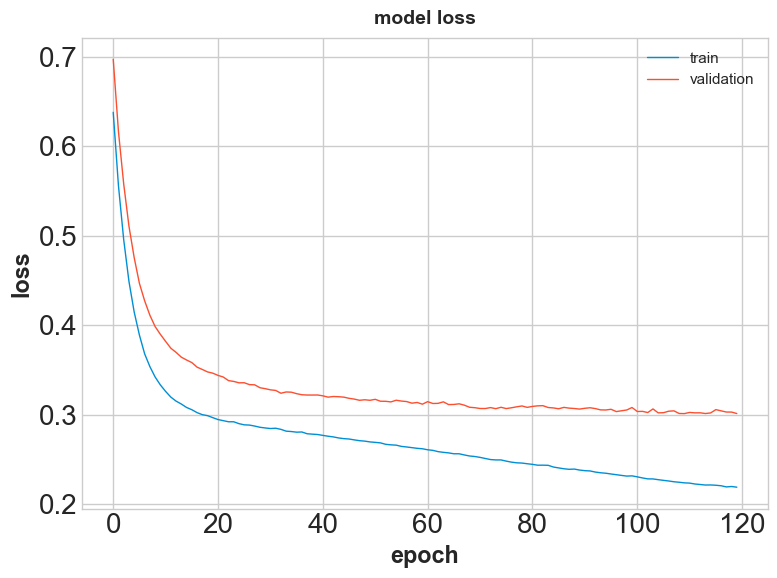

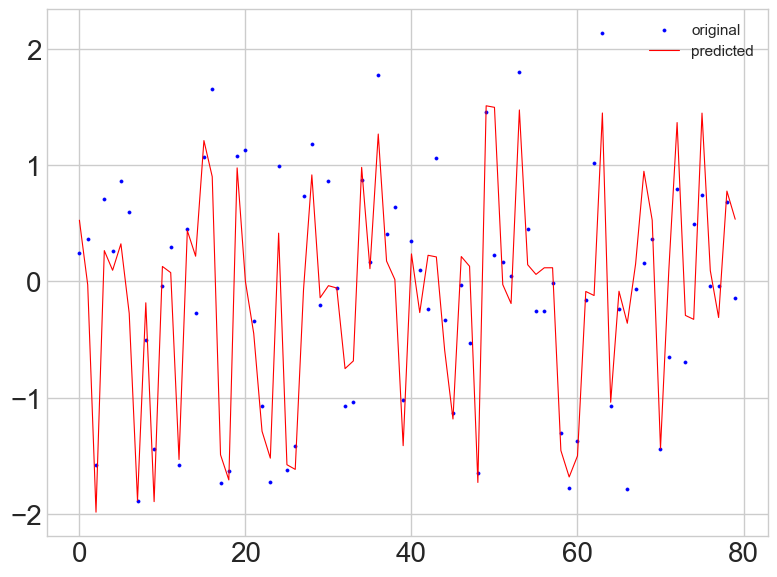

(0.7629476861402048, 0.7710079990153951, 1.349148297411799)

In [177]:
deep_conv2(df_0_shuffled,.15,0.0001,4)

In [178]:
def deep_conv22(dataset,i,j,k):
    

    xx = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    x = xx.to_numpy()
    print(type(x))
    scaler_Min =StandardScaler()#MinMaxScaler()
    x = scaler_Min.fit_transform(xx)

    print(x.shape)

    x = x.reshape(x.shape[0], x.shape[1], 1)
    print(x.shape)

    xtrain, xtest, ytrain, ytest=train_test_split(x, y, test_size=i, random_state=42)
    optimizer = keras.optimizers.Adam(learning_rate=j)

    model = Sequential()
    model.add(Conv1D(x.shape[1], 1, activation="relu", input_shape=(x.shape[1],1)))
    model.add(Flatten())
    model.add(Dense(x.shape[1], activation="relu"))
    model.add(Flatten())
    model.add(Dense(x.shape[1], activation="relu"))
    model.add(Dense(1))
    model.compile(loss="mse", optimizer=optimizer)#"adam")
    model.summary()
    history=model.fit(xtrain, ytrain, batch_size=k,epochs=120, verbose=0, validation_split=i)

    ypred = model.predict(xtest)
    print(model.evaluate(xtrain, ytrain))
    print("MSE: %.4f" % mean_squared_error(ytest, ypred))
    score=r2_score(ytest, ypred)
    print("r2: %.4f" % r2_score(ytest, ypred))

    print(history.history.keys())
    # "Loss"
    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'val_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()
    
    plt.figure(figsize=(8,6),dpi=100);

    x_ax = range(len(ypred))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="original")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()
    return score

<class 'numpy.ndarray'>
(526, 45)
(526, 45, 1)
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_9 (Conv1D)           (None, 45, 45)            90        
                                                                 
 flatten_7 (Flatten)         (None, 2025)              0         
                                                                 
 dense_29 (Dense)            (None, 45)                91170     
                                                                 
 flatten_8 (Flatten)         (None, 45)                0         
                                                                 
 dense_30 (Dense)            (None, 45)                2070      
                                                                 
 dense_31 (Dense)            (None, 1)                 46        
                                                                 
Total 

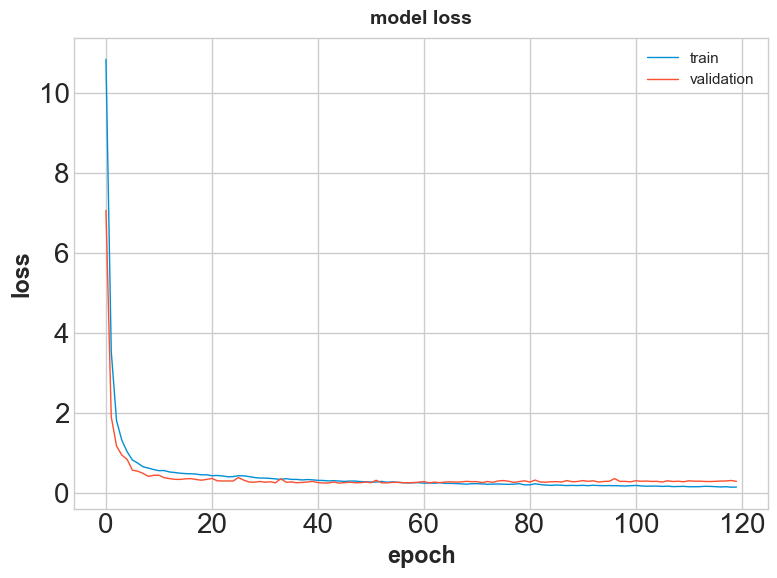

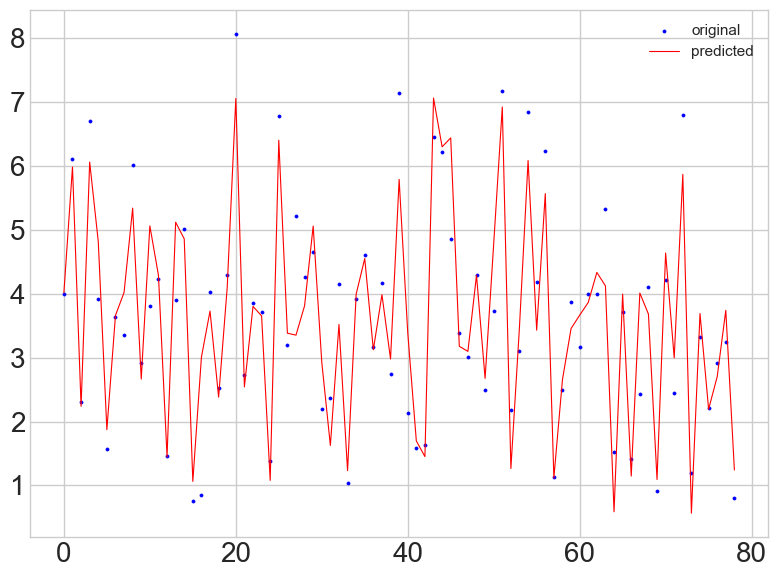

0.850706143557552

In [179]:
deep_conv22(dss_shuffled,.15,0.0001,4)

<class 'numpy.ndarray'>
(526, 45)
(526, 45, 1)
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_10 (Conv1D)          (None, 45, 45)            90        
                                                                 
 flatten_9 (Flatten)         (None, 2025)              0         
                                                                 
 dense_32 (Dense)            (None, 45)                91170     
                                                                 
 flatten_10 (Flatten)        (None, 45)                0         
                                                                 
 dense_33 (Dense)            (None, 45)                2070      
                                                                 
 dense_34 (Dense)            (None, 1)                 46        
                                                                 
Total 

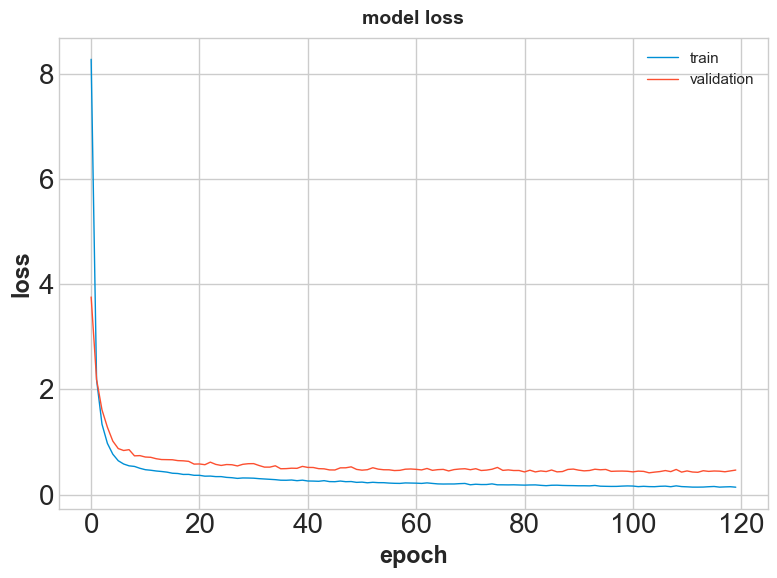

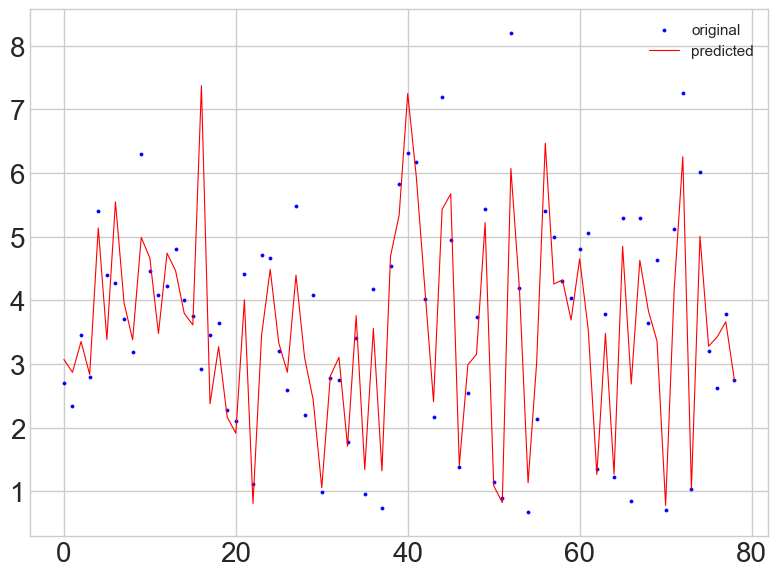

0.7424233727659961

In [180]:
deep_conv22(dss,.15,0.0001,4)

In [181]:
def deep_conv23(dataset, test_size, lr, batch_size):
    X = dataset.drop("CO2 uptake (mmol/g)", axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)
    y_scaler = StandardScaler()
    y_scaled = y_scaler.fit_transform(y.values.reshape(-1, 1)).flatten()

    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_scaled, test_size=test_size, random_state=42)

    optimizer = Adam(learning_rate=lr)

    model = Sequential()
    model.add(Conv1D(X_reshaped.shape[1], 1, activation="relu", input_shape=(X_reshaped.shape[1], 1)))
    model.add(Flatten())
    model.add(Dense(X_reshaped.shape[1], activation="relu"))
    model.add(Dense(1))
    model.compile(loss="mse", optimizer=optimizer)
    model.summary()

    history = model.fit(X_train, y_train, batch_size=batch_size, epochs=120, verbose=0, validation_split=test_size)

    ypred = model.predict(X_test)
    mse_test = mean_squared_error(y_test, ypred)
    r2_test = r2_score(y_test, ypred)
    print("MSE_test: %.4f" % mse_test)
    print("r2_test: %.4f" % r2_test)

    plt.figure(figsize=(8, 6), dpi=100)
    plt.plot(history.history['loss'], label='train_loss', linewidth=1)
    plt.plot(history.history['val_loss'], label='val_loss', linewidth=1)
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    plt.show()

    plt.figure(figsize=(8, 6), dpi=100)
    x_ax = range(len(ypred))
    plt.scatter(x_ax, y_test, s=5, color="blue", label="original")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    return r2_test



Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_11 (Conv1D)          (None, 45, 45)            90        
                                                                 
 flatten_11 (Flatten)        (None, 2025)              0         
                                                                 
 dense_35 (Dense)            (None, 45)                91170     
                                                                 
 dense_36 (Dense)            (None, 1)                 46        
                                                                 
Total params: 91,306
Trainable params: 91,306
Non-trainable params: 0
_________________________________________________________________
3/3 [==============================] - 0s 3ms/step
MSE_test: 0.2228
r2_test: 0.8175


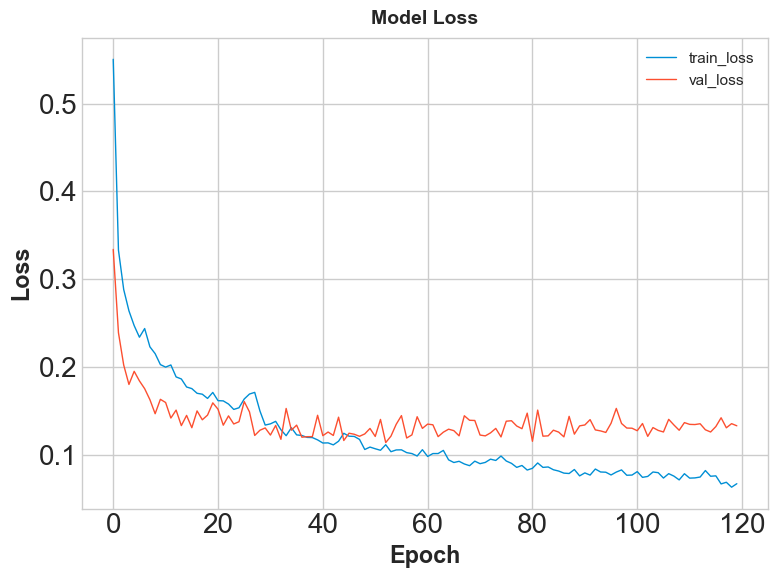

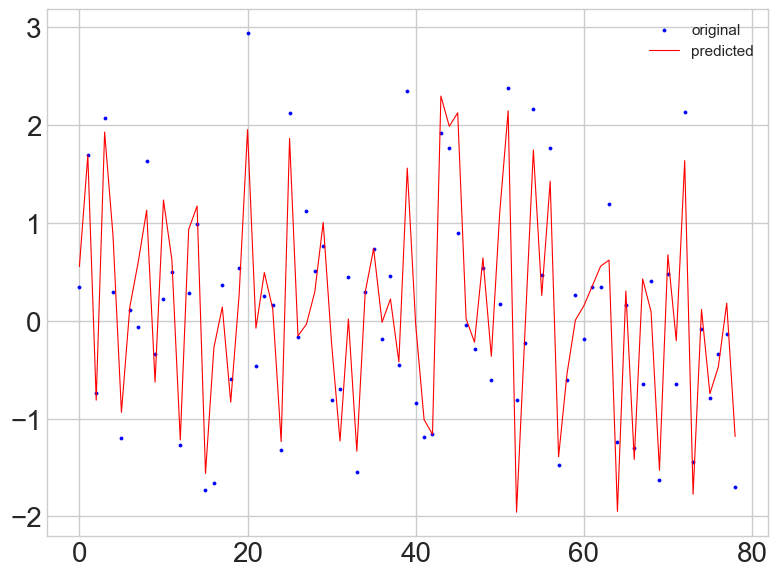

0.8175200520198128

In [182]:
deep_conv23(dss_shuffled,.15,0.0001,4)

In [183]:

def deep_conv24(dataset, test_size, lr, batch_size):
    
    X=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    # Scale the features using StandardScaler
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    y_scaled = (y - y.mean()) / y.std()


    # Reshape the features into a 3D tensor for Conv1D layer
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_scaled, test_size=test_size, random_state=42)

    # Create the neural network model
    model = Sequential()
    model.add(Conv1D(X_reshaped.shape[1], 1, activation="relu", input_shape=(X_reshaped.shape[1], 1)))
    model.add(Flatten())
    model.add(Dense(X_reshaped.shape[1], activation="relu"))
    model.add(Dense(1))
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss="mse", optimizer=optimizer)

    # Fit the model to the training data
    history = model.fit(X_train, y_train, batch_size=batch_size, epochs=120, verbose=0, validation_split=test_size)

    #history = model.fit(xtrain, ytrain, batch_size=batch, epochs=120, verbose=0, validation_split=size)
    xtest=X_test
    ytest=y_test
    xtrain=X_train
    ytrain=y_train
    ypred = model.predict(xtest)
    print("MSE_test: %.4f" % mean_squared_error(ytest, ypred))
    score = r2_score(ytest, ypred)
    print("r2_test: %.4f" % score)

    ypredtr = model.predict(xtrain)
    print("MSE_train: %.4f" % mean_squared_error(ytrain, ypredtr))
    scoretr = r2_score(ytrain, ypredtr)
    print("r2_train: %.4f" % scoretr)

    
    ytest =np.array(ytest)
    ypred = np.array(ypred)
    std = np.std(ytest - ypred)
    print("Standard deviation of predictions on test set: %.4f" % std)

    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'val_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()
    
    plt.figure(figsize=(8,6),dpi=100);

    x_ax = range(len(ypred))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="original")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    return score, scoretr, std

3/3 [==============================] - 0s 4ms/step
MSE_test: 0.1884
r2_test: 0.8454
14/14 [==============================] - 0s 2ms/step
MSE_train: 0.0692
r2_train: 0.9277
Standard deviation of predictions on test set: 1.4815


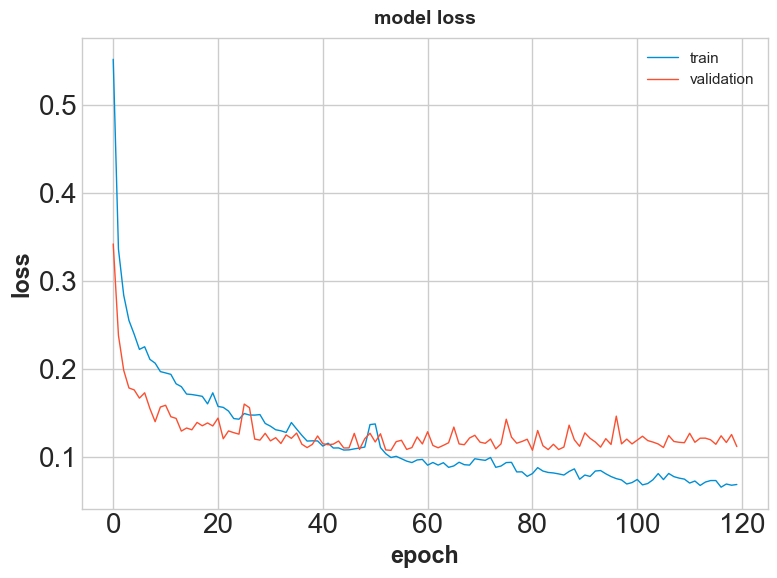

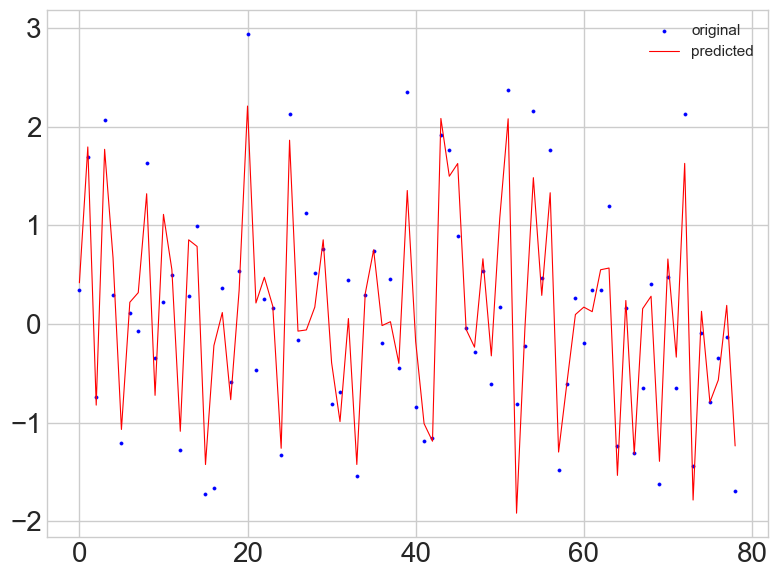

(0.8453848645493713, 0.9276522758386428, 1.4814701010655285)

In [184]:
deep_conv24(dss_shuffled,.15,0.0001,4)

3/3 [==============================] - 0s 3ms/step
MSE_test: 0.1336
r2_test: 0.8709
14/14 [==============================] - 0s 2ms/step
MSE_train: 0.1144
r2_train: 0.8844
Standard deviation of predictions on test set: 1.4187


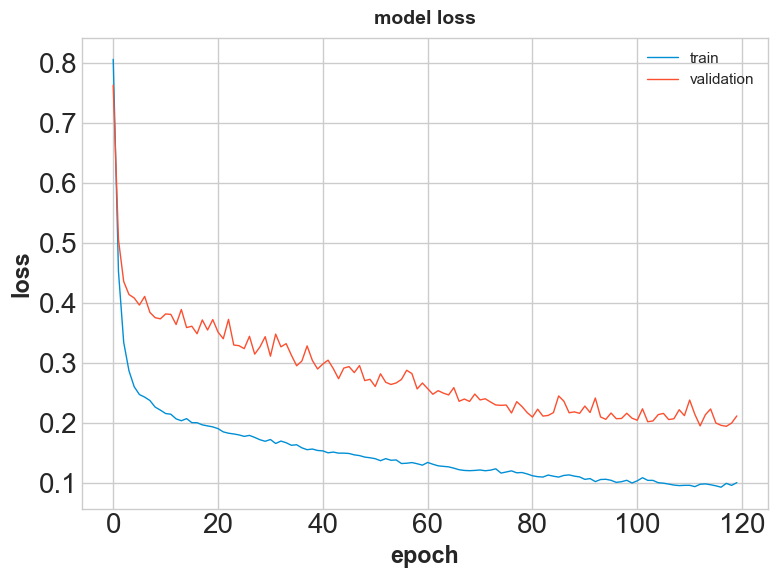

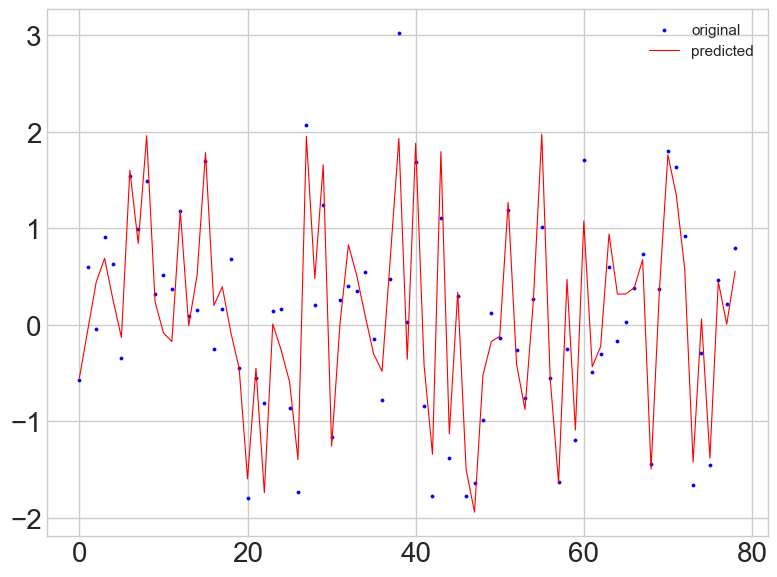

(0.8709392333957058, 0.8843782182507548, 1.418677358554879)

In [185]:
deep_conv2(dss0_shuffled,.15,0.0001,4)

In [186]:
def deep_conv2_oplot(dataset, test_size, lr, batch_size):
    
    X=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    # Scale the features using StandardScaler
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    y_scaled = (y - y.mean()) / y.std()


    # Reshape the features into a 3D tensor for Conv1D layer
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_scaled, test_size=test_size, random_state=42)

    # Create the neural network model
    model = Sequential()
    model.add(Conv1D(X_reshaped.shape[1], 1, activation="relu", input_shape=(X_reshaped.shape[1], 1)))
    model.add(Flatten())
    model.add(Dense(X_reshaped.shape[1], activation="relu"))
    model.add(Dense(1))
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss="mse", optimizer=optimizer)

    # Fit the model to the training data
    history = model.fit(X_train, y_train, batch_size=batch_size, epochs=120, verbose=0, validation_split=test_size)

    ypred = model.predict(X_test)
    ypred = np.squeeze(ypred)  # Remove unnecessary dimension
    ypred_rescaled = ypred * y.std() + y.mean()  # Rescale predictions
    ytest_rescaled = y_test * y.std() + y.mean() # Rescale original target values
    
    print("MSE_test: %.4f" % mean_squared_error(ytest_rescaled, ypred_rescaled))
    score = r2_score(ytest_rescaled, ypred_rescaled)
    print("r2_test: %.4f" % score)

    ypredtr = model.predict(X_train)
    ypredtr = np.squeeze(ypredtr)  # Remove unnecessary dimension
    ypredtr_rescaled = ypredtr * y.std() + y.mean() # Rescale predictions
    ytrain_rescaled = y_train * y.std() + y.mean() # Rescale original target values
    
    print("MSE_train: %.4f" % mean_squared_error(ytrain_rescaled, ypredtr_rescaled))
    scoretr = r2_score(ytrain_rescaled, ypredtr_rescaled)
    print("r2_train: %.4f" % scoretr)
    
    std = np.std(ytest_rescaled - ypred_rescaled)
    print("Standard deviation of predictions on test set: %.4f" % std)

    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'train_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()

    plt.figure(figsize=(8,6),dpi=100);

    x_ax = range(len(ypred_rescaled))
    plt.scatter(x_ax, ytest_rescaled, s=5, color="blue", label="original")
    plt.scatter(x_ax, ypred_rescaled, s=5, color="red", label="predicted")

    #plt.plot(x_ax, ypred_rescaled, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    return score, scoretr, std



3/3 [==============================] - 0s 3ms/step
MSE_test: 0.4128
r2_test: 0.8380
14/14 [==============================] - 0s 1ms/step
MSE_train: 0.3019
r2_train: 0.8761
Standard deviation of predictions on test set: 0.6385


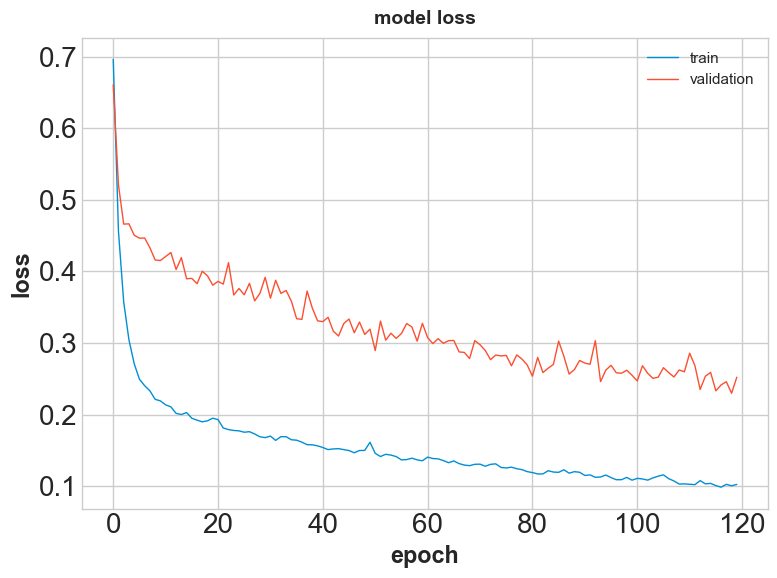

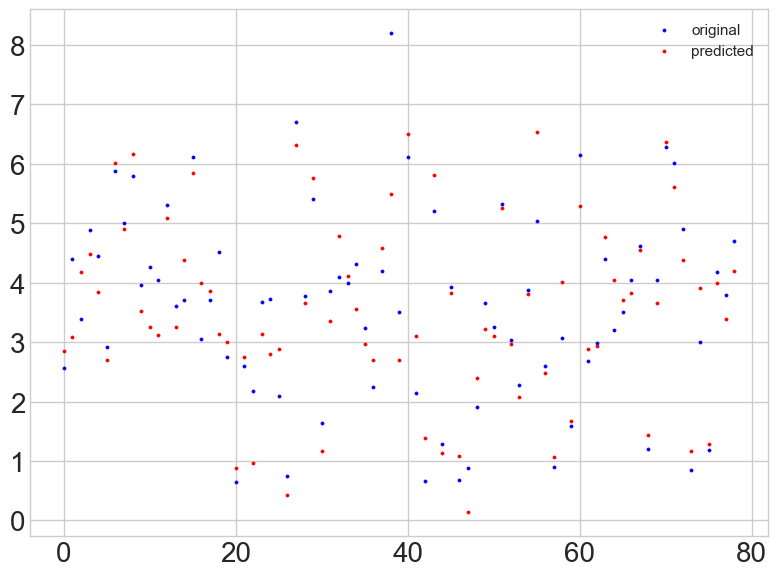

(0.8380262587679725, 0.876113483268286, 0.6384871057362328)

In [187]:
deep_conv2_oplot(dss0_shuffled,.15,0.0001,4)

In [188]:
def deep_conv2_oplot_mse(dataset, test_size, lr, batch_size):
    
    X=dataset.drop(['CO2 uptake (mmol/g)'],axis=1)
    y=dataset['CO2 uptake (mmol/g)']
    # Scale the features using StandardScaler
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    y_scaled = (y - y.mean()) / y.std()


    # Reshape the features into a 3D tensor for Conv1D layer
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_scaled, test_size=test_size, random_state=42)

    # Create the neural network model
    model = Sequential()
    model.add(Conv1D(X_reshaped.shape[1], 1, activation="relu", input_shape=(X_reshaped.shape[1], 1)))
    model.add(Flatten())
    model.add(Dense(X_reshaped.shape[1], activation="relu"))
    model.add(Dense(1))
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss="mse", optimizer=optimizer)

    # Fit the model to the training data
    history = model.fit(X_train, y_train, batch_size=batch_size, epochs=120, verbose=0, validation_split=test_size)

    ypred = model.predict(X_test)
    ypred = np.squeeze(ypred)  # Remove unnecessary dimension
    ypred_rescaled = ypred * y.std() + y.mean()  # Rescale predictions
    ytest_rescaled = y_test * y.std() + y.mean() # Rescale original target values
    
    mse_test = mean_squared_error(ytest_rescaled, ypred_rescaled) # calculate MSE for test set
    print("MSE_test: %.4f" % mse_test)
    score = r2_score(ytest_rescaled, ypred_rescaled)
    print("r2_test: %.4f" % score)

    ypredtr = model.predict(X_train)
    ypredtr = np.squeeze(ypredtr)  # Remove unnecessary dimension
    ypredtr_rescaled = ypredtr * y.std() + y.mean() # Rescale predictions
    ytrain_rescaled = y_train * y.std() + y.mean() # Rescale original target values
    
    print("MSE_train: %.4f" % mean_squared_error(ytrain_rescaled, ypredtr_rescaled))
    scoretr = r2_score(ytrain_rescaled, ypredtr_rescaled)
    print("r2_train: %.4f" % scoretr)
    
    std = np.std(ytest_rescaled - ypred_rescaled)
    print("Standard deviation of predictions on test set: %.4f" % std)

    plt.figure(figsize=(8,6),dpi=100);
    plt.plot(history.history['loss'],label = 'train_loss',linewidth=1);
    plt.plot(history.history['val_loss'],label = 'val_loss',linewidth=1);
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend(['train', 'validation'], loc='upper right');
    plt.show()

    plt.figure(figsize=(8,6),dpi=200)
    x_ax = range(len(ypred_rescaled))
    plt.scatter(x_ax, ytest_rescaled, s=5, color="blue", label="original")
    plt.scatter(x_ax, ypred_rescaled, s=5, color="red", label="predicted")

    # Add text box with MSE value for test set
    plt.text(0.88, 0.85, "MSE_test: %.2f" % mse_test, transform=plt.gca().transAxes, fontsize=10,
            verticalalignment='top')

    plt.legend()
    plt.show()

    return score, scoretr, std



3/3 [==============================] - 0s 3ms/step
MSE_test: 0.3751
r2_test: 0.8528
14/14 [==============================] - 0s 1ms/step
MSE_train: 0.2527
r2_train: 0.8963
Standard deviation of predictions on test set: 0.6123


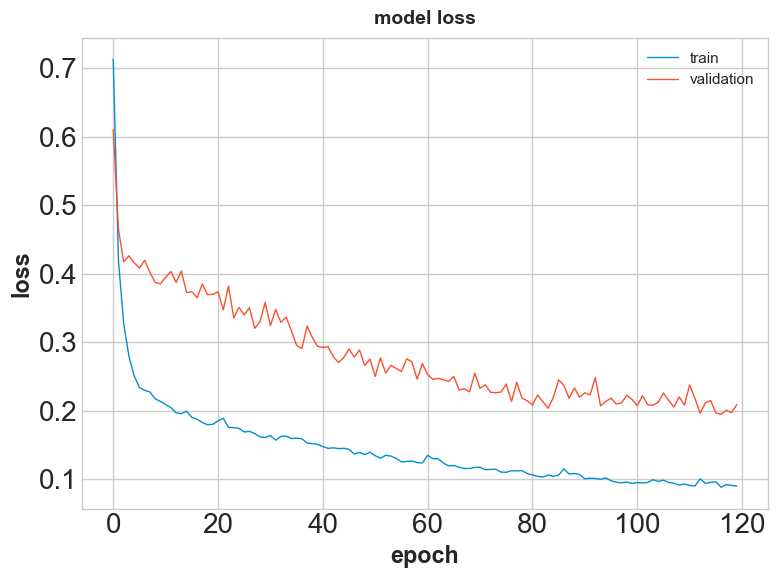

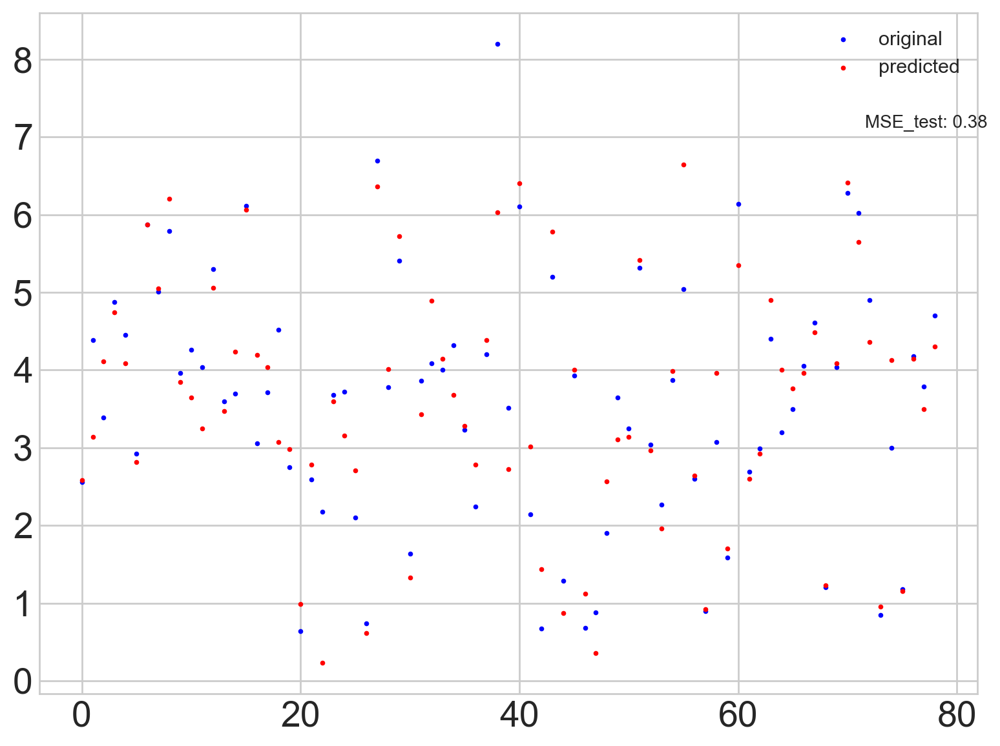

(0.8528323340750354, 0.8962915255074937, 0.6123176497096631)

In [189]:
deep_conv2_oplot_mse(dss0_shuffled,.15,0.0001,4)

In [190]:
from scikeras.wrappers import KerasClassifier, KerasRegressor

In [191]:
def best_par_deep(dataset, size):
    results = {}

    for i in [0.0001, 0.00015, 0.0003, 0.0005]:
        for j in [4, 8, 10, 12, 16]:
            score, scoretr, std = deep_conv2(dataset, size, i, j)

            result_string = "predict output for deep_conv2: learning_rate={}, batch={}".format(i, j)
            mse_string = "The mean squared error (MSE) on test set: {:.4f}".format(score)
            print(result_string)
            print(mse_string)
            print("=" * 50)
            
            results[f'{i}-{j}'] = score

    df_scores_deep = pd.DataFrame(results, index=[0]).copy()

    return df_scores_deep


In [192]:
# df_scores_deep=best_par_deep(dss_shuffled,0.15)

##  fifth deep models 

In [193]:
from keras.layers import Dense, Activation
from keras.models import Sequential
# Importing the dataset


In [194]:
def deep_train3(dataset,n,size,lr,batch):
    
    
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    # Splitting the dataset into the Training set and Test set
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = size, random_state = 0)

    scaler = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    # Feature Scaling
    if n==0:
        X_train=X_train
        X_test=X_test
    else:
            
        sc = scaler[n]#StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

    # Initialising the ANN
    model = Sequential()

    # Adding the input layer and the first hidden layer
    model.add(Dense(X_train.shape[1], activation = 'relu', input_dim = X_train.shape[1]))

    # Adding the second hidden layer
    model.add(Dense(units = X_train.shape[1], activation = 'relu'))

    # Adding the third hidden layer
    model.add(Dense(units = X_train.shape[1], activation = 'relu'))

    # Adding the forth hidden layer
    model.add(Dense(units = X_train.shape[1]//2, activation = 'relu'))
    # Adding the output layer

    model.add(Dense(units = 1))
    model.summary()
    
    optimizer = keras.optimizers.Adam(learning_rate=lr)

    #model.add(Dense(1))
    # Compiling the ANN
    model.compile(optimizer = optimizer, loss = 'mean_squared_error')

    # Fitting the ANN to the Training set
    hist = model.fit(X_train, y_train, epochs = 200,batch_size = batch, verbose=0, validation_split=size)
    print(hist.history.keys())

    y_pred3 = model.predict(X_test)
    y_pred13 = model.predict(X_train)

    
    test_score=r2_score(y_test, y_pred3)
    train_score=r2_score(y_train, y_pred13)
    print(test_score)
    print(train_score)
    
    
    plt.figure(figsize=(8,6),dpi=100);
        
    plt.plot(hist.history['loss'],label = 'loss',linewidth=1);
    plt.plot(hist.history['val_loss'],label = 'val_loss',linewidth=1);
    
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend()
   
    plt.show()
    
    
    y_train=np.array(y_train)
    y_train=y_train.flatten()
    y_pred13=y_pred13.flatten()
    #y_pred13
    plt.figure(dpi=200)
    plt.plot(y_train[:len(X_test)], color = 'red', label = 'Real data_train set',linewidth=1)
    plt.plot(y_pred13[:len(X_test)], color = 'blue', label = 'Predicted data_train set',linewidth=1)
    plt.title('Prediction_train set')
    plt.legend()
    plt.show()


    y_test=np.array(y_test)
    y_test=y_test.flatten()
    y_pred3=y_pred3.flatten()
    #y_pred3
    plt.figure(dpi=200)
    #plt.plot(y_test[:len(X_test)], color = 'red', label = 'Real data_test set',linewidth=1)
    x_ax = range(len(y_pred3))
    plt.scatter(x_ax, y_test, s=5, color="red", label="original")
    #plt.scatter(y_test[:len(X_test)], y_test, s=5, color="blue", label="original")
    plt.plot(y_pred3[:len(X_test)], color = 'blue', label = 'Predicted data_test set',linewidth=1)
    plt.title('Prediction_test set')
    plt.legend()
    plt.show()  
    
    return test_score,train_score,y_pred3,y_pred13,y_train,y_test



In [195]:
# !pip3 install keras-visualizer
# !pip install graphviz


# visualizer(model, format='png', view=True)


In [196]:
def deep_train32(dataset,n,size,lr,batch):
    
    
    x = dataset.drop("CO2 uptake (mmol/g)",axis=1)
    y = dataset["CO2 uptake (mmol/g)"]

    # Splitting the dataset into the Training set and Test set
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = size, random_state = 0)

    scaler = [None, MinMaxScaler(), MaxAbsScaler(), RobustScaler(),StandardScaler(),
               QuantileTransformer(n_quantiles=5, random_state=42, output_distribution='normal')]
    # Feature Scaling
    if n==0:
        X_train=X_train
        X_test=X_test
    else:
            
        sc = scaler[n]
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

    # Initialising the ANN
    model = Sequential()

    # Adding the input layer and the first hidden layer
    model.add(Dense(X_train.shape[1], activation = 'relu', input_dim = X_train.shape[1]))

    # Adding the second hidden layer
    model.add(Dense(units = X_train.shape[1], activation = 'relu'))

#     # Adding the third hidden layer
    model.add(Dense(units = X_train.shape[1], activation = 'relu'))

#     # Adding the forth hidden layer
#     model.add(Dense(units = X_train.shape[1]//2, activation = 'relu'))
#     # Adding the output layer

    model.add(Dense(units = 1))
    model.summary()

    optimizer = keras.optimizers.Adam(learning_rate=lr)

    #model.add(Dense(1))
    # Compiling the ANN
    model.compile(optimizer = optimizer, loss = 'mean_squared_error')

    # Fitting the ANN to the Training set
    hist = model.fit(X_train, y_train, epochs = 200,batch_size = batch, verbose=0, validation_split=size)
    print(hist.history.keys())

    y_pred3 = model.predict(X_test)
    y_pred13 = model.predict(X_train)

    
    test_score=r2_score(y_test, y_pred3)
    train_score=r2_score(y_train, y_pred13)
    print(test_score)
    print(train_score)
    
    
    plt.figure(figsize=(8,6),dpi=100);
        
    plt.plot(hist.history['loss'],label = 'loss',linewidth=1);
    plt.plot(hist.history['val_loss'],label = 'val_losst',linewidth=1);
    
    plt.title('model loss');
    plt.ylabel('loss');
    plt.xlabel('epoch');
    plt.legend()
  
    plt.show()
    
    
    y_train=np.array(y_train)
    y_train=y_train.flatten()
    y_pred13=y_pred13.flatten()
    #y_pred13
    plt.figure(dpi=200)
    plt.plot(y_train[:len(X_test)], color = 'red', label = 'Real data_train set',linewidth=1)
    plt.plot(y_pred13[:len(X_test)], color = 'blue', label = 'Predicted data_train set',linewidth=1)
    plt.title('Prediction_train set')
    plt.legend()
    plt.show()


    y_test=np.array(y_test)
    y_test=y_test.flatten()
    y_pred3=y_pred3.flatten()
    #y_pred3
    plt.figure(dpi=200)
    plt.plot(y_test[:len(X_test)], color = 'red', label = 'Real data_test set',linewidth=1)
    plt.plot(y_pred3[:len(X_test)], color = 'blue', label = 'Predicted data_test set',linewidth=1)
    plt.title('Prediction_test set')
    plt.legend()
    plt.show()  
    
    return test_score,train_score,y_pred3,y_pred13,y_train,y_test



Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_45 (Dense)            (None, 45)                2070      
                                                                 
 dense_46 (Dense)            (None, 45)                2070      
                                                                 
 dense_47 (Dense)            (None, 45)                2070      
                                                                 
 dense_48 (Dense)            (None, 1)                 46        
                                                                 
Total params: 6,256
Trainable params: 6,256
Non-trainable params: 0
_________________________________________________________________
dict_keys(['loss', 'val_loss'])
14/14 [==============================] - 0s 1ms/step
0.789259800586479
0.9227283966207576


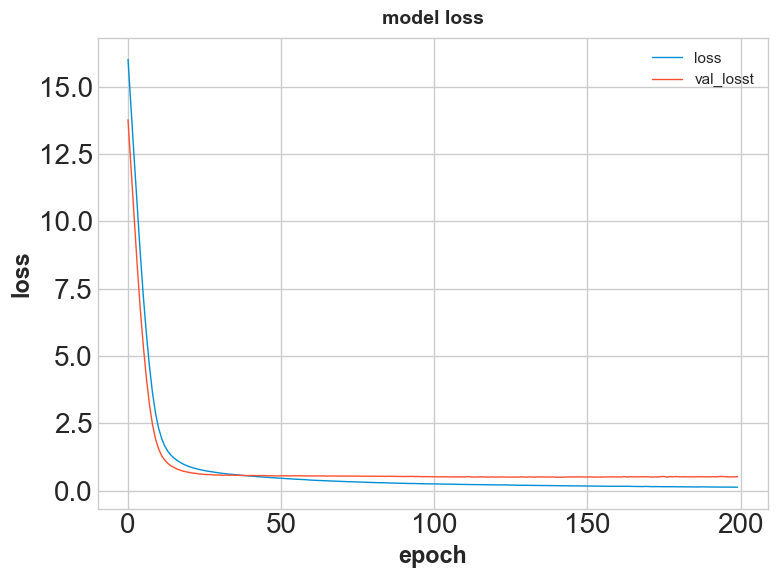

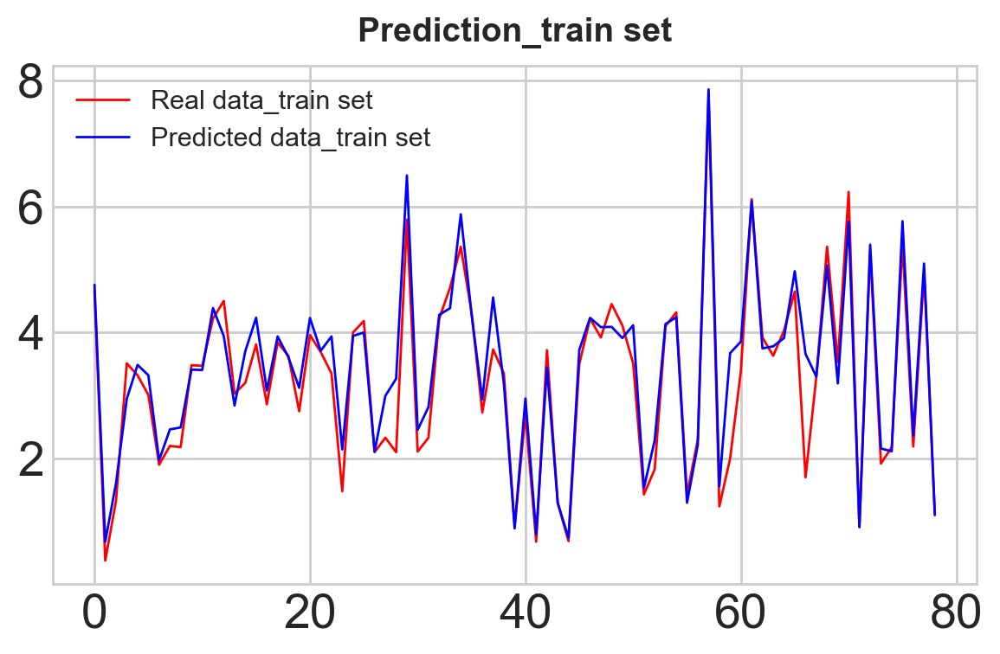

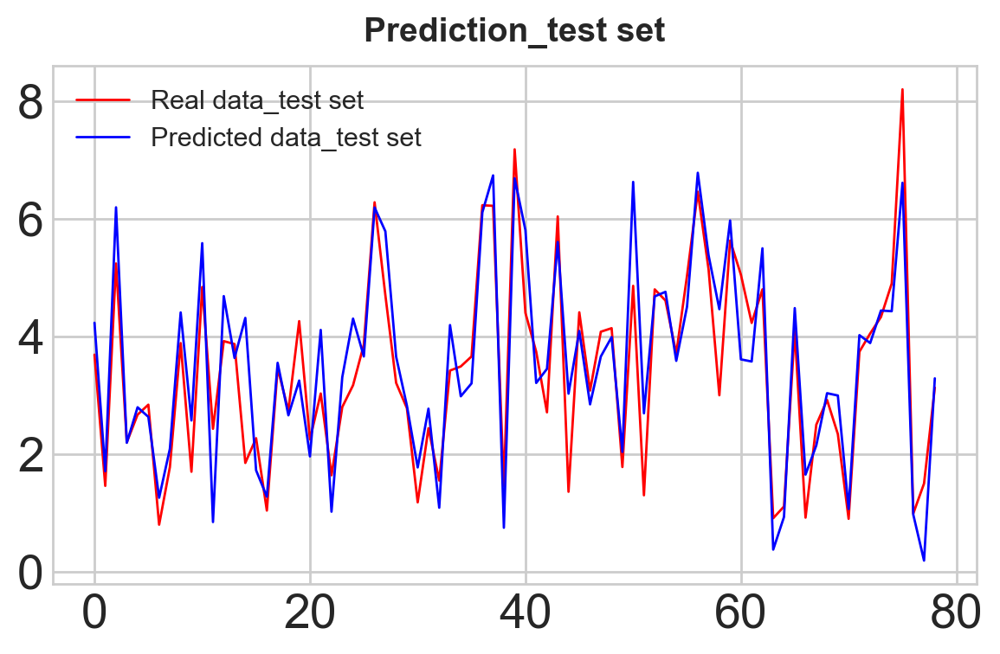

(0.789259800586479,
 0.9227283966207576,
 array([4.232469, 1.708346, 6.194335, 2.192602, 2.79576 , 2.632769,
        1.258208, 2.091532, 4.407692, 2.571662, 5.585243, 0.845354,
        4.685384, 3.633913, 4.314837, 1.725371, 1.275166, 3.551343,
        2.659432, 3.249826, 1.960862, 4.110547, 1.0211  , 3.308028,
        4.302732, 3.659662, 6.191061, 5.786556, 3.65502 , 2.822745,
        1.773288, 2.771942, 1.088779, 4.193347, 2.982691, 3.20252 ,
        6.107022, 6.737055, 0.748401, 6.688113, 5.808125, 3.208973,
        3.44891 , 5.605673, 3.027151, 4.092463, 2.845787, 3.659618,
        3.988319, 2.037547, 6.626401, 2.693008, 4.68068 , 4.758091,
        3.585228, 4.506267, 6.781456, 5.378696, 4.462859, 5.970678,
        3.610204, 3.573858, 5.497858, 0.376497, 0.931327, 4.481396,
        1.651684, 2.148307, 3.035122, 2.995577, 1.067176, 4.021766,
        3.887457, 4.440285, 4.428433, 6.611671, 0.97218 , 0.18963 ,
        3.287491], dtype=float32),
 array([4.75545 , 0.681507, 1.609617, 2.

In [197]:
deep_train32(dss_shuffled,4,.15,0.0001,8)